# Naive Bayes Classifier

In [43]:
import nltk 
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
from nltk.corpus import stopwords
nltk.download('stopwords')
stopwords = set(stopwords.words('english'))
import string
import gensim

[nltk_data] Downloading package stopwords to /home/cnn/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [62]:
from nltk.stem import WordNetLemmatizer
lemmatizer = WordNetLemmatizer()
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /home/cnn/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.


True

In [63]:
print(lemmatizer.lemmatize("cats"))
print(lemmatizer.lemmatize("cacti"))
print(lemmatizer.lemmatize("geese"))
print(lemmatizer.lemmatize("rocks"))
print(lemmatizer.lemmatize("python"))
print(lemmatizer.lemmatize("better", pos="a"))
print(lemmatizer.lemmatize("best", pos="a"))
print(lemmatizer.lemmatize("run"))
print(lemmatizer.lemmatize("run",'v'))

cat
cactus
goose
rock
python
good
best
run
run


# Equation for Naive Bayes classifier

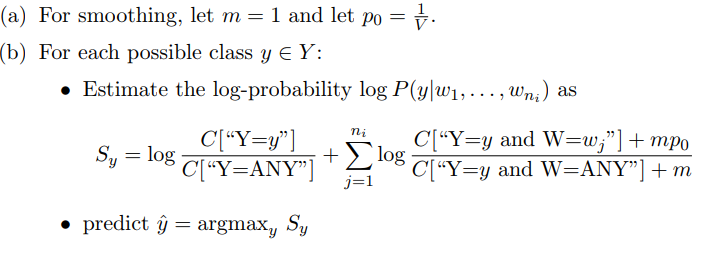

In [44]:
with open('train.txt') as f:
    content = f.readlines()

In [180]:
train_dict = {}
train_label_dict = {}
vocab = set()

for line in content:
    labels, sentence = line.split('\t',1)
    sentence = sentence.lower()
    # removing links
    sentence =  ' '.join([x for x in sentence.split() if ('<' not in x) and ('\\' not in x)])
    # removing numbers and punctuations
    sentence = ''.join([x for x in sentence if (x not in string.punctuation) and (not x.isdigit()) ])
    text = sentence.split()
    
    # remove the stop 
    text = [lemmatizer.lemmatize(word) for word in text if word not in stopwords]
    for label in labels.split(','):
        label = label.strip()
        
        # for class probability
        if label not in train_label_dict:
            train_label_dict[label] = 1
        else:
            train_label_dict[label] += 1
            
        # for dictionary of each class
        if label not in train_dict:
            train_dict[label] = {}
        for w in text: # word count in each class
            if len(w)>3:
                if w not in train_dict[label]:
                    train_dict[label][w] = 1
                else:
                    train_dict[label][w] += 1 
            # adding to vocabulary 
            vocab.add(w)
            

In [207]:
prior_prob= {}
total_class_label = sum(train_label_dict.values())
for key in train_label_dict.keys():
    prior_prob[key] = np.log(train_label_dict[key] / total_class_label)
prior_prob.values()

dict_values([-3.9061122996504074, -3.9132898575275314, -3.903477059414116, -3.912174503787155, -3.908213634653282, -3.9094926166958177, -3.9134678669359917, -3.9075763811225475, -3.9087533547452904, -3.9172283634994978, -3.9195221846420654, -3.9218962405144757, -3.9131194341147393, -3.91642316553027, -3.918690897654498, -3.9333385626715587, -3.941123818718809, -3.928914785303033, -3.9070174276765903, -3.906050312533242, -3.9167360566191376, -3.9137216000316584, -3.9041516859251773, -3.9305358089591103, -3.9277125398688892, -3.912305448647727, -3.9123436110326804, -3.912438697505044, -3.907055227651985, -3.904905534673554, -3.9255028915457735, -3.922308353384679, -3.9035998362273694, -3.907317658478901, -3.9037823815129746, -3.9007909254968927, -3.9008149825418807, -3.9019306670247085, -3.9160870849227387, -3.9280500968821177, -3.9136175058795035, -3.921557527299227, -3.910363005811174, -3.9136651580116326, -3.9224560806346878, -3.903903018310961, -3.903260073034008, -3.9071096896633355

In [204]:
vocab_size  = len(vocab)
vocab = list(vocab)
vocab_size

374680

In [205]:
# total words in class
for class_label in train_dict.keys():
    total_class_words = sum(train_dict[class_label].values())
    train_dict[class_label]['words_in_class'] = total_class_words

In [206]:
train_dict['Main_Belt_asteroids']['words_in_class']

312590

In [208]:
i = 0 # correct predictions
m = 1
v = vocab_size
for line in content:
    labels, sentence = line.split('\t',1)
    sentence = sentence.lower()
    # removing links
    sentence =  ' '.join([x for x in sentence.split() if ('<' not in x) and ('\\' not in x)])
    # removing numbers and punctuations
    sentence = ''.join([x for x in sentence if (x not in string.punctuation) and (not x.isdigit()) ])
    
    text = sentence.split()
    # remove the stop 
    text = [lemmatizer.lemmatize(word) for word in text if word not in stopwords]
    
    # removing blank space at the end of class label
    true_labels = [label.strip() for label in labels.split(',')]
    prob_den = {}
    for class_label in train_dict.keys():
        total_words_class =  train_dict[class_label]['words_in_class']
        for word in text:
            if (word in train_dict[class_label]) and len(word):
                count_fo_w_in_class = train_dict[class_label][word]
            else:
                count_fo_w_in_class = 0
            # probability distribution fo each word
            try:
                prob_den[class_label]=prob_den[class_label]+np.log((count_fo_w_in_class + m/v)/(total_words_class+1))
            except:
                prob_den[class_label]=np.log((count_fo_w_in_class + m/v)/(total_words_class+1))
        prob_den[class_label] = prob_den[class_label] + prior_prob[class_label]
    max_prob = -10000000
    for class_label in prob_den.keys():
        if(prob_den[class_label] >= max_prob):
            pred_class = class_label
            max_prob = prob_den[class_label]
    if(pred_class in true_labels):
        i= i+1
        print(true_labels," JGD ", pred_class)      

['American_film_directors']  JGD  American_film_directors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_journals']  JGD  English-language_journals
['Windows_games']  JGD  Windows_games
['American_film_directors', 'American_people_of_Irish_descent']  JGD  American_film_directors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_directors', 'Deaths_from_myocardial_infarction']  JGD  American_film_directors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Guggenheim_Fellows', 'Deaths_from_myocardial_infarction']  JGD  Guggenheim_Fellows
['Columbia_University_alumni', 'Guggenheim_Fellows

['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films']  JGD  American_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses']  JGD  American_film_actresses
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_journals']  JGD  English-language_journals
['English-language_films', 'British_films']  JGD  British_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_con

['American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_film_directors']  JGD  American_film_directors
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Yale_University_alumni']  JGD  Yale_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
[

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['American_film_directors']  JGD  American_film_directors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  American_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programm

['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Articles_containing_video_clips', 'Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Black-and-white_films', 'English-language_films', 'Articles_contain

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['A

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Harvard_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  Harvard_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni', 'Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'English-language_films']  JGD  American_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Windows_games']  JGD  Windows_games
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_film_directors']  JGD  American_film_directors
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Wi

['American_films', 'English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_films', 'British_films']  JGD  British_films
['Harvard_University_alumni', 'Columbia_University_alumni', 'American_people_of_Irish_descent', 'Articles_containing_video_clips']  JGD  American_people_of_Irish_descent
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Indian_films']  JGD  Indian_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'English-language_films']  JGD  English-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Articles_containing_video_clips']  JGD  

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Windows_games']  JGD  Windows_games
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['American_film_directors']  JGD  American_film_directors
['American_television_actresses']  JGD  American_television_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['Black-and-white_films', 'English-language_films']  JGD  English-language_films
['American_film_directors']  JGD  American_film_directors
['Yale_University_alumni']  JGD  Yale_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Articles_containing_video_clips']  JGD  Articles_containi

['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_film_actresses
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'English-language_films', 'American_drama_films', 'British_films']  JGD  American_drama_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['English-language_television_programming']  JGD  English-language_telev

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'English-language_films']  JGD  American_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_film_actors']  JGD  American_male_film_actors
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'English-language_films']  JGD  American_films
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards', 'Serie_A_players']  JGD  Serie_A_players
['American_films', 'English-language_films']  JGD  American_films
['Columbia_University_alumni', 'Deaths_from_myocardial_infarction']  JGD  Columbia_University_alumni
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Articles_containing_video_clips']  JGD  Articles_co

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_films', 'English-language_films']  JGD  American_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  American_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_vi

['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'English-language_films']  JGD  American_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_actresses', 'American_

['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Windows_games']  JGD  Windows_games
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'English-language_films']  JGD  American_films
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_male_film_actors']  JGD  American_male_film_actors
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Black-and-white_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_male_film_actors', 'American_male_television_acto

['French_films', 'Italian_films']  JGD  French_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_film_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_film_actors']  JGD  American_male_film_actors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['English-language_films']  JGD  English-language_

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'English-language_films']  JGD  American_films
['Black-and-white_films', 'English-language_films']  JGD  English-language_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses']  JGD  American_film_actresses
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_military_pers

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['American_male_film_actors']  JGD  American_male_film_actors
['English-language_films', 'British_films']  JGD  British_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Major_League_Baseball_pitchers', 'American_military_personnel_of_World_War_II']  JGD  Major_League_Baseball_pitchers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'Black-and-white_films', 'Articles_containing_video_clips']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  American_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_cont

['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films']  JGD  American_films
['American_films', 'English-language_films', 'American_drama_films', 'Black-and-white_films']  JGD  American_drama_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-la

['Windows_games']  JGD  Windows_games
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Windows_games']  JGD  Windows_games
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Windows_games']  JGD  Windows_games
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Windows_games']  JGD  Windows_games
['English-language_films']  JGD  English-language_films
['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_defenders']  JGD  Association_football_defenders
['Articles_containing_video_clips']  JGD  Articles_co

['American_male_television_actors', 'American_male_film_actors', 'American_military_personnel_of_World_War_II']  JGD  American_male_film_actors
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films', 'British_films']  JGD  British_films
['Harvard_University_alumni', 'American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Roy

['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Windows_games']  JGD  Windows_games
['Guggenheim_Fellows', 'Deaths_from_myocardial_infarction']  JGD  Guggenheim_Fellows
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_films']  JGD  English-language_films
['American_military_personne

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_television_programming']  JGD  English-language_television_programming
['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Guggenheim_Fellows
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Columbia_University_alumni', 'American_people_of_Irish_descent']  JGD  Columbia_University_alumni
['American_film_directors', 'Deaths_from_myocardial_infarction']  JGD  American_film_directors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Black-and-white_films']  JGD  Black-and-white_films
['American_people_of_Irish_descent', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['American_film_actresses', 'American_televisio

['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Windows_games']  JGD  Windows_games
['American_films']  JGD  American_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  British_films
['American_drama_films']  JGD  American_drama_films
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'English-language_films',

['American_films', 'English-language_films']  JGD  American_films
['American_films']  JGD  American_films
['Italian_films']  JGD  Italian_films
['American_films', 'English-language_films', 'British_films']  JGD  British_films
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films']  JGD  American_films
['American_films']  JGD  American_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'Italian_films']  JGD  Italian_films
['Deaths_from_myocardial_infarction'

['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  American_comedy_films
['American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  American_male_film_actors
['American_film_directors', 'American_male_television_actors', 'American_male_film_actors', 'American_people_of_Irish_descent']  JGD  American_male_film_actors
['Articles_containing_video_cli

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses', 'American_television_actresses', 'Harvard_University_alumni']  JGD  American_television_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_military_personnel_of_World_War_II', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_film_actresses', 'American_people_of_Irish_descent']  JGD  American_film_actresses
['Articles_containing_vid

['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors']  JGD  American_male_film_actors
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['French_films']  JGD  French_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films', 'Black-and-white_films']  JGD  American_films
['American_military_

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_male_television_actors', 'American_male_film_actors', 'American_people_of_Irish_descent']  JGD  American_male_television_actors
['American_comedy_films']  JGD  American_comedy_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-lang

['American_male_film_actors']  JGD  American_male_film_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Guggenheim_Fellows', 'American_people_of_Irish_descent']  JGD  Guggenheim_Fellows
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['American_male_television_actors', 'American_male_film_actors', 'American_military_personnel_of_World_War_II']  JGD  American_male_television_actors
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['English-language_television_programming']  JGD  English-l

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_film_actors']  JGD  American_male_film_actors
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Major_League_Baseball_pitchers', 'American_people_of_Irish_desce

['American_films', 'English-language_films', 'American_drama_films', 'British_films']  JGD  American_drama_films
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'English-language_films']  JGD  American_films
['American_film_directors']  JGD  American_film_directors
['English-language_television_programming']  JGD  English-language_television_programming
['Serie_A_players', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Yale_University_alumni']  JGD  Yale_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_albums']  JGD  English-language_albums
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['The_Football_League_players']  JGD  The_Football_League_players
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['American_films', 'Black-and-white_films', 'English-language_films'] 

['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['Italian_films']  JGD  Italian_films
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['English-language_films', 'French_films']  JGD  French_films
['English-language_films']  JGD  English-language_films
['American_films']  JGD  American_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  A

['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_television_programming']  JGD  English-language_television_programming
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_directors']  JGD  American_film_directors
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_male_film_actors']  JGD  American_male_film_actors
['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  G

['English-language_albums']  JGD  English-language_albums
['American_television_actresses']  JGD  American_television_actresses
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_midfielders', 'German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Harvard_University

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_albums']  JGD  English-language_albums
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'English-language_films', 'Italian_films']  JGD  Italian_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['English-language_

['English-language_television_programming']  JGD  English-language_television_programming
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_journals']  JGD  English-language_journals
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Columbia_University_al

['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Windows_games']  JGD  Windows_games
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Harvard_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  Harvard_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Columbia_University_alumni']  JGD  Columbia

['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['French_films']  JGD  French_films
['English-language_albums']  JGD  English-language_albums
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_films']  JGD  English-language_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Windows_games']  JGD  Windows_games
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_films', 'American_drama_films']  JGD  American_drama_

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_films
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_actresses', 'American_television_actresses', 'Deaths_from_myocardial_infarction']  JGD  American_film_actresses
['Fellows_of_the_Royal_Society']  JGD  Fe

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  American_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Black-and-white_films', 'Articles_containing_video_clips']  JGD  Black-and-white_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_albums']  JGD  English-language_albu

['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  American_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_albums']  JGD  English-language_albums
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_film_directors
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-

['Italian_films', 'American_films', 'French_films', 'English-language_films', 'American_drama_films', 'British_films']  JGD  French_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Harvard_University_alumni', 'Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_forwards', 'Brazilian_footballers', 'Serie_A_players'] 

['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['French_films', 'Italian_films']  JGD  Italian_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'English-language_films']  JGD  English-language_films
['American_male_television_actors', 'American_male_film_actors', 'American_military_personnel_of_World_War_II']  JGD  American_male_television_

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films', 'British_films']  JGD  British_films
['English-language_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Columbia_University_alumni', 'Yale_University_alumni']  JGD  Columbia_University_alumni
['American_films', 'English-language_films', 'Italian_films']  JGD  Italian_films
['English-language_films']  JGD  Eng

['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  American_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Windows_games']  JGD  Windows_games
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Guggenheim_Fellows', 'American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Columbia_University_alumni', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows


['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Columbia_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  Columbia_University_alumni
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['American_military_personnel_of_World_War_II', 'American_people_of_Irish_descent']  JGD  American_people_of_I

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Harvard_University_alumni', 'Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_film_actors', 'American_people_of_Irish_descent']  JGD  American_male_film_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'English-language_films', 'British_films']  JGD  British_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_film_actors', 'American_

['English-language_albums']  JGD  English-language_albums
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_directors']  JGD  American_film_directors
['American_films', 'American_comedy_films']  JGD  American_comedy_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Windows_games']  JGD  Windows_games
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_films']  JGD  American_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_films']  JGD  English-l

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_television_actresses']  JGD  American_television_actresses
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Windows_games']  JGD  Windows_games
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Fo

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_television_actresses']  JGD  American_television_actresses
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Maj

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_television_programming']  JGD  English-language_television_programming
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses']  JGD  American_film_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_television_actors']  JGD  American_male_television_actors
['American_films']  JGD  American_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Windows_games']  JGD  Windows_games
['Guggenheim_Fellows', 'Deaths_from_myocardial_infarction']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English_cricketers']  JGD  English_cricketers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_male_television_actors']  JGD  American_male_television_actors
['Black-and

['American_film_directors', 'American_people_of_Irish_descent', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_film_directors
['Black-and-white_films', 'Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['American_male_television_actors', 'American_male_film_actors', 'American_people_of_Irish_descent']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_male_film_actors']  JGD  American_male_film_actors
['English-language_films']  JGD  English-language_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_television_

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_film_directors']  JGD  American_film_directors
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_male_film_actors']  JGD  America

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'English-language_films']  JGD  American_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['Major_League_Baseball_pitchers', 'American_people_of_Irish_descent']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films', 'British_films']  JGD  British_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Articles_containi

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['French_films']  JGD  French_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['Association_football_midfielders', 'Serie_A_players', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_midfielders', 'The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors']  JGD  American_male_film_actors
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_actresses']  JGD  American_film_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Society

['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['German_footballers']  JGD  German_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'English-language_films']  JGD  American_films
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_drama_films', 'British_films']  JGD  American_drama_films
['English-language_films']  JGD  English-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_film_actors']  JGD  American_male_film_actors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_films', 'British_films']  JGD  British_films
['English-language_films

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['British_films']  JGD  British_films
['American_male_television_actors', 'American_male_film_actors', 'American_people_of_Irish_descent']  JGD  American_male_film_actors
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_albums']  JGD  English-language_albums
['Ameri

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_film_directors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films', 'American_drama_films', 'British_films', 'Italian_films']  JGD  Italian_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming'] 

['Black-and-white_films', 'French_films']  JGD  French_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films', 'French_films']  JGD  French_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_television_actors', 'American_male_film_actors', 'American_people_of_Irish_descent']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Amer

['English-language_films']  JGD  English-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films']  JGD  American_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['French_films', 'British_films']  JGD  French_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Ar

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_albums']  JGD  English-language_albums
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_films']  JGD  English-language_films
['Serie_A_players', 'The_Football_League_players']  JGD  Serie_A_players
['English-language_television_programming']  JGD  English-language_television_programming
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Windows_games']  JGD  Windows_games
['Yale_University_alumni', 'Deaths_from_myocardial_infarction']  JGD  Yale_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_people_of_Irish_descent']  JGD  America

['Russian_footballers']  JGD  Russian_footballers
['English-language_films', 'British_films']  JGD  British_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Windows_games']  JGD  Windows_games
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Yale_University_alumni']  JGD  Yale_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_films']  JGD  American_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infa

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_films', 'British_films']  JGD  British_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_television_actors', 'Deaths_from_myocardial_infarction', 'American_military_personnel_of_World_War_II', 'American_male_film_actors']  JGD  American_male_television_actors
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni', 'Articles_containing_video_clips']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films']  JGD  American_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_television_actresses']  JGD  American_television_actresses
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_television_actresses']  JGD  American_television_actresses
['Indian_films']  JGD  Indian_films
['American_male_television_actors', 'American_male_film_actors', 'American_military_personnel_of_World_War_II']  JGD  American_male_film_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_albums']  J

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_films']  JGD  English-language_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_television_programming']  JGD  English-language_television_programming
['American_film_actresses']  JGD  American_film_actresses
['American_film_directors']  JGD  American_film_directors
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Columbia_University_alumni', 

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_film_directors']  JGD  American_film_directors
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['English-language_albums']  JGD  English-language_albums
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Columbia_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_television_actors'

['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Yale_University_alumni']  JGD  Yale_University_alumni
['Harvard_University_alumni', 'American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors']  JGD  American_male_film_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['German_footballers', 'The_Football_League_players']  JGD  German_footballers
['Guggenhei

['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_television_actresses', 'American_film_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['American_comedy_films']  JGD  American_comedy_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Windows_games']  JGD 

['English-language_films']  JGD  English-language_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_film_directors', 'Guggenheim_Fellows']  JGD  American_film_directors
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['British_films']  JGD  British_films
['American_films', 'English-language_films']  JGD  American_films
['Deaths_from_myo

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_films', 'English-language_films']  JGD  American_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_film_directors']  JGD  American_film_directors
['English-language_television_programming']  JGD  English-language_television_programming
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_film_actresses']  JGD  American_film_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses', 'American_people_of_Irish_descen

['American_film_actresses', 'American_television_actresses', 'Deaths_from_myocardial_infarction']  JGD  American_television_actresses
['Guggenheim_Fellows', 'Deaths_from_myocardial_infarction']  JGD  Guggenheim_Fellows
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'American_comedy_films', 'Articles_containing_video_clips']  JGD  American_comedy_films
['American_film_directors']  JGD  American_film_directors
['American_male_film_actors', 'American_people_of_Irish_descent']  JGD  American_male_film_actors
['English-language_albums']  JGD  English-language_albums
['English-language_journals']  JGD  English-language_journals
['American_male_film_actors', 'America

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Windows_games']  JGD  Windows_games
['American_television_actresses']  JGD  American_television_actresses
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_midfielders', 'English_footballers']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-language_films
['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_fil

['Association_football_goalkeepers', 'German_footballers', 'The_Football_League_players']  JGD  German_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_albums']  JGD  English-language_albums
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_television_actors', 'American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  American_male_film_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-

['Serie_A_players']  JGD  Serie_A_players
['Serie_A_players']  JGD  Serie_A_players
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['German_footballers', 'Serie_A_players']  JGD  German_footballers
['Association_football_forwards', 'Serie_A_players']  JGD  Serie_A_players
['Serie_A_players', 'Italian_footballers']  JGD  Serie_A_players
['Serie_A_players', 'Association_football_defenders', 'Italian_footballers']  JGD  Serie_A_players
['Association_football_defenders', 'Serie_A_players', 'Italian_footballers']  JGD  Serie_A_players
['Serie_A_players', 'Italian_footballers']  JGD  Serie_A_players
['Association_football_forwards', 'Serie_A_players', 'Italian_footballers']  JGD  Serie_A_players
['Association_football_forwards', 'Serie_A_players', 'Italian_footballers']  JGD  Serie_A_players
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_film_actresses']  JGD  American_film_actresses
['Fellows_of_the_Royal_Soc

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_films', 'British_films']  JGD  British_films
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['American_film_directors']  JGD  American_film_directors


['English-language_television_programming']  JGD  English-language_television_programming
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Windows_games']  JGD  Windows_games
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'English-language_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-languag

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  American_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films']  JGD  English-language_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Black-and-white_films', 'English-language_films', 'Br

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_films', 'British_films']  JGD  British_films
['American_military_personnel_of_World_War_II', 'American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  American_male_film_actors
['American_male_television_actors', 'American_military_personnel_of_World_War_II', 'American_male_film_actors']  JGD  American_male_television_actors
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Windows_games']  JGD  Windows_games
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Yale_University_alumni']  JGD  Yale_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Engl

['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_television_actors']  JGD  American_male_television_actors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_television_actresses']  JGD  American_television_actresses
['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_actresses', 'America

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Black-and-white_films']  JGD  Black-and-white_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses']  JGD  American_film_actresses
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  Engli

['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_military_personnel_of_World_War_II', 'American_people_of_Irish_descent']  JGD  American_military_personnel_of_World_War_II
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Windows_games']  JGD  Windows_games
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['Windows_games']  JGD  Windows_games
['American_film_actresses', 'Ame

['Association_football_goalkeepers', 'Serie_A_players']  JGD  Serie_A_players
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_film_actresses', 'American_people_of_Irish_descent']  JGD  American_film_actresses
['English-language_films']  JGD  English-language_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_television_actors', 'American_male_film_actors', 'American_people_of_Irish_descent']  JGD  American_male_television_actors
['Association_football_defenders']  JGD  Association_football_defenders
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_f

['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Scottish_footballers', 'The_Football_League_players', 'Deaths_from_myocardial_infarction']  JGD  Scottish_footballers
['Association_football_def

['American_male_television_actors']  JGD  American_male_television_actors
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['American_television_actresses']  JGD  American_television_actresses
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films']  JGD  American_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_television_actresses']  JGD  American_television_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_television_actor

['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_film_directors']  JGD  American_film_directors
['English-language_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_actresses', 'American_television_actresses', 'Deaths_from_myocardial_infarction']  JGD  American_film_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_o

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_television_actresses']  JGD  American_television_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_albums']  JGD  English-language_albums
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_television_actresses']  JGD  American_television_actresses
['American_television_actresses']  JGD  American_television_actresses
['English-language_albums']  JGD  English-language_albums
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_albums']  JGD  English-language_albums
['The_Foot

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['American_film_directors']  JGD  American_film_directors
['American_film_directors']  JGD  American_film_directors
['Association_football_midfielders', 'The_Football_League_players']  JGD  Association_football_midfielders
['Windows_games']  JGD  Windows_games
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Americ

['English-language_films']  JGD  English-language_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_television_programming']  JGD  English-language_television_programming
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_albums']  JGD  English-language_albums
['American_te

['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films', 'British_films']  JGD  British_films
['Serie_A_players']  JGD  Serie_A_players
['American_film_directors']  JGD  American_film_directors
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English_footballers', 'Deaths_from_myocardial_infarction']  JGD  English_footballers
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Yale_University_alumni']  JGD  Yale_University_alumni
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['American_male_film_actors']  JGD  American_male_film_actors
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Harvard_University_alumni']  JGD  Harvard

['Windows_games']  JGD  Windows_games
['American_television_actresses']  JGD  American_television_actresses
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Windows_games']  JGD  Windows_games
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Columbia_University_alumni', 'Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_military_personnel_of_World_War_II', 'American_male_television_actors']  JGD  America

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_military_personnel_of_World_War_II', 'Yale_University_alumni']  JGD  American_military_personnel_of_World_War_II
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English_cricketers']  JGD  English_cricketers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Ro

['Brazilian_footballers', 'Serie_A_players']  JGD  Serie_A_players
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Harvard_University_alumni', 'Columbia_University_alumni', 'Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Harvard_University_alumni
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'American_comedy_films']  JGD  Amer

['American_television_actresses', 'Deaths_from_myocardial_infarction']  JGD  American_television_actresses
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni', 'Fellows_of_the_Royal_Society']  JGD  Harvard_University_alumni
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Windows_games']  JGD  Windows_games
['English_cricketers']  JGD  English_cricketers
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['Harvard_Un

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Scottish_footballers']  JGD  Scottish_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Windows_games']  JGD  Windows_games
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['American_film_directors']  JGD  American_film_directors
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['American_fi

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['Yale_University_alumni']  JGD  Yale_University_alumni
['Windows_games']  JGD  Windows_games
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Serie_A_players', 'The_Football_League_players']  JGD  Serie_A_players
['American_films', 'English-language_films']  JGD  American_films
['French_films']  JGD  French_films
['English-language_television_programming']  JGD  English-la

['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  American_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Major_League_Baseball_pitchers', 'American_people_of_Irish_descent']  JGD  Major_League_Baseball_pitchers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Italian_films']  JGD  Italian_films
['French_films', 'Italian_films']  JGD  French_films
['Black-and-white_films']  JGD  Black-and-white_films
['American_male_television_actors']  JGD  American_male_television_actors
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_televi

['Windows_games']  JGD  Windows_games
['Yale_University_alumni']  JGD  Yale_University_alumni
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Guggenheim_Fellows', 'American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Articles_containing_video_clips']  JGD  Articles_containing

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'English-language_films']  JGD  American_films
['American_film_actresses']  JGD  American_film_actresses
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'French_films', 'British_films']  JGD  French_films
['American_films', 'English-language_films']  JGD  English-language_films
['American_film_directors', 'American_film_actresses']  JGD  American_film_directors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_film_directors']  JGD  American_film_directors
['American_film_actresses']  JGD  American_film_actresses
['English-language_films']  JGD  English-language_films
['American_military_personnel_of_World_War_II', 'American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_film_actresses', 'American_television_actresses', 'Yale_University_alumni']  JGD  Am

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_television_actors', 'Deaths_from_myocardial_infarction', 'American_military_personnel_of_World_War_II', 'American_male_film_actors']  JGD  American_male_television_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_televi

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_films', 'English-language_films']  JGD  American_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders', 'English_footballers', 'The_Football_League_players', 'Deaths_from_myocardial_infarction']  JGD  English_footballers
['American_film_directors']  JGD  American_film_directors
['American_male_film_actors']  JGD  American_male_film_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['English-language_films']  JGD  English-language_films
[

['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_military_personnel_of_World_War_II', 'American_people_of_Irish_descent']  JGD  American_military_personnel_of_World_War_II
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['French_films', 'Italian_films']  JGD  Italian_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_film_actresses']  JGD  American_film_actresses
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['Italian_films']  JGD  Italian_films
['Windows_games']  JGD  Windows_games
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_film_directors']  JGD  American_film_directo

['American_comedy_films']  JGD  American_comedy_films
['Windows_games']  JGD  Windows_games
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_film_actresses']  JGD  American_film_actresses
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_film_actresses', 'American_television_actresses']  JGD 

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films', 'British_films']  JGD  British_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['Serie_A_players', 'Italian_footballers']  JGD  Serie_A_players
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'American_comedy_films']  JGD  American_comedy_films
['Windows_games']  JGD  Windows_games
['Black-and-white_films', 'French_films']  JGD  French_films
['American_people_of_Irish_descent']  JGD  

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['English_cricketers']  JGD  English_cricketers
['American_films', 'American_comedy_films']  JGD  American_comedy_films
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders', 'Association_football_defenders', 'English_footballers']  JGD  English_footballers
['American_male_television_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Scottish_footballers']  JGD  Scottish_footballers


['American_male_television_actors', 'American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_film_actors']  JGD  American_male_film_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_television_programming']  JGD  English-language_television_programming
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Columbia_Universi

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_television_actors']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films', 'British_films']  JGD  British_films
['American_male_film_actors', 'American_male_television_actors']  JGD  America

['English-language_films', 'British_films']  JGD  British_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Yale_University_alumni']  JGD  Yale_University_alumni
['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['English-language_albums']  JGD  English-language_albums
['American_military_personnel_of_World_War_II', 'American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_albums']  JGD  English-language_albums
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['The_Football_League_players']  JGD  The_Football_League_players
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_films', 'English-language_films']  JGD  American_films
['Windows_games']  JGD  Windows_games
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['American_film_actresses', 'American_television_actre

['British_films']  JGD  British_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_film_actresses']  JGD  American_film_actresses
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors', 'American_male_televis

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors']  JGD  American_male_film_actors
['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_film_actresses
['Scottish_footballers', 'Association_football_defenders', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_goalkeepers
['American_films', 'English-language_films']  JGD  American_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  M

['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['The_Football_League_players']  JGD  The_Football_League_players
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['English-language_films']  JGD  English-language_films
['French_films']  JGD  French_films
['American_film_directors']  JGD  American_film_directors
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_television_actors']  JGD  American_male_television_actors
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_film_actresses', 'American_television_act

['Windows_games']  JGD  Windows_games
['American_comedy_films']  JGD  American_comedy_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_journals']  JGD  English-language_journals
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Windows_games']  JGD  Windows_games
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_come

['British_films']  JGD  British_films
['American_films', 'English-language_films']  JGD  American_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'English-language_films']  JGD  American_films
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Columbia_University_alumni', 'American_male_film_actors']  JGD  American_male_film_actors
['American_film_directors', 'American_male_television_actors', 'American_male_film_actors']  JGD  American_male_film_actors
['American_film_directors', 'American_military_personnel_of_World_War_II']  JGD  American_film_directors
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-lan

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'English-language_films']  JGD  American_films
['Black-and-white_films']  JGD  Black-and-white_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Association_f

['Windows_games']  JGD  Windows_games
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Windows_games']  JGD  Windows_games
['German_footballers']  JGD  German_footballers
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Black-and-white_films', 'British_films']  JGD  British_films
['English-language_films']  JGD  English-language_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Deaths_from_myocardial_infarction'] 

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Guggenheim_Fellows', 'Deaths_from_myocardial_infarction']  JGD  Guggenheim_Fellows
['Yale_University_alumni']  JGD  Yale_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_male_film_actors']  JGD  American_male_film_actors
['American_film_actresses']  JGD  American_film_actresses
['Harvard_University_al

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  Association_football_goalkeepers
['Yale_University_alumni']  JGD  Yale_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_forwards', 'Serie_A_players']  JGD  Serie_A_players
['Yale_University_alumni']  JGD  Yale_University_alumni
['Yale_University_alumni']  JGD  Yale_University_alumni
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Windows_games']  JGD  Windows_games
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_television_programming']  JGD 

['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['English-language_television_programming']  JGD  English-language_television_programming
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders', 'Serie_A_players', 'Russian_footballers']  JGD  Russian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders', 'Serie_A_players']  JGD  Ser

['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Black-and-white_films']  JGD  Black-and-white_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English_footballers']  JGD  English_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  Eng

['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_television_actors']  JGD  American_male_television_actors
['Columbia_University_alumni', 'Guggenheim_Fellows', 'American_military_personnel_of_World_War_II']  JGD  Guggenheim_Fellows
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['The_Football_League_players']  JGD  The_Football_League_players
['American_male_film_actors']  JGD  American_male_

['English-language_films']  JGD  English-language_films
['English-language_journals']  JGD  English-language_journals
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Windows_games']  JGD  Windows_games
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_midfielders
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  Articles_containing_video

['British_films']  JGD  British_films
['American_film_directors', 'American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films']  JGD  American_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films']  JGD  English-language_films
['Windows_games']  JGD  Windows_games
['Harvard_University_alumni', 'American_film_directors']  JGD  American_film_directors
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['American_film_directors']  JGD  American_film_directors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Colum

['English-language_television_programming']  JGD  English-language_television_programming
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_male_film_actors']  JGD  American_male_film_actors
['Windows_games']  JGD  Windows_games
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_film_actors']  JGD  American_male_film_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni', 'American_people_of_Irish_descent']  JGD  American_people_of

['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American_television_actresses']  JGD  American_television_actresses
['English-language_albums']  JGD  English-language_albums
['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Yale_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['English-language_films', 'American_comedy_films']  JGD  American_c

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_male_television_actors', 'American_film_directors', 'American_male_film_actors', 'American_people_of_Irish_descent']  JGD  American_male_film_actors
['American_comedy_films']  JGD  American_comedy_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_films']  JGD  English-language_films
['Windows_games']  JGD  Windows_games
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_p

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_film_actresses']  JGD  American_film_actresses
['Black-and-white_films']  JGD  Black-and-white_films
['Guggenheim_Fellows', 'Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Italian_films']  JGD  Italian_films
['Windows_games']  JGD  Windows_games
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Guggenheim_Fellow

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['French_films']  JGD  French_films
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['Black-and-white_films']  JGD  Black-and-white_films
['American_film_directors']  JGD  American_film_directors
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_per

['English-language_albums']  JGD  English-language_albums
['English-language_journals']  JGD  English-language_journals
['English-language_albums']  JGD  English-language_albums
['Brazilian_footballers']  JGD  Brazilian_footballers
['Windows_games']  JGD  Windows_games
['Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films']  JGD  American_films
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  Association_football_goalkeepers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_albums']  JGD  English-language_album

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American_film_directors']  JGD  American_film_directors
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_television_actresses']  JGD  American_television_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_al

['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  American_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards']  JGD  Association_football_forwards
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders', 'The_Football_League_

['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  American_comedy_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses']  JGD  American_film_actresses
['American_film_actresses']  JGD  American_film_actresses
['English-language_films']  JGD  English-language_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_television_actresses']  JGD  American_television_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['English-language_films']  JGD  English-language_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Art

['English-language_albums']  JGD  English-language_albums
['American_film_actresses']  JGD  American_film_actresses
['Association_football_midfielders', 'The_Football_League_players']  JGD  The_Football_League_players
['American_male_television_actors']  JGD  American_male_television_actors
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_film_directors']  JGD  American_film_directors
['English-language_television_programming']  JGD  English-language_television_programming
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pit

['English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_television_actors', 'American_male_film_actors', 'Yale_University_alumni']  JGD  American_male_television_actors
['American_film_directors']  JGD  American_film_directors
['American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['Serie_A_players', 'Italian_footballers']  JGD  Serie_A_players
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_television_actresses']  JGD  American_television_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-langua

['English-language_television_programming']  JGD  English-language_television_programming
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_film_directors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_albums']  JGD  English-language_albums
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_film_directors']  JGD  American_film_directors
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['The_Football_League_players']  JGD  The_Football

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_films
['French_films']  JGD  French_films
['American_films', 'English-language_films']  JGD  English-language_films
['Windows_games']  JGD  Windows_games
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_films']  JGD  English-language_films
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['Association_football_forwards', 'Russian_footballers']  JGD  Russian_footballers
['American_male_television_actors', 'American_male_film_actors', 'Deaths_from_myocardial_infar

['English-language_films']  JGD  English-language_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_male_television_actors', 'American_male_film_actors', 'American_people_of_Irish_descent']  JGD  American_male_film_actors
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders', 'The_Football_League_players']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['Associatio

['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players']  JGD  Serie_A_players
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['American_film_directors']  JGD  American_film_directors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses']  JGD  American_film_actresses
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_people_of_Irish_descent', 'Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_television_actresses']  JGD  American_television_actresses
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_film

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_goalkeepers', 'Serie_A_players', 'Italian_footballers']  JGD  Association_football_goalkeepers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_albums']  JGD  English-language_albums
['British_films']  JGD  British_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Deaths_from_myocardial_i

['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['American_films']  JGD  American_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['Association_football_midfielders']  JGD  Association_football_midfielders
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_films']  JGD  English-language_films
['American_film_directors', 'Guggenheim_Fellows']  JGD  American_film_director

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Windows_games']  JGD  Windows_games
['English_cricketers']  JGD  English_cricketers
['English-language_albums']  JGD  English-language_albums
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_albums']  JGD  English-language_albums
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Articles_con

['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Columbia_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  Columbia_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Yale_University_alumni']  JGD  Yale_University_alumni
['Insects_of_Europe']  JGD  Insects_of_Europe
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['German_footballers']  JGD  German_football

['American_male_television_actors']  JGD  American_male_television_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_contai

['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_film_actresses']  JGD  American_film_actresses
['American_television_actresses', 'American_film_actresses', 'Deaths_from_myocardial_infarction']  JGD  American_film_actresses
['

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni', 'Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_films', 'British_films']  JGD  British_films
['Windows_games']  JGD  Windows_games
['English-language_films']  JGD  English-language_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Serie_A_players']  JGD  Serie_A_players
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['American_military_personnel_of_World_War_II', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_forwar

['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_albums']  JGD  English-language_albums
['American_male_television_actors']  JGD  American_male_television_actors
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_male_television_actors']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Windows_games']  JGD  Windows_games
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_television_programming']  JGD  English-language_television_programming
['Arti

['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_television_actresses']  JGD  American_television_actresses
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Yale_University_alumni']  JGD  Yale_University_alumni
['Russian_footballers']  JGD  Russian_footballers
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_male_film

['British_films']  JGD  British_films
['American_male_television_actors']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Windows_games']  JGD  Windows_games
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['The_Football_League_players', 'Deaths_from_myocardial_infarction']  JGD  The_Football_League_players
['American_male_film_actors']  JGD  American_male_film_actors
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_film_actresses']  JGD  American_film_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['Maj

['Windows_games']  JGD  Windows_games
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_male_film_actors']  JGD  American_male_film_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_film_directors', 'Deaths_from_myocardial_infarction']  JGD  American_film_directors
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_film_actors', 'American_male_television_

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_military_personnel_of_World_War_II', 'American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Harvard_University_alumni', 'Columbia_University_alumni']  JGD  Columbia_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']

['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['American_male_film_actors', 'American_military_personnel_of_World_War_II', 'American_male_television_actors']  JGD  American_male_film_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_films', 'English-language_films']  JGD  American_films
['Black-and-white_films']  JGD  Black-and-white_films
['American_military_personnel_of_

['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_male_television_actors']  JGD  American_male_television_actors
['Yale_University_alumni']  JGD  Yale_University_alumni
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_films']  JGD 

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Indian_films']  JGD  Indian_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Harvard_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Art

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films', 'British_films']  JGD  British_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films']  JGD  English-language_films
['Guggenheim_Fel

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_albums']  JGD  English-language_albums
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_albums']  JGD  English-language_albums
['American_male_television_actors']  JGD  American_male_television_actors
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['British_films']  JGD  British_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Harvard_University_alumni', 'American_people_of_Irish_descent']  JGD  A

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films', 'British_films']  JGD  British_films
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards']  JGD  Association_football_forwards
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['English-language_television_programming']  JGD  English-language_television_programming
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['Black-and-white_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['

['Insects_of_Europe']  JGD  Insects_of_Europe
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_television_actresses', 'American_film_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Society']  JGD  

['English-language_television_programming']  JGD  English-language_television_programming
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['English-language_television_programming']  JGD  English-language_television_programming
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_films', 'English-language_films']  JGD  American_films
['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_

['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'English-language_films']  JGD  American_films
['Italian_films']  JGD  Italian_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_film_directors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_male_film_actors']  JGD  American_male_film_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Italian_films']  JGD  Italian_films
['English-language_films']  JGD  English-language_films
['German_footballers']  JGD  German_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['German_footballers', 'Serie_

['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_albums']  JGD  English-language_albums
['American_comedy_films']  JGD  American_comedy_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['American_film_actresses']  JGD  American_film_actresses
['Columbia_University_alumni']  JGD  Columbia_Univers

['American_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['English-language_films']  JGD  English-language_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_television_programming']  JGD  English-language_television_programming
['American_drama_films']  JGD  American_drama_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_comedy_films']  JGD  American_comedy_films
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Brazilian_footballers']  JGD  Braz

['Harvard_University_alumni', 'Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Yale_University_alumni
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_journals']  JGD  English-language_journals
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['American_film_actresses', 'Amer

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders', 'Association_football_forwards']  JGD  Association_football_midfielders
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English_footballers']  JGD  English_footballers
['American_television_actresses']  JGD  American_television_actresses


['English-language_films', 'British_films']  JGD  British_films
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Windows_games']  JGD  Windows_games
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_films', 'British_films']  JGD  British_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['American_films']  JGD  Americ

['American_film_directors']  JGD  American_film_directors
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['American_films', 'English-language_films']  JGD  American_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_albums']  JGD  English-language_albums
['Association_football_defenders']  JGD  Association_football_defenders
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['Association_football_forwards', 'Associatio

['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_films', 'English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses']  JGD  Ameri

['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  American_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers', 'Association_football_goalkeepers', 'The_Football_League_players']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses']  JGD  American_film_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitcher

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Windows_games']  JGD  Windows_games
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_male_film_actors']  JGD  American_male_film_actors
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_film_directors
['English-langu

['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_film_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['American_television_actresses']  JGD  American_television_actresses
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_film_actors']  JGD  American_male_film_actors
['English-language_films']  JGD  English-language_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Major_League_

['English-language_television_programming']  JGD  English-language_television_programming
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_film_directors']  JGD  American_film_directors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_television_actors']  JGD  American_male_television_actors
['English-language_films']  JGD  English-language_films
['Windows_games']  JGD  Windows_games
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Yale_University_alumni']  JGD  Yale_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_albums']  JGD  English-language_albums
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Wi

['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['American_television_actresses']  JGD  American_television_actresses
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_films', 'American_comedy_films']  JGD  American_comedy_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_male_television_actors', 'American_male_film_actors', 'American_people_of_Irish_descent']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Societ

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Insects_of_Europe']  JGD  Insects_of_Europe
['Brazilian_footballers']  JGD  Brazilian_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Black-and-white_films']  JGD  Black-and-white_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['British_films']  JGD  British_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Windows_games']  JGD  Windows_games
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_midfielders', 'The_Football_League_players']  JGD  The_Football_League_players
['Columbia_University_alumni']  JGD  Columbia_

['Indian_films']  JGD  Indian_films
['American_male_television_actors']  JGD  American_male_television_actors
['English-language_films', 'British_films']  JGD  British_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_film_acto

['American_film_directors']  JGD  American_film_directors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Columbia_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'English-language_films']  JGD  English-language_films
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'English-language_films']  JGD  American_films
['Windows_games']  JGD  Windows_games
['Association_football_forwards']  JGD  Association_football_forwards
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Windows_games']  JGD  Windows_games
['American_films']  JGD  American_films
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Guggenheim_Fellows']  JGD

['English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_films
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_albums']  JGD  English-language_albums
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_films', 'British_films']  JGD  British_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'American_drama_films']  JGD  American_drama_films
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people


['American_films', 'English-language_films']  JGD  American_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['Italian_films']  JGD  Italian_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Windows_games']  JGD  Windows_games
['English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Har

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_directors', 'American_people_of_Irish_descent', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_films', 'British_films']  JGD  British_films
['English-language_albums']  JGD  English-language_albums
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_i

['Black-and-white_films']  JGD  Black-and-white_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['Brazilian_footballers', 'Serie_A_players']  JGD  Brazilian_footballers
['Brazilian_footballers']

['American_male_film_actors']  JGD  American_male_film_actors
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Harvard_University_alumni', 'Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_forwards', 'English_footballers']  JGD  English_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  The_Football_League_players
['English-language_films']  JGD  English-language_films
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_midfielders', 'The_Foot

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  American_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Black-and-white_films', 'English-language_films']  JGD  English-language_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Briti

['Windows_games']  JGD  Windows_games
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  American_films
['British_films']  JGD  British_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['French_films']  JGD  French_films
['French_films']  JGD  French_films
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-langua

['English_cricketers']  JGD  English_cricketers
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'English-language_films']  JGD  American_films
['Serie_A_players', 'Association_football_defenders']  JGD  Serie_A_players
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Insects_of_Europe']  JGD  Insects_of_Europe
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_goalkeepers
['The_Football_League_players']  JGD  The_Football_League_players
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'English-language_films']  JGD  American_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Harvard_University_alum

['Yale_University_alumni']  JGD  Yale_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_male_film_actors', 'American_male_te

['English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['Black-and-white_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_male_film_actors']  JGD  American_male_film_actors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_film_actresses']  JGD  American_film_actresses
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films', 'British_films']  JGD  British_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_comedy_films']  JGD  American_comedy_films
['Black-and-white_films']  JGD  Black-and-white_films
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['English-language_films']  JGD  English-language_films
['English-language_television_programming'] 

['Indian_films']  JGD  Indian_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films']  JGD  American_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_televisi

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Insects_of_Europe', 'Articles_containing_video_clips']  JGD  Insects_of_Europe
['American_male_television_actors']  JGD  American_male_television_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Insects_of_Europe']  JGD  Insects_of_Europe
['American_film_directors', 'Deaths_from_myocardial_infarction']  JGD  American_film_directors
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors']  JGD  American_male_film_actors
['American_male_film_actors'

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  American_male_film_actors
['American_film_actresses']  JGD  American_film_actresses
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_directors']  JGD  American_film_directors
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['French_films', 'Italian_films']  JGD  French_films
['America

['English-language_television_programming']  JGD  English-language_television_programming
['American_film_directors']  JGD  American_film_directors
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_films']  JGD  English-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Windows_games']  JGD  Windows_games
['Insects_of_Europe', 'Articles_containing_video_clips']  JGD  Insects_of_Europe
['Insects_of_Europe', 'Articles_containing_video_clips']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe', 'Articles_containing_video_clips']  JGD  Insects_of_Europe
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_television_actresses', 'American_film_a

['English-language_films']  JGD  English-language_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_films']  JGD  American_films
['American_film_directors']  JGD  American_film_directors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Windows_games']  JGD  Windows_games
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['American_male_film_actors']  JGD  American_male_film_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_male_film_actors', 'American_military_p

['English-language_films', 'British_films']  JGD  British_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['American_male_film_actors']  JGD  American_male_film_actors
['American_film_directors']  JGD  American_film_directors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films', 'French_films']  JGD  French_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Windows_games']  JGD  Windows_games
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Black-and-white_films', 'English-language_films', 'British_f

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses']  JGD  American_film_actresses
['American_films', 'English-language_films']  JGD  American_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_film_directors']  JGD  American_film_directors
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'English-language_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['Scottish_footballers', 'Association_football_defenders']  JGD

['English-language_albums']  JGD  English-language_albums
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_directors']  JGD  American_film_directors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_drama_films']  JGD  American_drama_films
['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors', 'American_male_television_actors']  JGD  Amer

['American_films', 'English-language_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['Guggenheim_Fellows', 'Deaths_from_myocardial_infarction']  JGD  Guggenheim_Fellows
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_televi

['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_male_film_actors']  JGD  American_male_film_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['English-language_journals']  JGD  English-language_journals
['American_films', 'English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors']  JGD  American_male_film_actors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_television_actresses']  JGD  American_television_actresses
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Guggenheim_Fellows']  J

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['English-language_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  British_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_f

['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Black-and-white_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films']  JGD  American_films
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_film_dir

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Serie_A_players']  JGD  Serie_A_players
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_goalkeepers
['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Black-and-white_films']  JGD  Black-and-white_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_

['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_male_film_actors']  JGD  American_male_film_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Harvard_University_alumni', 'Guggenheim_Fellows', 'Deaths_from_myocardial_infarction']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films']  JGD  English-language_films
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films', 'British_films']  JGD  Br

['Windows_games']  JGD  Windows_games
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Yale_University_alumni']  JGD  Yale_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders', 'The_Football_League_players']  JGD  The_Football_League_players
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Articles_containing_video_clips', 'Deaths_from_myocardial_infarction'

['American_television_actresses']  JGD  American_television_actresses
['English-language_films']  JGD  English-language_films
['Windows_games']  JGD  Windows_games
['English-language_films']  JGD  English-language_films
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_fil

['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Deaths_from_myocardial_infarction', 'American_military_personnel_of_World_War_II', 'American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Ha

['English_cricketers', 'English_footballers']  JGD  English_cricketers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['English-language_films']  JGD  English-language_films
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['English-language_films']  JGD  English-languag

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Windows_games']  JGD  Windows_games
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_male_film_actors']  JGD  American_male_film_actors
['American_films', 'English-language_films']  JGD  American_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_films', 'British_films']  JGD  British_films
['English-language_albums']  JGD  English-language_albums
['American_people_of_Irish_descent']  JGD  American_people_of_I

['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_albums']  JGD  English-language_albums
['American_television_actresses']  JGD  American_television_actresses
['English-language_films']  JGD  English-language_films
['American_film_directors']  JGD  American_film_directors
['American_film_directors', 'American_male_film_actors', 'American_people_of_Irish_descent']  JGD  American_film_directors
['American_film_actresses', 'Deaths_from_myocardial_infarction']  JGD  American_film_actresses
['English-language_films']  JGD  English-language_films
['American_male_film_actors', 'American_male_t

['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['Scottish_footballers']  JGD  Scottish_footballers
['American_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['American_television_actresses']  JGD  American_television_actresses
['English-language_films']  JGD  English-language_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'English-language_films']  JGD  American_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Harvard_University_alumni', 'Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-langua

['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  English-language_films
['Windows_games']  JGD  Windows_games
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Black-and-white_films']  JGD  Black-and-white_films
['Indian_films']  JGD  Indian_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films']  JGD  English-language_films
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_journals']  JGD  English-language_journals
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['En

['Guggenheim_Fellows', 'Deaths_from_myocardial_infarction']  JGD  Guggenheim_Fellows
['Black-and-white_films']  JGD  Black-and-white_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_films', 'British_films']  JGD  British_films
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['Black-and-white_films']  JGD  Black-and-white_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['English-language_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_acto

['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'Articles_containing_video_clips']  JGD  Black-and-white_films
['Windows_games']  JGD  Windows_games
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['Yale_University_alumni']  JGD  Yale_University_alumni
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['American_film_actresses']  JGD  American_film_actresses
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Windows_games']  JGD  Windows_games
['Associat

['American_films', 'English-language_films']  JGD  American_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['English-language_albums']  JGD  English-language_albums
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_film_directors', 'American_male_film_actors', 'Ame

['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Brazilian_footballers', 'The_Football_League_players']  JGD  Brazilian_footballers
['English-language_films', 'British_films']  JGD  British_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films']  JGD  English-language_films

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'English-language_films']  JGD  American_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['America

['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_male_television_actors']  JGD  American_male_television_actors
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian

['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['German_footballers']  JGD  German_footballers
['American_film_actresses']  JGD  American_film_actresses
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_military_personnel_of_World_War_II', 'Deaths_from_myocardial_infarction']  JGD  American_military_personnel_of_World_War_II
['American_film_actresses', 'American_television_actresses', 'Yale_University_alumni']  JGD  American_television_actresses
['Harvard_University_alumni', 'Guggenheim_Fellows'

['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films', 'British_films']  JGD  British_films
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_films', 'English-language_films']  JGD  American_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['British_films']  JGD  British_films
['English-language

['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_television_programming']  JGD  English-language_television_programming
['The_Football_League_players']  JGD  The_Football_League_players
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  American_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_midfielders', 'The_Football_League_players']  JGD  The_Football_League_players
['Serie_A_players', 'Association_foot

['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_films', 'English-language_films']  JGD  American_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Scottish_footballers']  JGD  Scottish_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_film_actresses']  JGD  American_film_actresses
['British_films']  JGD  British_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_fi

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['English-language_television_programming']  JGD  English-language_television_programming
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Vil

['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Yale_University_alumni']  JGD  Yale_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_actresses']  JGD  American_film_actresses
['English_footballers']  JGD  English_footballers
['American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_film_directors', 'American_film_actresses']  JGD  American_film_actresses
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Fellows_

['American_male_television_actors']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Windows_games']  JGD  Windows_games
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_films', 'English-language_films']  JGD  American_films
['English-langu

['American_film_directors']  JGD  American_film_directors
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_films', 'English-language_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['English_cricketers']  JGD  English_cricketers
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['Articl

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_films', 'British_films']  JGD  British_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_films']  JGD  English-language_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Russian_footballers']  JGD  Russian_footballers
['Serie_A_players']  JGD  Serie_A_players
['French_films']  JGD  French_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_films']  JGD  English-language_films
['American_film_directors']  JGD  American_film_directors
['Association_football_forwards']  JGD  Association_football_forwards
['Columbia_University_a

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_films']  JGD  English-language_films
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['Brazilian_footballers', 'Serie_A_players']  JGD  Brazi

['English-language_films']  JGD  English-language_films
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['English_cricketers']  JGD  English_cricketers
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['American_films', 'Black-and-white_films', 'Articles_containing_video_clips']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders']  JGD  Association_football_midfielders
['Fellows_of_the_

['American_film_actresses']  JGD  American_film_actresses
['Insects_of_Europe']  JGD  Insects_of_Europe
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['The_Football_League_players']  JGD  The_Football_League_players
['Windows_games']  JGD  Windows_games
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids

['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  The_Football_League_players
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['Association_footb

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['English-language_albums']  JGD  English-language_albums
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['American_films', 'English-language_films']  JGD  American_films
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['English-language_albums']  JGD  English-language_albums
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_military_personnel_of_World_War_II', 'Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_forwards']  J

['English-language_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['British_films']  JGD  British_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['English-language_albums']  JGD  English-language_albums
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['American_film_dire

['American_films', 'English-language_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Yale_University_alumni']  JGD  Yale_University_alumni
['English_cricketers']  JGD  English_cricketers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'English-language_films']  JGD  English-language_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_films']  JGD  English-language_films
['American_male_television_actors']  JGD  American_male_television_actors
['Association_football_goalkeepers', 'The_

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_film_directors']  JGD  American_film_directors
['Black-and-white_films', 'English-language_films']  JGD  English-language_films
['American_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_male_television_actors']  JGD  American_male_television_actors
['English_cricketers']  JGD  English_cricketers
['English-language_films']  JGD  English-language_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Yale_University_alumni']  JGD  Yale_University_alumni
['Windows_games']  JGD  Windows_games
['American_film_directors']  JGD  American_film_directors
['Black-and-white_films']  JGD  Black-and-white_films
['Harv

['Black-and-white_films', 'American_comedy_films', 'Articles_containing_video_clips']  JGD  American_comedy_films
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni', 'Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['The_Football_League_players']  JGD  The_Football_League_players
['American_film_directors']  JGD  American_film_directors
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Hindi-language_films']  JGD  Hindi-language_films
['American_male_film_actors']  JGD  American_male_film_actors
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_film_directors']  JGD  American_film_directors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films'

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['English-language_films']  JGD  English-language_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni', 'Yale_University_alumni']  JGD  Harvard_University_alumni
['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Windows_games']  JGD  Windows_games
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Scottish_footballers']  JGD  Scottish_footballers
['American_films', 'English-language_films']  JGD  American_films
['Association_football_defenders']  JGD  Association_football_defenders
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD 

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films']  JGD  English-language_films
['The_Football_League_players']  JGD  The_Football_League_players
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films']  JGD  American_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Serie_A_players', 'Association_football_defenders', 'Italian_footballers']  JGD  Serie_A_players
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_films']  JGD  English-language_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The

['Brazilian_footballers']  JGD  Brazilian_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders', 'Association_football_forwards']  JGD  Association_football_forwards
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Austra

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_aster

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_peo

['Yale_University_alumni']  JGD  Yale_University_alumni
['American_film_actresses']  JGD  American_film_actresses
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders']  JGD  Association_football_defenders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni', 'Columbia_University_alumni', 'American_male_film_actors', 'American_male_television_actors']  JGD  Columbia_University_alum

['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_film_directors']  JGD  American_film_directors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_television_programming']  JGD  English-language_television_programming
['American_drama_films']  JGD  American_drama_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films']  JGD  American_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_film_directors', 'American_film_actresses']  JGD  American_film_actresses
['Association_football_goalkeepers', 'English_footballers']  JGD  E

['Association_football_midfielders', 'Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_forwards', 'German_footballers', 'The_Football_League_players', 'English_footballers']  JGD  German_footballers
['American_male_film_actors']  JGD  American_male_film_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['American_film_directors', 'American_male_film_actors']  

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_people_of_Irish_descent', 'American_military_personnel_of_World_War_II']  JGD  American_people_of_Irish_descent
['American_male_television_actors']  JGD  American_male_television_actors
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_comedy_films']  JGD  American_comedy_films
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_journals']  JGD  English-language_journals
['American_male_film_actors', 'American_male_television_actors']  JGD  Am

['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Italian_films']  JGD  Italian_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Association_football_midfielders']  JGD  Association_football_midfielders
['English_cricketers']  JGD  English_cricketers
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_male_film_actors']  JGD  American_male_film_actors
['American_film_directors']  JGD  American_film_directors
['American_people_of_Irish_descent']  JGD

['English-language_albums']  JGD  English-language_albums
['American_comedy_films']  JGD  American_comedy_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_films
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'English-language_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders']  JGD  Association_football_midfielders
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_films']  JGD  English-language_films
['English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['American

['Hindi-language_films']  JGD  Hindi-language_films
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  Association_football_goalkeepers
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards']  JGD  Association_football_forwards
['English_footballers']  JGD  English_footballers
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Articles_containing_video_clips']  JGD  A

['Yale_University_alumni']  JGD  Yale_University_alumni
['Hindi-language_films']  JGD  Hindi-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['English-language_television_programming']  JGD  English-language_television_programming
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Serie_A_players']  JGD  Serie_A_players
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Villages_in_the_Czech_Republic']  JGD  Vill

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_forwards']  JGD  Association_football_forwards
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Association_football_forwards']  JGD  Association_football_forwards
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Windows_games']  JGD  Windows_games
['Fellows_of_the_Royal_Society']  J

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_forwards']  JGD  Association_football_forwards
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['German_footballers', 'Deaths_from_myocardial_infarction']  JGD  German_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Columbia_University_alumni
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors']  JGD  American_male_film_actors
['Deaths_from

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_male_film_actors']  JGD  American_male_film_actors
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_military_personnel_of_World_War_II', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD 

['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_film_actresses']  JGD  American_film_actresses
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_male_film_actors']  JGD  American_male_film_actors
['Hindi-language_films']  JGD  Hindi-language_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors', 'American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_male_film_actors']  JGD  American_male_film_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players',

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films']  JGD  American_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['The_Football_League_players']  JGD  The_Football_League_players
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Footbal

['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_directors']  JGD  American_film_directors
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['American_films']  JGD  American_films
['Harvard_University_alumni', 'Columbia_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  Columbia_University_alumni
['English-language_films']  JGD  English-language_films
['American_male_film_actors']  JGD  American_male_film_actors
['American_male_film_actors']  JGD  American_male_

['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['American_film_directors', 'Deaths_from_myocardial_infarction']  JGD  American_film_directors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Harvard_University_alumni', 'American_people_of_Irish_descent']  JGD  Harvard_University_alumni
['Br

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Brazilian_footballers']  JGD  Brazilian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'English-language_films']  JGD  American_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['English-language_albums']  JGD  English-language_albums
['Itali

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['English_cricketers']  JGD  English_cricketers
['American_comedy_films']  JGD  American_comedy_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_albums']  JGD  English-language_albums
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Australian_rules_footballers_from_Victoria_

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['French_films']  JGD  French_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_film_directors']  JGD  American_film_directors
['American_television_actresses']  JGD  American_television_actresses
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_television_programming']  JGD  English-language_television_programming
['Insects_of

['Italian_footballers']  JGD  Italian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_films']  JGD  English-language_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_televis

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders', 'The_Football_League_players']  JGD  Association_football_defenders
['English-language_albums']  JGD  English-language_albums
['American_film_actresses']  JGD  American_film_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_journals']  JGD  English-language_journals
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_films']  JGD  English-language_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Fellows_of_the_Royal_Society']  JGD  

['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['German_footballers', 'Italian_footballers']  JGD  German_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['German_footballers']  JGD  German_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_de

['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Black-and-white_films']  JGD  Black-and-white_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Associatio

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Yale_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_television_programming']  JGD  English-language_television_programming
['Italian_films']  JGD  Italian_films
['French_films']  JGD  French_films
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  English-language_films
['American_people_of_Irish_descent']  JG

['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['French_films']  JGD  French_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['The_Football_League_players']  JGD  The_Footba

['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_films', 'French_films']  JGD  French_films
['French_films']  JGD  French_films
['English-language_films']  JGD  English-language_films
['Association_football_defenders', 'The_Football_League_players']  JGD  Association_football_defenders
['American_films', 'English-language_films']  JGD  American_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  American_comedy_films
['The_Football_League_players']  JGD  The_Football_League_players
['Associ

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Black-and-white_films']  JGD  Black-and-white_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Major_League_Baseball_pitchers', 'American_people_of_Irish_descent']  JGD  Major_League_Baseball_pitchers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Insects_of_Europe']  JGD  Insects_of_Europe
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Repu

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_defenders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['German_footballers']  JGD  German_footballers
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films']  JGD  Indian_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_films']  JGD  English-language_films
['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['Windows_games']  JGD  Windows_games
['Black-and-white_films']  JGD  Black-and-white_films
['As

['Indian_films']  JGD  Indian_films
['Harvard_University_alumni', 'Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Yale_University_alumni']  JGD  Yale_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'English-language_films', 'American_drama_films', 'British_films']  JGD  American_drama_films
['English-language_television_programming']  JGD  English-language_television_programming
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers

['English-language_television_programming']  JGD  English-language_television_programming
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['The_Football_League_players']  JGD  The_Football_League_players
['English-language_films', 'British_films']  JGD  British_films
['American_male_film_actors']  JGD  American_male_film_actors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_albums']  JGD  English-language_alb

['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Windows_games']  JGD  Windows_games
['American_male_television_actors', 'American_male_film_actors', 'American_people_of_Irish_descent']  JGD  American_male_television_actors
['Black-and-white_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_film_directors']  JGD  American_film_directors
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Yale_University_alumni']  JGD  Yale_University_alumni
['Columbia_

['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders', 'Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['American_films', 'English-language_films', 'British_films']  JGD  British_films
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American_film_actresses']  JGD  American_film_actresses
['Windows_games']  JGD  Windows_games
['American_male_television_actors', 'American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  American_male_film_actors
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_televisio

['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Brazilian_footballers']  JGD  Brazilian_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Italian_films']  JGD  Italian_films
['English-language_albums']  JGD  English-language_albums
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Ame

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_journals']  JGD  English-language_journals
['American_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Italian_footballers']  JGD  Italian_footballers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders']  JGD  Association_football_midfielders
['Windows_games']  JGD  Windows_games
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_goalkeepers']  JGD  Association_football_go

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Windows_games']  JGD  Windows_games
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-w

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'English-language_films']  JGD  American_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards']  JGD  Association_football_forwards
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_albums']  JGD  English-language_albums
['Guggenheim_Fellows', 'Yale_Unive

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['French_films']  JGD  French_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Italian_films']  JGD  Italian_films
['American_male_television_actors']  JGD  American_male_television_actors
['American_television_actresses']  JGD  American_television_actresses
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Association_football_defenders']  JGD  Association_football_defenders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II', 'American_male_television_actors']  JGD  American_male_television_actors
['Gugg

['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English_cricketers']  JGD  English_cricketers
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'Engli

['Russian_footballers']  JGD  Russian_footballers
['Yale_University_alumni']  JGD  Yale_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Windows_games']  JGD  Windows_games
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['American_film_directors']  JGD  American_film_directors
['American_films', 'English-language_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_film_actresses']  JGD  American_film_actresses
['English-language_albums']  JGD  English-language_albums
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_f

['French_films']  JGD  French_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Black-and-white_films']  JGD  Black-and-white_films
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_forwards', 'Italian_footballers']  JGD  Italian_footballers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_albums']  JGD  English-language_albums
['The_Football_League_players']  JGD  The_Football_League_players
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  British_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_fil

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['British_films']  JGD  British_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_goalkeepers
['English-language_films']  JGD  English-language_films
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English_cricketers']  JGD  English_cricketers
['Windows_ga

['English-language_albums']  JGD  English-language_albums
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_television_programming']  JGD  English-language_television_programming
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_albums']  JGD  English-language_albums
['English-language_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  British_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'English-language_films']  JGD  American_films
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['British_films']  JGD  British_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_footb

['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Yale_University_alumni
['Windows_games']  JGD  Windows_games
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Italian_films']  JGD  Italian_films
['American_television_actresses']  JGD  American_television_actresses
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_male_film_actors']  JGD  American_male_film_actors
['American_films', 'Black-and-white_films

['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Indian_films']  JGD  Indian_films
['The_Football_League_players']  JGD  The_Football_League_players
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_male_television_actors']  JGD  American_male_television_actors
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['German_footballers']  JGD  German_footballers
['English_cricketers']  JGD  English_cricketers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Yale_University_alumni
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['English_cricketers']  JGD  English_cri

['American_film_actresses']  JGD  American_film_actresses
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['American_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['German_footballers']  JGD  German_footballers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_midfielders']  JGD  Association_football_midfielders
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_forwards']  JGD  Association_football_forwards
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_journals']  JGD  English-language_journals
['English-language_television_programmi

['American_films', 'English-language_films']  JGD  American_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films']  JGD  American_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Serie_A_players']  JGD  Serie_A_players
['Association_football_midfielders', 'Brazilian_footballers', 'Serie_A_players']  JGD  Brazilian_footballers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films', 'Italian_films']  JGD  Italian_films
['German_footballers']  JGD  German_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_t

['English-language_films']  JGD  English-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films']  JGD  American_films
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['Harvard_University_alumni', 'American_male_television_actors']  JGD  American_male_television_actors
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_films']  JGD  English-langu

['American_male_film_actors']  JGD  American_male_film_actors
['English_cricketers']  JGD  English_cricketers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_television_programming']  JGD  English-language_television_programming
['English_footballers']  JGD  English_footballers
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['American_military_personnel_of_World_War_

['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors']  JGD  American_male_film_actors
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_films']  JGD  English-language_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['The_Football_League_players']  JGD  The_Football_League_players
['English-language_films', 'British_films']  JGD  British_films
['American_male_television_actors', 'American_male_film_actors', 'American_military_personnel_of_World_War_II']  JGD  American_male_television_actors
['Indian_films']  JGD  Indian_films
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_films', 'French_films']  JGD  French_films
['Assoc

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Yale_University_alumni']  JGD  Yale_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Windows_games']  JGD  Windows_games
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_film_directors']  JGD  American_film_directors
['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_albums']  JGD  English-language_albums
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_

['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_television_programming']  JGD  English-language_television_programming
['American_drama_films']  JGD  American_drama_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Windows_games']  JGD  Windows_games
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Articles_containing_video_clips']  JGD

['American_films', 'English-language_films']  JGD  American_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_albums']  JGD  English-language_albums
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_television_actresses']  JGD  American_television_actresses
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Austra

['English-language_journals']  JGD  English-language_journals
['English-language_television_programming']  JGD  English-language_television_programming
['French_films']  JGD  French_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_comedy_films']  JGD  American_comedy_films
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_footb

['American_films']  JGD  American_films
['Scottish_footballers', 'Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'English-language_films']  JGD  American_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_comedy_films']  JGD  American_comedy_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'English-language_films']  JGD  American_films


['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_films']  JGD  American_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['English_footballers']  JGD  English_footballers
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_Le

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['French_films']  JGD  French_films
['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['American_comedy_films']  JGD  American_comedy_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Serie_A_players', 'Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_midfielders', 'The_Foo

['American_television_actresses']  JGD  American_television_actresses
['American_film_actresses']  JGD  American_film_actresses
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Windows_games']  JGD  Windows_games
['American_comedy_films']  JGD  American_comedy_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['British_films']  JGD  British_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_films', 'English-language_films']  JGD  English-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_films', 'British_films']  JGD  British_films
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['British_films']  JGD  British_films
['Amer

['English_cricketers']  JGD  English_cricketers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Windows_games']  JGD  Windows_games
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni', 'American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Black-and-white_films']  JGD  Black-and-white_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_films']  JGD  English-language_films
['American

['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni', 'Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Windows_games']  JGD  Windows_games
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['British_films']  JGD  British_films
['English-language_television_programming']  JGD  English-language_television_programming
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Windows_games']  JGD  Windows_games
['Harvard_University_alumni']  JGD  Harvar

['Indian_films']  JGD  Indian_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Guggenheim_Fellows
['English_cricketers']  JGD  English_cricketers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Italian_films']  JGD  Italian_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_military_personnel_of_W

['English-language_films', 'British_films']  JGD  British_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_male_film_actors']  JGD  American_male_film_actors
['American_male_television_actors']  JGD  American_male_television_actors
['American_male_film_actors']  JGD  American_male_film_actors
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['American_films', 'English-language_films']  JGD  American_films
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_albums']

['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Italian_footballers']  JGD  Italian_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['The_Football_League_players']  JGD  The_Football_League_players
['Harvard_University_alumni', 'American_people_of_Irish_descent']  JGD  Harvard_University_alumni
['English-language_television_programming']  JGD  English-language_tel

['American_drama_films']  JGD  American_drama_films
['Windows_games']  JGD  Windows_games
['British_films']  JGD  British_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  English-language_films
['Windows_games']  JGD  Windows_games
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['English_cricketers']  JGD  English_cricketers
['English_cricketers', 'English_footballers']  JGD  English_cricketers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  

['English-language_films']  JGD  English-language_films
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_directors', 'American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  American_film_directors
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['English_cricketers']  JGD  English_cricketers
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Windows_games']  JGD  Windows_games
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  F

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_directors']  JGD  American_film_directors
['English-language_albums']  JGD  English-language_albums
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['American_film_actresses']  JGD  American_film_actresses
['English-language_albums']  JGD  English-language_albums
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_albums']  JGD  English-language_albums
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_television_actresses']  JGD  American_television_actresses
['American_t

['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['French_films']  JGD  French_films
['American_film_actresses']  JGD  American_film_actresses
['Hindi-language_films']  JGD  Hindi-language_films
['American_male_film_actors']  JGD  American_male_film_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Harvard_University_alumni', 'American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'English-language_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_journals']  JGD  English-language_journals
['English-language_films']  JGD  English-language_films
['Association

['English-language_albums']  JGD  English-language_albums
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Indian_films']  JGD  Indian_films
['American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English_cricketers']  JGD  English_cricketers
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films']  JGD  Indian_films
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders', 'Russian_footballers']  JGD  Russian_footballers
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['American_male_television_actors']  JGD  American_male_television_actors
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Deaths_from_myoc

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Scottish_footballers', 'Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_defenders', 'The_Football_League_players',

['English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['British_films']  JGD  British_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['The_Football_League_players']  JGD  The_Football_League_players
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_journals']  JGD  English-language_journals
['English-language_albums']  JGD  English-language_albums
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_film_actresses']  JGD  American_film_actresses
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Black-and-white_films']  JGD  Black-and-white_films
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films']  JGD  Indian_films
['

['Association_football_forwards', 'Deaths_from_myocardial_infarction']  JGD  Association_football_forwards
['French_films']  JGD  French_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_films']  JGD  English-language_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['The_Football_League_players']  JGD  The_Football_League_players
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_defenders']  JGD  Association_football_defenders
['American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defende

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_television_actors']  JGD  American_male_television_actors
['American_film_directors', 'Guggenheim_Fellows', 'American_male_film_actors']  JGD  American_film_directors
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_films', 'English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_people_of_Irish_descent

['American_television_actresses']  JGD  American_television_actresses
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films', 'British_films']  JGD  British_films
['English-language_journals']  JGD  English-language_journals
['English_cricketers']  JGD  English_cricketers
['Yale_University_alumni']  JGD  Yale_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_albums']  JGD  English-language_albums
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Association_football_forwards']  JGD

['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Yale_University_alumni']  JGD  Yale_University_alumni
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_midfielders', 'Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'Association_foot

['American_male_television_actors']  JGD  American_male_television_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Scottish_footballers', 'Association_football_defenders', 'The_Football_League_players']  JGD  Scottish_footballers
['English-language_films']  JGD  English-language_films
['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['English-language_television_programming']  JGD  English-language_television_programming
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_directors']  JGD  American_film_directors
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Serie_A_players', 'Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English-language_films', 'British_films']  JGD  British_films
['Am

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Indian_films']  JGD  Indian_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['French_films']  JGD  French_films
['American_military_personnel_of_World_War_II', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Black-and-white_films', 'French_films']  JGD  French_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English_footballers']  JGD  English_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_goalkeepers', 'English_footballers']  JGD  English_footballers
['Harvard_University_alumni', 'Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_albums']  JGD  English-language_albums
['Germ

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Windows_games']  JGD  Windows_games
['American_drama_films']  JGD  American_drama_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_films']  JGD  English-language_films
['American_comedy_films']  JGD  American_comedy_films
['Windows_games']  JGD  Windows_games
['American_film_actresses', 'American_television_actresses

['American_films', 'English-language_films']  JGD  American_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films', 'American_drama_films', 'Black-and-white_films']  JGD  American_drama_films
['American_films', 'English-language_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_film_directors']  JGD  American_film_directors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Windows_games']  JGD  Windows_games
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_

['Windows_games']  JGD  Windows_games
['Black-and-white_films']  JGD  Black-and-white_films
['Windows_games']  JGD  Windows_games
['English-language_films']  JGD  English-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_films']  JGD  American_films
['American_television_actresses']  JGD  American_television_actresses
['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Windows_games']  JGD  Windows_games
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Asteroids_named_for_people', 'Main_Belt_asteroids']

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Windows_games']  JGD  Windows_games
['British_films']  JGD  British_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_film_actresses']  JGD  American_film_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English_footballers']  JGD  Englis

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_albums']  JGD  English-language_albums
['American_film_directors']  JGD  American_film_directors
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_albums']  JGD  English-language_albums
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_midfielders', 'Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films']  JGD  English-language_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_films', 'British_films']  JGD  Bri

['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['English-language_albums']  JGD  English-language_albums
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_film_directors']  JGD  American_film_directors
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Windows_games']  JGD  Windows_games
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'English-language_films

['American_films', 'English-language_films', 'American_drama_films', 'British_films']  JGD  American_drama_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_films', 'Italian_films']  JGD  Italian_films
['American_television_actresses']  JGD  American_television_actresses
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'Engl

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English_cricketers']  JGD  English_cricketers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors']  JGD  American_male_film_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_journals']  JGD  English-language_journ

['American_films', 'English-language_films']  JGD  American_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films']  JGD  Indian_films
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_forwards']  JGD  Association_football_forwards
['Gugge

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Harvard_University_alumni', 'Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Columbia_University_alumni
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['Italian_films']  JGD  Italian_films
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-l

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['German_footballers']  JGD  German_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Deaths_from_my

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards']  JGD  Association_football_forwards
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_film_actresses']  JGD  American_film_actresses
['Windows_games']  JGD  Windows_games
['English-language_films']  JGD  English-language_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Insects_of_Europe']  JGD  Insects_of_Europe
['The_Football_League_players', 'English_footballers']  JGD  The_Footba

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['British_films']  JGD  British_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Windows_games']  JGD  Windows_games
['American_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Windows_games']  JGD  Windows_games
['English-language_films']  JGD  English-language_films
['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  American_f

['English-language_films']  JGD  English-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_films', 'British_films']  JGD  British_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_television_programming']  JGD  English-language_television_programming
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Windows_games']  JGD  Windows_games
['American_film_directors']  JGD  American_film_directors
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_film

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers', 'American_people_of_Irish_descent']  JGD  Major_League_Baseball_pitchers
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['French_films']  JGD  French_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders', 'Association_football_forwards']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['French_films']  JGD  French_films
['American_male_film_actors']  JGD  American_male_film_actors
['Association_football_goalkeep

['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['English_footballers']  JGD  English_footballers
['French_films']  JGD  French_films
['English-language_films', 'British_films']  JGD  British_films
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards']  JGD  Association_football_forwa

['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_defenders', 'The_Football_League_players']  JGD  Association_football_defenders
['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Yale_University_alumni
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['English-language_films']  JGD  English-language_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_m

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English_footballers']  JGD  English_footballers
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Harvard_University_alumni', 'Guggenheim_Fellows', 'American_military_personnel_of_World_War_II']  JGD  Guggenheim_Fellows
['German_footballers']  JGD  German_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  American_male_film_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Windows_games']  JGD  Windows_games
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Ha

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['American_people_of_Irish_descent', 'Deaths_from_myocardial_infarction']  JGD  American_people_of_Irish_descent
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_drama_films']  JGD  American_drama_films
['Indian_films']  JGD  Indian_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Indian_films']  JGD  Indian_films
['American_male_television_actors', 'American_male_film_actors', 'American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Deaths_f

['English-language_albums']  JGD  English-language_albums
['Serie_A_players']  JGD  Serie_A_players
['Scottish_footballers', 'Association_football_goalkeepers']  JGD  Scottish_footballers
['English_cricketers']  JGD  English_cricketers
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English-language_albums']  JGD  English-language_albums
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_actresses']  JGD  American_f

['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Hindi-language_films']  JGD  Hindi-language_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Guggen

['Scottish_footballers', 'Association_football_goalkeepers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['French_films']  JGD  French_films
['French_films']  JGD  French_films
['French_films']  JGD  French_films
['French_films']  JGD  French_films
['French_films']  JGD  French_films
['American_film_directors']  JGD  American_film_directors
['English-language_journals']  JGD  English-language_journals
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_forwards'

['English-language_journals']  JGD  English-language_journals
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'English-language_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Scottish_footballers']  JGD  Scottish_footballers
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Harvard_University_alumni', 'American_film_directors']  JGD  American_film_directors
['Association_football_goalkeepers']  JGD  Association_football

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['English-language_albums']  JGD  English-language_albums
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['French_films']  JGD  French_films
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_albums']  JGD  English-language_albums
['Black-and-white_films']  JGD  Bla

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_television_actresses']  JGD  American_television_actresses
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['American_films', 'English-language_films']  JGD  American_films
['American_film_directors']  JGD  American_film_directors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_goalkeepers', 'English_footballers']  JGD  English_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['American_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['Black-and-white_films']  JGD  Black-and-white_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_act

['American_film_directors', 'Guggenheim_Fellows']  JGD  American_film_directors
['Association_football_forwards']  JGD  Association_football_forwards
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_football_defenders
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_film_directors']  JGD  American_film_directors
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_albums']  JGD  E

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_film_actresses']  JGD  American_film_actresses
['English-language_films']  JGD  English-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_midfielders', 'The_Football_League_players']  JGD  Association_football_midfielders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_directors']  JGD  American_film_directors
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Indian_films']  JGD  Indian_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Main_

['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_forwards
['Ass

['Scottish_footballers', 'Association_football_defenders', 'English_footballers']  JGD  English_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['English_cricketers']  JGD  English_cricketers
['American_films', 'English-language_films']  JGD  American_films
['English-language_films', 'French_films', 'British_films']  JGD  French_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_people_of_Irish_descent']  JGD  American_people_of_I

['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_male_film_actors']  JGD  American_male_film_actors
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  The_Football_League_players
['English-language_films']  JGD  English-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_military_personnel_of_World_War_II', 'Deaths_from_myocardial_infarction']  JGD  American_military_personnel_of_World_War_II
['Windows_games']  JGD  Windows_games
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_films']  JGD  English-language_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films'

['French_films']  JGD  French_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['French_films']  JGD  French_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_films']  JGD  English-language_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_midfielders', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['French_films']  JGD  French_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Villag

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Windows_games']  JGD  Windows_games
['American_male_film_actors']  JGD  American_male_film_actors
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['English-language_films']  JGD  English-language_films
['American_male_film_actors']  JGD  American_male_film_actors
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  English-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['American_film_actresses', 'Deaths_from_myocardial_infarction']  JGD  American_film_actresses
['Harvard_University_alumni']  JGD  Har

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Black-and-white_films']  JGD  Black-and-white_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_military_personnel_of_World_War_II', 'American_people_of_Irish_descent']  J

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Serie_A_players', 'Association_football_defenders']  JGD  Serie_A_players
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films', 'British_films', 'American_comedy_films']  JGD  American_comedy_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pi

['English-language_albums']  JGD  English-language_albums
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_television_programming']  JGD  English-language_television_programming
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Windows_games']  JGD  Windows_games
['Black-and-white_films', 'English-language_films', 'American_comedy_films']  JGD  Am

['English-language_albums']  JGD  English-language_albums
['American_film_directors']  JGD  American_film_directors
['English_cricketers']  JGD  English_cricketers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_television_programming']  JGD  English-language_television_programming
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  English-language_films
['American_male_fi

['Yale_University_alumni']  JGD  Yale_University_alumni
['Windows_games']  JGD  Windows_games
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Windows_games']  JGD  Windows_games
['Italian_footballers']  JGD  Italian_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films', 'British_films']  JGD  British_films
['Harvard_University_alumni

['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'English_footballers']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'Russian_footballers']  JGD  Russian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  Ameri

['English-language_television_programming']  JGD  English-language_television_programming
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_film_actresses']  JGD  American_film_actresses
['English_cricketers', 'English_footballers']  JGD  English_cricketers
['Italian_films']  JGD  Italian_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films']  JGD  American_films
['American_male_television_actors']  JGD  American_male_television_actors
['American_film_actresses']  JGD  American_film_actresses
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['American_film_actresses']  JGD  American_film_actresses
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['American_male_film_actors', 'American_male_television

['English-language_films']  JGD  English-language_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Windows_games']  JGD  Windows_games
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_comedy_films']  JGD  American_comedy_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_television_actresses']  JGD  American_television_actresses
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_film_actresses', 'American_television_actresses']

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films', 'British_films']  JGD  British_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['The_Football_League_players']  JGD  The_Football_League_players
['English-language_journals']  JGD  English-language_journals
['Windows_games']  JGD  Windows_games
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Windows_games']  JGD  Windows_games
['English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Major_Leagu

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['English-language_albums']  JGD  English-language_albums
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Deaths_from_myocardial_infarction']  JGD  Deaths_f

['English-language_albums']  JGD  English-language_albums
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders', 'The_Football_League_players']  JGD  Association_football_defenders
['English-language_albums']  JGD  English-language_albums
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_films', 'English-language_films']  JGD  American_films
['French_films', 'Italian_films']  JGD  Italian_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Black-and-white_films', 'French_films']  JGD  French_films
['American_films', 'Black-and-white_films', 'Articles_containing_video_clips']  JGD  Black-and-white_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_journals']  

['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_film_actresses']  JGD  American_film_actresses
['American_film_directors']  JGD  American_film_directors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_male_film_actors']  JGD  American_male_film_actors
['English-language_films']  JGD  English-language_films
['American_film_directors']  JGD  American_film_directors
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['The_Football_League_players']  JGD  The_Football_League_players
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_forwards', 'The_Football_League_playe

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_journals']  JGD  English-language_journals
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English-language_films', 'British_films']  JGD  British_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Indian_films']  JGD  Indian_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Indian_films']  JGD  Indian_films
['English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['English-language_television_programming']  JGD  Eng

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Windows_games']  JGD  Windows_games
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_film_actresses']  JGD  American_film_actresses
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English_cricketers']  JGD  English_cricketers
['Serie_A_players', 'Association_football_goalkeepers', 'Italian_footballers']  JGD  Serie_A_players
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_drama_films']  JGD  American_drama_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_films', 'English-language_films']  JGD  American_films
['Am

['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['French_films']  JGD  French_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Windows_games']  JGD  Windows_games
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors', 'American_male_television_actors

['English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers', 'Serie_A_players']  JGD  Brazilian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['English_cricketers']  JGD  English_cricketers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English-language_films']  JGD  English-language_films
['American_male_television_actors']  JGD  American_male_television_actors
['American_male_film_actors']  JGD  American_male_film_actors
['English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Ha

['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Windows_games']  JGD  Windows_games
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Yale_University_alumni']  JGD  Yale_University_alumni
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Windows_games']  JGD  Windows_games
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_male_film_actors']  JGD  American_male_film_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_film_directors']  JGD  American_film_directors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_male_film_actors']  JGD  American_male_film_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English_cricketers']  JGD  English_cricketers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Serie_A_players'

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['The_Football_League_players']  JGD  The_Football_League_players
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Deaths_from_myocardial_infarctio

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Windows_games']  JGD  Windows_games
['Association_football_midfielders', 'Association_football_defenders', 'The_Football_League_players']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_forwards', 'Serie_A_players']  JGD  Serie_A_players
['Brazilian_footballers']  JGD  Brazilian_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_

['The_Football_League_players']  JGD  The_Football_League_players
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_television_actresses']  JGD  American_television_actresses
['English-language_films']  JGD  English-language_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Windows_games']  JGD  Windows_games
['American_film_actresses']  JGD  American_film_actresses
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_I

['Association_football_defenders']  JGD  Association_football_defenders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_films
['English-language_films']  JGD  English-language_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_Univer

['Russian_footballers']  JGD  Russian_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_film_actresses']  JGD  American_film_actresses
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films']  JGD  American_films
['English_footballers']  JGD  English_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', '

['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['English-language_films']  JGD  English-language_films
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['English-language_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  British_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_male_film_actors']  JGD  American_male_film_actors
['Association_football_defenders']  JGD  Association_football_defenders
['Windows_games']  JGD  Windows_games
['English-language_films', 'French_films', 'British_films']  JGD  British_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films', 'British_films', 'English-language_films']  JGD  British_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['The_Football_League_players', 'English_footballers']  JGD  English_foo

['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English_cricketers']  JGD  English_cricketers
['Yale_University_alumni']  JGD  Yale_University_alumni
['Indian_films']  JGD  Indian_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD 

['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_defenders']  JGD  Association_football_defenders
['French_films']  JGD  French_films
['English-language_films', 'French_films']  JGD  French_films
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Columbia_University_alumni', 'American_film_actresses']  JGD  American_film_actresses
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_male_film_actors']  JGD  American_male_film_actors
['English-language_albums']  JGD  English-language_albums
['Guggenheim_Fellows', 'Fellows_of_the_Royal_Society']  JGD  

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_male_film_actors']  JGD  American_male_film_actors
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English-language_films']  JGD  English-language_films
['British_films']  JGD  British_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_films']  JGD  American

['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_albums']  JGD  English-language_albums
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'English-language_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_directors', 'American_film_actres

['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Indian_films']  JGD  Indian_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders', 'Brazilian_footballers', 'Serie_A_players']  JGD  Brazilian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers']  JGD  Scottish_footballers


['Harvard_University_alumni']  JGD  Harvard_University_alumni
['The_Football_League_players']  JGD  The_Football_League_players
['English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Windows_games']  JGD  Windows_games
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_male_film_actors']  JGD  American_male_film

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Association_football_midfielders', 'Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_directors']  JGD  American_film_directors
['Yale_University_alumni']  JGD  Yale_University_alumni
['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_forwards']  JGD  Association_football_forwards
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['Associa

['Association_football_midfielders']  JGD  Association_football_midfielders
['German_footballers']  JGD  German_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films']  JGD  American_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_films']  JGD  English-language_films
['Russian_footballers']  JGD  Russian_footballers
['American_film

['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_male_film_actors']  JGD  American_male_film_actors
['American_television_actresses']  JGD  American_television_actresses
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_midfielders', 

['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_midfielders
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_goalkeepers
['Scottish_footballers']  JGD  Scottish_footballers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_television_programming']  JGD  English-language_television_programming
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_film_actresses']  JGD  American_film_actresses
['English_cricketers']  JGD  English_cricketers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Englis

['American_male_television_actors', 'American_male_film_actors', 'American_military_personnel_of_World_War_II', 'American_people_of_Irish_descent']  JGD  American_male_television_actors
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_film_directors']  JGD  American_film_directors
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  English-language_films
['American_films', 'Black-and-wh

['British_films']  JGD  British_films
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Windows_games']  JGD  Windows_games
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_film_actors']  JGD  American_male_film_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_film_actresses']  JGD  American_film_actresses
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_forwards
['English-language_films']  JGD  English-language_films
['

['Association_football_defenders']  JGD  Association_football_defenders
['Serie_A_players', 'Association_football_defenders', 'Italian_footballers']  JGD  Serie_A_players
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Serie_A_players', 'Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders', 'Serie_A_players', 'The_Football_League_players']  JGD  Serie_A_players
['British_films']  JGD  British_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_goalkeepers', 'English_footballers']  JGD  Association_football_goalkeepers
['Windows_games']  JGD  Windows_games
['Association_football_midfielders', 'Brazilian_footballers', 'Serie_A_players']  JGD  Brazilian_footballers
['English_cricketers']  JGD  English_cricketers
['English_cricket

['American_film_directors']  JGD  American_film_directors
['English-language_journals']  JGD  English-language_journals
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_journals']  JGD  English-language_journals
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['Indian_films']  JGD  Indian_films
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Columbia_University_alumni
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['English_footballers']  JGD  English_footballers
['E

['English-language_films']  JGD  English-language_films
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_forwards', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD 

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Black-and-white_films']  JGD  Black-and-white_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Serie_A_players']  JGD  Serie_A_players
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['English-language_films', 'British_films']  JGD  British_films
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_journals']  JGD  English-language_journals
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['American_film_actresses']  JGD  American_film_actresses
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['British_films']  JGD  British_films
['English-lang

['English-language_films', 'French_films']  JGD  French_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_midfielders', 'Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Engl

['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Black-and-white_films', 'English-language_films']  JG

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['English-language_albums']  JGD  English-language_albums
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders', 'The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_footbal

['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['The_Football_League_players']  JGD  The_Football_League_players
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['English_footballers']  JGD  English_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_film_directors', 'American_male_television_actors', 'American_male_film_actors', 'American_people_of_Irish_descent']  JGD  American_film_directors
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['English-language_films', 'British_films']  JGD  British_films
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['Association_football

['Association_football_defenders']  JGD  Association_football_defenders
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni', 'Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['Australian_rules_footballers_from_Victoria_(Australia)', 'Deaths

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_film_actresses']  JGD  American_film_actresses
['American_film_directors']  JGD  American_film_directors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  English-language_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['English-language_films']  JGD  English-language_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['Deaths_from_myocardial_infa

['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films', 'British_films']  JGD  British_films
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English-language_albums']  JGD  English-language_albums
['English-language_films']  JGD  English-language_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films']  JGD  American_films

['English-language_albums']  JGD  English-language_albums
['Black-and-white_films', 'English-language_films']  JGD  English-language_films
['American_film_actresses']  JGD  American_film_actresses
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['English-language_films']  JGD  English-language_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Windows_games']  JGD  Windows_games
['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Guggenheim_Fellows
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_films', 'English-language_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['British_films']  JGD  British_films
['Columbia_University_alumni', 'American_film_d

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['The_Football_League_players']  JGD  The_Football_League_players
['American_film_actresses']  JGD  American_film_actresses
['American_male_film_actors']  JGD  American_male_film_actors
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_films']  JGD  English-language_films
['English-language_journals']  JGD  English-language_journals
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders'] 

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'Serie_A_players']  JGD  Serie_A_players
['Black-and-white_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['English-language_films']  JGD  English-language_films
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['The_Football_League_players']  JGD  The_Football_League_players
['American_films', 'English-language_films']  JGD  American_films
['Harvard_University_alumni', 'Columbia_U

['American_male_film_actors']  JGD  American_male_film_actors
['American_male_film_actors', 'American_military_personnel_of_World_War_II']  JGD  American_male_film_actors
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films']  JGD  American_films
['The_Football_League_players'

['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'The_Football_League_players']  JGD  The_Football_League_players
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Indian_films']  JGD  Indian_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['American_film_directors']  JGD  American_film_directors
['Association_football_forwards']  JGD  Association_football_forwards
['American_male_television_actors', 'American_male_film_actors', 'American_military_personnel_of_World_War_II', 'Deaths_from_myocardial_infarction']  JGD  American_male_film_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Italian_films']  JGD  Italian_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Windows_games']  JGD  Windows_games
['Association_football_midfielders']  JGD  Association_footb

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Serie_A_players', 'Association_football_goalkeepers']  JGD  Serie_A_players
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Scottish_footballers', 'Association_football_goalkeepers']  JGD  Scottish_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['English_footballers']  JGD  English_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players']  JGD  The_Football_League_players
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_

['English-language_albums']  JGD  English-language_albums
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni', 'American_film_directors']  JGD  American_film_directors
['The_Football_League_players']  JGD  The_Football_League_players
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['German_footballers']  JGD  German_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Scottish_footballers', 'Associa

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Scottish_footballers']  JGD  Scottish_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Scottish_footballers', 'Association_football_goalkeepers']  JGD  Scottish_footballers
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['Windows_games']  J

['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_film_directors']  JGD  American_film_directors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_films']  JGD  American_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JG

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Major_League_Baseball_pitchers', 'American_military_personnel_of_World_War_II']  JGD  Major_League_Baseball_pitchers
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  American_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_television_actresses']  JGD  American_television_actresses
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_milit

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['American_film_directors']  JGD  American_film_directors
['American_film_actresses']  JGD  American_film_actresses
['French_films']  JGD  French_films
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders', 'Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['Scottish_footballers', 'The_F

['American_television_actresses']  JGD  American_television_actresses
['English-language_journals']  JGD  English-language_journals
['Association_football_defenders']  JGD  Association_football_defenders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_forwards']  JGD  Association_football_forwards
['American_television_actresses']  JGD  American_television_actresses
['Black-and-white_films']  JGD  Black-and-white_films
['American_male_television_actors']  JGD  American_male_television_actors
['English-language_films']  JGD  English-language_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_male_television_actors']  JGD  American_male_television_actors
['American_television_actresses']  JGD  American_television_actresses
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Association_football_goalkeepers', 'The_Football_League_

['English-language_albums']  JGD  English-language_albums
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_albums']  JGD  English-language_albums
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films', 'French_films']  JGD  French_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films']  JGD  Indian_films
['American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  American_male_film_actors
['Indian_films']  JGD  Indian_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_film_actresses

['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  American_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['Association_football_forwards', 'English_footballers']  JGD  Association_football_forwards
['English-language_films']  JGD  English-language_films
['Windows_games']  JGD  Windows_games
['American_male_film_actors']  JGD  American_male_film_actors
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Harvard_University_alumni']  

['Major_League_Baseball_pitchers', 'Deaths_from_myocardial_infarction']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films']  JGD  American_films
['American_film_directors']  JGD  American_film_directors
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors']  JGD  American_male_film_actors
['English-language_albums']  JGD  English-language_albums
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_albums']  JGD  English-language_albums
['American_film_actresses']  JGD  American_film_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Columbia_Universi

['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_film_actresses', 'American_television_actresses']  JGD  American_telev

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'Black-and-white_films', 'Articles_containing_video_clips']  JGD  Black-and-white_films
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_film_directors
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Ass

['Columbia_University_alumni', 'American_male_film_actors', 'American_male_television_actors']  JGD  Columbia_University_alumni
['Serie_A_players']  JGD  Serie_A_players
['Windows_games']  JGD  Windows_games
['German_footballers']  JGD  German_footballers
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['German_footballers']  JGD  German_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_journals']  JGD  English-language_journals
['Windows_games']  JGD  Windows_games
['French_films']  JGD  French_films
['French_films']  JGD  French_films
['Indian_films']  JGD  Indian_films
['Italian_footballers']  JGD  Italian_footballers
['Indian_films']  JGD  Indian_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_cricketers', 'English_footballers']  JGD  English_cricketers
['English-language_films']  JGD  English-language_films
['Deaths_from

['English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['English-language_films']  JGD  English-language_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['English-language_television_programming']  JGD  English-language_television_programming
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['The_Football_League_players']  JGD  The_Football_League_players
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_television_programmin

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_albums']  JGD  English-language_albums
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_television_actresses']  JGD  American_television_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['America

['Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Black-and-white_films', 'American_films']  JGD  Black-and-white_films
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_midfielders', 'Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_male_film_actors']  JGD  American_male_film_actors
['English-language_films']  JGD  English-language_films
['German_footballers']  JGD  German_footballers
['American_film_actresses']  JGD  American_film_actresses
['English-language_journals']  JGD  English-language_journals
['Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  A

['English_cricketers']  JGD  English_cricketers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English_cricketers']  JGD  English_cricketers
['Black-and-white_films']  JGD  Black-and-white_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['Indian_films']  JGD  Indian_films
['American_film_actresses']  JGD  American_film_actresses
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Black-and-white_films']  JGD  Black-and-white_films
['Serie

['German_footballers']  JGD  German_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['American_male_film_actors']  JGD  American_male_film_actors
['Scottish_footballers']  JGD  Scottish_footballers
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['English-language_albums']  JGD  English-language_albums
['Association_foo

['Association_football_midfielders']  JGD  Association_football_midfielders
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'English-language_films', 'Italian_films']  JGD  Italian_films
['Scottish_footballers', 'Association_football_goalkeepers', 'The_Football_League_players']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders']  JGD  Association_football_midfielders
['French_films']  JGD  French_films
['Association_football_defenders']  JGD  Association_football_defenders
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_midfielders', 'Association_

['German_footballers']  JGD  German_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['German_footballers']  JGD  German_footballers
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders', 'Serie_A_players', 'Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['German_footballers']  JGD  German_footballers
['American_military_personnel_of_World_War_II']

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_male_film_actors']  JGD  American_male_film_actors
['Scottish_footballers', 'The_Football_League_players']  JGD  The_Football_League_players
['English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Scottish_f

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_forwards']  JGD  Association_football_forwards
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Columbia_University_alumni
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_male_television_actors', 'American_male_film_actors', 'American_people_of_Irish_descent']  JGD  American_male_film_actors
['English_cricketers']  JGD  English_cricketers
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Ass

['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_film_actresses']  JGD  American_film_actresses
['German_footballers', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films']  JGD  English-language_films
['German_footballers']  JGD  German_footballers
['Windows_games']  JGD  Windows_games
['Association_football_goalkeepers', 'English_footballers']  JGD  Association_football_goalkeepers
['British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-language_films
['English-language_journals']  JGD  English-language_journals
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_journals']  JGD  English-language_journals
['Fe

['American_films', 'English-language_films']  JGD  American_films
['English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_goalkeepers', 'English_footballers']  JGD  Association_football_goalkeepers
['Indian_films']  JGD  Indian_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_televis

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['British_films']  JGD  British_films
['Major_League_Baseball_pitchers', 'Deaths_from_myocardial_infarction']  JGD  Major_League_Baseball_pitchers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_albums']  JGD  English-language_albums
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Yale_University_alumni']  JGD  Yale_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films']  JGD  American_films
['Yale_Univ

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Yale_University_alumni']  JGD  Yale_University_alumni
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Brazilian_footballers']  JGD  Brazilian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['French_films']  JGD  French_films
['American_film_directors']  JGD  American_film_directors
['English-language_films']  JGD  English-language_films
['American_male_film_actors']  JGD  American_male_film_actors
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_film_directors', 'American_male_film_actors']  JGD  American_male_film_actors
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English

['American_television_actresses']  JGD  American_television_actresses
['Windows_games']  JGD  Windows_games
['Yale_University_alumni']  JGD  Yale_University_alumni
['English_cricketers']  JGD  English_cricketers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_films', 'English-language_films']  JGD  American_films
['American_film_directors']  JGD  American_film_directors
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['American_male_film_actors']  JGD  American_male_film_actors
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Association_

['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_films', 'English-language_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English_footballers']  JGD  English_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Black-and-white_films']  JGD  Black-and-white_films
['American_film_directors']  JGD  American_film_directors
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['American_male_television_actors']  JGD  American_male_television_actors
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['Ameri

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Association_football_defenders']  JGD  Association_football_defenders
['Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_midfielders
['Amer

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_forwards']  JGD  Association_football_forwards
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['German_footballers']  JGD  German_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Yale_University_alumni']  JGD  Yale_University_alumni
['Windows_games']  JGD  Windows_games
['Black-an

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_film_directors']  JGD  American_film_directors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films']  JGD  American_films
['Association_football_defenders']  JGD  Association_football_defenders
['Italian_footballers']  JGD  Italian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni', 'American_film_directors']  JGD  American_film_directors
['English-language_films']  JGD  English-language_films
['Yale_University_alumni']  

['English_cricketers', 'English_footballers']  JGD  English_cricketers
['Windows_games']  JGD  Windows_games
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Indian_films']  JGD  Indian_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders', 'The_Football_League_players']  JGD  Association_football_midfielders
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_televi

['English-language_television_programming']  JGD  English-language_television_programming
['American_television_actresses', 'American_film_directors', 'American_film_actresses']  JGD  American_film_directors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_film_directors']  JGD  American_film_directors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Yale_University_alumni']  JGD  Yale_University_alumni
['Yale_University_alumni']  JGD  Yale_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Societ

['Scottish_footballers']  JGD  Scottish_footballers
['Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders']  JGD  Association_football_defenders
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_albums']  JGD  English-language_albums
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['Indian_films']  JGD  Indian_films
['English_cricketers']  JGD  English_cricketers
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  Ame

['Guggenheim_Fellows', 'Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_film_actors']  JGD  American_male_film_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films']  JGD  American_films
['Indian_films']  JGD  Indian_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Harvard_University_alumni']  JGD  Harvard_Univers

['English-language_albums']  JGD  English-language_albums
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['German_footballers']  JGD  German_footballers
['Serie_A_players']  JGD  Serie_A_players
['Association_football_midfielders', 'Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'Engli

['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Serie_A_players', 'Association_football_defenders']  JGD  Association_football_defenders
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_film_actresses']  JGD  American_film_actresses
['English-language_albums']  JGD  English-language_albums
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Brazilian_footballers']  JGD  Brazilian_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Brazilian_footballers']  JGD  Brazilian_footballers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Brazilian_footballers']  JGD  Brazilian_footballers

['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['American_films', 'English-language_films']  JGD  American_films
['Columbia_University_alumni', 'American_male_film_actors']  JGD  American_male_film_actors
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Association_football_forwards']  JGD  Association_football_forwards
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['English-language_films', 'British_films']  JGD  British_films
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Guggenheim_Fellows']  JGD  Gugge

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_television_actresses']  JGD  American_television_actresses
['English_footballers']  JGD  English_footballers
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['French_films']  JGD  French_films
['Association_football_midfielders', 'The_Football_League_players']  JG

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Indian_films']  JGD  Indian_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Italian_films']  JGD  Italian_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English_cricketers', 'English_footballers']  JGD  English_cricketers
['American_television_actresses']  JGD  American_television_actresses
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Windows_games']  JGD  Windows_games
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_television_actors']  JGD  American_male_television_actors
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt

['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Italian_films']  JGD  Italian_films
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films', 'British_films']  JGD  British_films
['Windows_games']  JGD  Windows_games
['American_films', 'Blac

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_male_film_actors']  JGD  American_male_film_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_midfielders', 'Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['German_footballers']  JGD  German_footballers
['English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_military

['English-language_albums']  JGD  English-language_albums
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders', 'Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  English-language_films
['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_albums']  JGD  Engl

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Black-and-white_films', 'American_films', 'American_drama_films']  JGD  Black-and-white_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_films']  JGD  English-language_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Association_football_forwards']  JGD  Association_football_forwards
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards']  JGD  Association_football_forwards
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films']  JGD  American_films
['The_Foot

['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Arctiidae']  JGD  Arctiidae
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_forwards', 'Scottish_footballers']  JGD  

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_footballers']  JGD  English_footballers
['Italian_footballers']  JGD  Italian_footballers
['American_male_film_actors']  JGD  American_male_film_actors
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_films
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors', 'American_male_television_

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_male_film_actors']  JGD  American_male_film_actors
['English_cricketers']  JGD  English_cricketers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Indian_films']  JGD  Indian_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films']  JGD  American_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association

['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'English-language_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'English-language_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_films']  

['Association_football_midfielders', 'German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Serie_A_players', 'Association_football_defenders']  JGD  Serie_A_players
['The_Football_League_players']  JGD  The_Football_League_players
['American_film_directors']  JGD  American_film_directors
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_albums']  JGD  English-language_albums
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_defenders', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders


['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Brazilian_footballers', 'Association_football_defenders']  JGD  Association_football_defenders
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_actresses']  JGD  American_film_actresses
['American_films', 'English-language_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Brazilian_footballers', 'Serie_A_players']  JGD  Brazilian_footballers
['Engl

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_film_directors', 'American_film_actresses']  JGD  American_film_directors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_television_actresses']  JGD  American_television_actresses
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English_footballers']  JGD  English_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Italian_films']  JGD  Italian_films
['Association_football_goalkeepers']  JGD  Association_footb

['English-language_films', 'Italian_films']  JGD  Italian_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['French_films', 'Italian_films']  JGD  French_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['American_films']  JGD  American_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_films']  JGD  English-language_films
['English_cricketers']  JGD  English_cricketers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  American_films
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['Windows_games']  JGD  Windows_games
['American_film

['English-language_films']  JGD  English-language_films
['American_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_defenders']  JGD  Association_football_defenders
['American_film

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['French_films']  JGD  French_films
['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films', 'Articles_containing_video_clips']  JGD  American_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['English_cricketers']  JGD  English_cricketers
['American_films']  JGD  American_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['American_film_actresses']  JGD  American_film_actresses
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Americ

['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_male_television_actors']  JGD  American_male_television_actors
['Windows_games']  JGD  Windows_games
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_films']  JGD  American_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  English-language_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['English_footballers']  JGD  English_footballers
['American_films', 'English-language_films']  JGD  American_films
['English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players']

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_film_actresses']  JGD  American_film_actresses
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders', 'Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['English-language_films', 'French_films', 'Italian_films']  JGD  French_films
['

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Major_League_Baseball_pitchers', 'American_military_personnel_of_World_War_II']  JGD  Major_League_Baseball_pitchers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['The_Football_League_players']  JGD  The_Football_League_players
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Scottish_footballers', 'Association_football_defenders', 'The_Football_League_players']  JGD  Scottish_footballers
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['English_footballers']  JGD  English_footballers
['American_male_television_actors']  JGD  American_male_television_ac

['Serie_A_players', 'Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myoca

['English-language_albums']  JGD  English-language_albums
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['English-language_films']  JGD  English-language_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_film_directors']  JGD  American_film_directors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_television_actresses']  JGD  American_television_actresses
['American_male_television_actors']  JGD  American_male_television_actors
['Am

['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_albums']  JGD  English-language_albums
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['English_cricketers']  JGD  English_cricketers
['English-language_television_programming']  JGD  English-language_television_programming
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_a

['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'English-language_films']  JGD  American_films
['American_male_television_actors']  JGD  American_male_television_actors
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_directors', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Scottish_footballer

['British_films']  JGD  British_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  American_male_film_actors
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards', 'Brazilian_footballers', 'Serie_A_players']  JGD  Serie_A_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['Brazilian_footballers']  JGD  Brazilian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['The_Football_League_players']  JGD  The_Football_League_players
['American_film_actresses', 'American_television_ac

['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_actresses']  JGD  American_film_actresses
['Association_football_defenders']  JGD  Association_football_defenders
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['Italian_footballers']  JGD  Italian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Fellows_

['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_male_film_actors']  JGD  American_male_film_actors
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_film_actresses']  JGD  American_film_actresses
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Association_football_defenders']  JGD  Association_football_defenders
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_male_film_actors', 'American_male_t

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Harvard_University_alumni', 'Guggenheim_Fellows', 'American_military_personnel_of_World_War_II']  JGD  Guggenheim_Fellows
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['English-language_films']  JGD  

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_forwards']  JGD  Association_football_forwards
['American_television_actresses']  JGD  American_television_actresses
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_forwards
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_television_progr

['Brazilian_footballers', 'Serie_A_players']  JGD  Brazilian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Serie_A_players', 'Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Serie_A_players', 'Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American_television_actresses']  JGD  American_television_actresses
['American_films', 'Black

['English-language_films', 'British_films']  JGD  British_films
['American_male_television_actors']  JGD  American_male_television_actors
['English-language_films']  JGD  English-language_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_films', 'French_films', 'Italian_films']  JGD  French_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_films', 'English-language_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['E

['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_forwards', 'English_footballers']  JGD  English_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders']  JGD  Association_football_defenders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_film_actors']  JGD  American_male_film_actors
['American_male_television_actors']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['The_Football_League_players']  JGD  The_Football_League_playe

['The_Football_League_players']  JGD  The_Football_League_players
['American_film_actresses']  JGD  American_film_actresses
['Harvard_University_alumni', 'Columbia_University_alumni']  JGD  Harvard_University_alumni
['The_Football_League_players']  JGD  The_Football_League_players
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['The_Football_League_players']  JGD  The_Football_League_players
['American_film_directors']  JGD  American_film_directors
['Windows_games']  JGD  Windows_games
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_films', 'English-language_films']  JGD  American_films
['Windows_games']  JGD  Windows_

['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_comedy_films']  JGD  American_comedy_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_films']  JGD  English-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Villages_in_Turkey']  JGD  V

['English-language_albums']  JGD  English-language_albums
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_films']  JGD  American_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_albums']  JGD  English-language_albums
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Indian_films']  JGD  Indian_films
['American_films', 'Black-and-white_films']  JGD  Black-and

['American_male_television_actors', 'American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  American_male_television_actors
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_television_actors']  JGD  American_male_television_actors
['Indian_films']  JGD  Indian_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers', 'A

['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_films', 'British_films']  JGD  British_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_television_actresses']  JGD  American_television_actresses
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_television_actresses']  JGD  American_television_actresses
['English-language_journals']  JGD  English-language_journals
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'English-language_fi

['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  The_Football_League_players
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_albums']  JGD  English-language_albums
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Windows_games']  JGD  Windows_games
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Windows_games']  JGD  Windows_games
['Articles_containing_video_clips']  JGD  Articles_containing_video_

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_male_television_actors']  JGD  American_male_television_actors
['The_Football_League_players']  JGD  The_Football_League_players
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders']  JGD  Association_football_midfielders
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Black-and-white_films']  JGD  Black-and-white_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_films', 'British_films']  JGD  British_films
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['Association_football_defenders']  JGD  Association_football_defenders
['Serie_A_players']  JGD  Serie_A_players
['Association_football_goalkeepers']  JGD  Association_football_goal

['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Italian_films']  JGD  Italian_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitch

['British_films']  JGD  British_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forwards
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_male_television_actors', 'American_male_film_actors', 'Deaths_

['English-language_journals']  JGD  English-language_journals
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders']  JGD  Association_football_defenders
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Harvard_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Serie_A_players', 'Italian_fo

['Harvard_University_alumni', 'Columbia_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  Columbia_University_alumni
['Association_football_defenders']  JGD  Association_football_defenders
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards']  JGD  Association_football_forwards
['Windows_games']  JGD  Windows_games
['Association_football_defenders']  JGD  Association_football_defenders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['American_films']  JGD  American_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Black-and-white_films', 'English-langua

['English-language_albums']  JGD  English-language_albums
['Yale_University_alumni']  JGD  Yale_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['American_film_directors']  JGD  American_film_directors
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_films']  JGD  English-language_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD

['Insects_of_Europe']  JGD  Insects_of_Europe
['Yale_University_alumni']  JGD  Yale_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['Scottish_footballers']  JGD  Scottish_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Italian_films']  JGD  Italian_films
['American_film_actresses']  JGD  American_film_actresses
['Scottish_footballers', 'Deaths_from_myocardial_infarction']  JGD  Scottish_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Ame

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_film_actors']  JGD  American_male_film_actors
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_film_actors
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  American_films
['American_drama_films']  JGD  American_drama_films
['Italian_films']  JGD  Italian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_defenders']  JGD  Association_football_defenders
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pi

['English-language_journals']  JGD  English-language_journals
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['American_

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_directors']  JGD  American_film_directors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_film_actresses']  JGD  American_film_actresses
['American_film_directors']  JGD  American_film_directors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['American_film_directors']  JGD  American_film_directors
['American_films', 'English-language_films']  JGD  American_films


['American_television_actresses']  JGD  American_television_actresses
['Windows_games']  JGD  Windows_games
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_television_programming']  JGD  English-language_television_programming
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_actresses']  JGD  American_film_actresses
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_film_actresses']  JGD  American_film_actresses
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Harvard_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['English-language_journals']  JGD  English-language_journals

['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Windows_games']  JGD  Windows_games
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_albums']  JGD  English-language_albums
['English_cricketers']  JGD  English_cricketers
['Guggenheim_Fellows']  JGD  Guggenheim_Fe

['American_male_film_actors']  JGD  American_male_film_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Windows_games']  JGD  Windows_games
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['English_cricketers']  JGD  English_cricketers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Italian_footballers']  JGD  Italian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Indian_films']  JGD  Indian_films
['Harvar

['English-language_television_programming']  JGD  English-language_television_programming
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_film_directors']  JGD  American_film_directors
['English-language_television_programming']  JGD  English-language_television_programming
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Association_football_

['Indian_films']  JGD  Indian_films
['Association_football_forwards']  JGD  Association_football_forwards
['Yale_University_alumni']  JGD  Yale_University_alumni
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Windows_games']  JGD  Windows_games
['English-language_films', 'French_films', 'British_films']  JGD  French_films
['English-language_films']  JGD  English-language_films
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_midfie

['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_television_actresses']  JGD  American_television_actresses
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['British_films', 'French_films']  JGD  French_films
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  E

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_films', 'English-language_films']  JGD  American_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_male_television_actors']  JGD  American_male_television_actors
['American_male_television_actors']  JGD  American_male_television_actors
['American_television_actresses']  JGD  American_television_actresses
['French_films']  JGD  French_films
['Guggenheim_Fellows', 'American_people_of_Irish_descent']  JGD  Guggenheim_Fellows
['Association_football_defenders']  JGD  Association_football_defenders
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_male_television_actors']  JGD  American_male_television_actors
['American_film_directors']  JGD  American_film_directors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['The_Football_League_players', 'English_footballers']  JGD  English_foot

['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['The_Football_League_players']  JGD  The_Football_League_players
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_defenders']  JGD  Association_football_defender

['French_films']  JGD  French_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-whit

['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_albums']  JGD  English-language_albums
['English-language_films']  JGD  English-language_films
['Serie_A_players']  JGD  Serie_A_players
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Brazilian_footballers']  JGD  Brazilian_footballers
['French_films']  JGD  French_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-lan

['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Bla

['English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'Italian_footballers']  JGD  Italian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Windows_games']  JGD  Windows_games
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English-language_albums']  JGD  English-language_albums
['French_films']  JGD  French_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Scottish_footballers', 'The_Football_Lea

['American_film_directors']  JGD  American_film_directors
['Yale_University_alumni']  JGD  Yale_University_alumni
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Harvard_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  Harvard_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'English-language_films']  JGD  American_films
['Windows_games']  JGD  Windows_games
['English-language_journals']  JGD  English-language_journals
['English-language_albums']  JGD  English-language_albums
['Black-and-white_films', 'French_films', 'Articles_containing_video_clips']  JGD  French_films
['English-language_albums']  JGD  English-language_albums
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['E

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['German_footballers']  JGD  German_footballers
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_television_actresses', 'American_film_actresses']  JGD  

['American_television_actresses']  JGD  American_television_actresses
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_journals']  JGD  English-language_journals
['British_films']  JGD  British_films
['American_films', 'English-language_films']  JGD  American_films
['Indian_films']  JGD  Indian_films
['Scottish_footballers']  JGD  Scottish_footballers
['English-language_films', 'British_films']  JGD  British_films
['French_films']  JGD  French_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Association_football_defenders']  JGD  Association_football_defenders
['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_foo

['Indian_films']  JGD  Indian_films
['American_films']  JGD  American_films
['English-language_films', 'French_films']  JGD  French_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['The_Football_League_players']  JGD  The_Football_League_players
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_fi

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_defenders']  JGD  Association_football_defenders
['Harvard_University_alumni', 'Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_midfielders', 'Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_film_directors']  JGD  American_film_directors
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Windows_games']  JGD  Windows_games
['American_comedy_films']  JGD  American_comedy_films
['Windows_games']  JGD  Windows_games
['American_drama_films']  JGD  American_drama_films
['French_films', 'Italian_films']  JGD  Italian_films
['Assoc

['American_television_actresses']  JGD  American_television_actresses
['American_films', 'English-language_films']  JGD  American_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['The_Football_League_players']  JGD  The_Football_League_players
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_journals']  JGD  English-language_journals
['The_Football_League

['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_forwards']  JGD  Association_football_forwards
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films']  JGD  English-language_films
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['British_films']  JGD  British_

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_television_programming']  JGD  English-language_television_programming
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_film_actresses']  JGD  American_film_actresses
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Guggenheim_Fellows']  JGD  Guggenhe

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Black-and-white_films']  JGD  Black-and-white_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_film_directors']  JGD  American_film_directors
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards']  JGD  Association_football_forwards
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'German_footballers'] 

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_forwards', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_films']  JGD  English-language_films
['American_film_directors', 'Guggenheim_Fellows']  JGD  American_film_directors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'The_Football_League_players']  JGD  Association_football_midfielders
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Asso

['Yale_University_alumni']  JGD  Yale_University_alumni
['Scottish_footballers']  JGD  Scottish_footballers
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['English-language_journals']  JGD  English-language_journals
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  J

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD

['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['The_Football_League_players', 'English_cricketers']  JGD  English_cricketers
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_male_television_actors']  JGD  American_male_television_actors
['English-language_albums']  JGD  English-language_albums
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_films']  JGD  English-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_film

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['American_television_actresses']  JGD  American_television_actresses
['English-language_journals']  JGD  English-language_journals
['American_film_directors']  JGD  American_film_directors
['English-language_albums']  JGD  English-language_albums
['English-language_journals']  JGD  English-language_journals
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  American_comedy_films
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Scottish_f

['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forwards
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_albums']  JGD  English-language_albums
['American_television_actresses']  JGD  American_television_actresses
['American_film_directors']  JGD  American_film_directors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Association_football_forwards']  JGD  Association_football_forwards
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English_cricketers']  JGD  English_cricketers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD

['English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'English-language_films']  JGD  American_films
['American_military_personnel_of_World_War_II', 'Deaths_from_myocardial_infarction']  JGD  American_military_personnel_of_World_War_II
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English_cricketers']  JGD  English_cricketers
['English-language_albums']  JGD  English-language_albums
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_albums']  JGD  English-language_albums
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Guggenheim_Fellows
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Columbia_University_alumni']  JGD  Colum

['Windows_games']  JGD  Windows_games
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni', 'Yale_University_alumni']  JGD  Yale_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_television_actresses']  JGD  American_television_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_

['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_films']  JGD  English-language_films
['English_cricketers']  JGD  English_cricketers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['English_cricketers']  JGD  English_cricketers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English_cricketers']  JGD  English_cricketers
['American_film_directors']  JGD  American_film_directors
['Brazilian_footballers']  JGD  Brazilian_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_forwards
['English_cricketers']  JGD  English_cricketers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['En

['Association_football_defenders']  JGD  Association_football_defenders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_actresses']  JGD  American_film_actresses
['Windows_games']  JGD  Windows_games
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['German_footballers']  JGD  German_footballers
['American_films', 'English-language_films']  JGD  American_films
['Indian_films']  JGD  Indian_films
['Black-and-white_films', 'French_films']  JGD  French_films
['American_film_directors']  JGD  American_film_directors
['Italian_films']  JGD  Italian_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Fellows_of_the_Royal_So

['English-language_films']  JGD  English-language_films
['Black-and-white_films', 'French_films']  JGD  French_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_forwards
['English-language_films']  JGD  English-language_films
['Windows_games']  JGD  Windows_games
['American_male_film_actors']  JGD  American_male_film_actors
['American_television_actresses']  JGD  American_television_actresses
['English_cricketers']  JGD  English_cricket

['American_television_actresses']  JGD  American_television_actresses
['English_footballers']  JGD  English_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Black-and-white_films', 'American_comedy_films', 'Articles_containing_video_clips']  JGD  American_comedy_films
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'Black-and-white_films', 'American_comedy_films', 'Articles_containing_video_clips']  JGD  American_comedy_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_comedy_films', 'Articles_containing_video_clips']  JGD  

['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['American_films']  JGD  American_films
['Hindi-language_films']  JGD  Hindi-language_films
['English_cricketers']  JGD  English_cricketers
['Black-and-white_films', 'Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards']  JGD  Association_football_forwards
['Italian_films']  JGD  Italian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders'

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'American_drama_films']  JGD  American_drama_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_drama_films']  JGD  American_drama_films
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Harvard_University_alumni', 'Columbia_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  Columbia_University_alumni
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_films']  JGD  English-language_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films', 'American_comedy_films']  JGD  American_com

['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['American_people_of_Irish_descent', 'American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English_cricketers']  JGD  English_cricketers
['English-language_films', 'British_films']  JGD  British_films
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_journals']  JGD  English-language_journals
['American_film_directors']  JGD  American_film_directors
['Major_League_Base

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_albums']  JGD  English-language_albums
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['Major_League_Baseball_pitchers', 'American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['English-language_albums']  JGD  English-language_albums
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_albums']  JGD  E

['English-language_television_programming']  JGD  English-language_television_programming
['The_Football_League_players']  JGD  The_Football_League_players
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['English_cricketers']  JGD  English_cricketers
['Association_football_defenders']  JGD  Association_football_defenders
['English_cricketers']  JGD  English_cricketers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['American_film_directors']  JGD  American_film_directors
['American_films', 'English-language_films']  JGD  American_films
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_

['English_cricketers']  JGD  English_cricketers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_midfielders
['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders']  JGD  Association_football_midfielders
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English-language_films', 'British_films']  JGD  British_films
['Serie_A_players']  JGD  Serie_A_players
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards', 'Association_football_defenders']  JGD  Association_football_defenders
['Major_League_Baseball_pitchers']  JGD  Maj

['American_films', 'English-language_films']  JGD  American_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Black-and-white_films', 'Articles_containing_video_clips']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  American_films
['French_films']  JGD  French_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_midfielders
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_for

['Yale_University_alumni']  JGD  Yale_University_alumni
['English_footballers']  JGD  English_footballers
['American_film_directors']  JGD  American_film_directors
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['The_Football_League_players']  JGD  The_Football_League_players
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_cricketers']  JGD  English_cricketers
['Indian_films']  JGD  Indian_films
['Brazilian_footballers']  JGD  Brazilian_footballe

['American_military_personnel_of_World_War_II', 'Deaths_from_myocardial_infarction']  JGD  American_military_personnel_of_World_War_II
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['Serie_A_players', 'Association_football_defenders', 'The_Football_League_players', 'Italian_footballers']  JGD  Italian_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Black-and-white_films']  JGD  Black-and-white_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Windows_game

['American_films', 'English-language_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films', 'British_films']  JGD  British_films
['American_films']  JGD  American_films
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['English-language_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Russian_footballers']  JGD  Russian_footballers
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['English_cricketers', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Serie_A_players']  JGD  Seri

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'English-language_films']  JGD  American_films
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_film_actresses']  JGD  American_film_actresses
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_Lea

['Association_football_forwards']  JGD  Association_football_forwards
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_midfielders
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English_footballers']  JGD  E

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_journals']  JGD  English-language_journals
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films']  JGD  American_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards', 'Brazilian_footballers', 'Serie_A_players']  JGD  Brazilian_footballers
['Windows_games']  JGD  Windows_games
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Window

['English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Italian_films']  JGD  Italian_films
['American_film_directors']  JGD  American_film_directors
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Ind

['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders']  JGD  Association_football_defenders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['Russian_footballers']  JGD  Russian_footballers
['English-language_films']  JGD  English-language_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English_

['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_television_actresses']  JGD  American_television_actresses
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['German_footballers']  JGD  German_footballers
['Yale_University_alumni']  JGD  Yale_University_alumni
['Windows_games']  JGD  Windows_games
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_midfielders
['Association_football_defenders', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_Lea

['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['French_films']  JGD  French_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Windows_games']  JGD  Windows_games
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(A

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_actresses']  JGD  American_film_actresses
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_male_film_actors']  JGD  American_male_film_actors
['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_forwards']  JGD  Association_football_forwards
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_military_personnel_of_World_War_II']  JGD  Amer

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_journals']  JGD  English-language_journals
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['French_films']  JGD  French_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_television_p

['American_film_actresses']  JGD  American_film_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_actresses']  JGD  American_film_actresses
['English-language_films']  JGD  English-language_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Windows_games']  JGD  Windows_games
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Russian_footballers']  JGD  Russian_footballers
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hi

['Association_football_forwards']  JGD  Association_football_forwards
['American_male_television_actors']  JGD  American_male_television_actors
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['American_films', 'English-language_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['German_footballers']  JGD  German_footballers
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders', 'German_footballers', 'Association_football_def

['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Scottish_footballers', 'Association_football_goalkeepers']  JGD  Scottish_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['French_films']  JGD  French_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_actresses']  JGD  American_film_actresses
['The_Football_League_players']  JGD  The_Football_League_players
['French_films']  JGD  French_

['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Indian_films']  JGD  Indian_films
['English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_television_actresses']  JGD  American_television_actresses
['English-language_albums']  JGD  English-language_albums
['Russian_footballers']  JGD  Russian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Hindi-language_films']  JGD  Hindi-language_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films']  JGD  American_films
['Association_football_defenders']  JGD 

['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films', 'American_drama_films', 'British_films']  JGD  American_drama_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Windows_games']  JGD  Windows_games
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Columbia_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Brazilian_footballers', 'Serie_A_players']  JGD  Brazilian_footballers
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['American_films', 'Black-and-white_films',

['American_television_actresses']  JGD  American_television_actresses
['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors']  JGD  American_male_film_actors
['English-language_television_programming']  JGD  English-language_television_programming
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English_cricketers']  JGD  English_cricketers
['Windows_games']  JGD  Windows_games
['French_films']  JGD  French_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films']  JGD  English-language_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_f

['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  American_male_film_actors
['Scottish_footballers']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_defenders']  JGD  Association_

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_midfielders
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_films']  JGD  English-language_films
['Windows_games']  JGD  Windows_games
['American_film_directors', 'American_peop

['Association_football_forwards']  JGD  Association_football_forwards
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Yale_University_alumni']  JGD  Yale_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Yale_University_alumni']  JGD  Yale_University_alumni
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Yale_University_alumni']  JGD  Yale_University_alumni
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_forwar

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Yale_University_alumni']  JGD  Yale_University_alumni
['Yale_University_alumni']  JGD  Yale_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Yale_University_alumni']  JGD  Yale_University_alumni
['Yale_University_alumni']  JGD  Yale_University_alumni
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_defenders']  JGD  Association_football_defenders
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Yale_University_alumni']  JGD  Yale_University_alumni
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Yale_University_alumni']  JGD  Yale_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Fellows_of_the_Royal_Society'] 

['American_television_actresses']  JGD  American_television_actresses
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_television_actresses']  JGD  American_television_actresses
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'English-language

['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_films']  JGD  American_films
['Harvard_University_alumni', 'Columbia_University_alumni']  JGD  Columbia_University_alumni
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Harvard_University_alumni', 'Yale_University_alumni']  JGD  Yale_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_film_actresses']  JGD  American_film_actresses
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'English-languag

['Windows_games']  JGD  Windows_games
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Scottish_footballers']  JGD  Scottish_footballers
['American_films', 'English-language_films']  JGD  American_films
['Windows_games']  JGD  Windows_games
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_films']  JGD  English-language_films
['Columbia_University_alumni']  JGD  Columbia_University

['Italian_films']  JGD  Italian_films
['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['English-language_films', 'Italian_films']  JGD  Italian_films
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_male_television_actors', 'Deaths_from_myocardial_infarction']  JGD  American_male_television_actors
['Serie_A_players', 'Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_films']  JGD  English-language_films
['Association_foo

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_directors', 'American_male_film_actors']  JGD  American_male_film_actors
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_films', 'English-language_films']  JGD  American_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Australian_rules_f

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Russian_footballers']  JGD  Russian_footballers
['Italian_films']  JGD  Italian_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Italian_films']  JGD  Italian_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Windows_games']  JGD  Windows_games
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_film_directors', 'Deaths_from_myocardial_infarction']  JGD  American_film_directors
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_male_television_actors']  JGD  American_male_television_actors
['Scottish_footballers', 'Association

['English-language_films']  JGD  English-language_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards']  JGD  Association_football_forwards
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_defenders']  JGD  Association_football_defenders
['American_comedy_films']  JGD  American_comedy_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders']  JGD  Association_football_defenders
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders']  JGD

['Association_football_forwards']  JGD  Association_football_forwards
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Windows_games']  JGD  Windows_games
['Association_football_defenders']  JGD  Association_football_defenders
['English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Indian_films']  JGD  Indian_films
['Association_football_forwards', 'Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Windows_games']  JGD  Windows_games
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_films']  JGD 

['Yale_University_alumni']  JGD  Yale_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_television_actors']  JGD  American_male_television_actors
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  American_films
['En

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  Association_football_goalkeepers
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players']  JGD  The_Football_League_players
['American_films', 'English-language_films']  JGD  English-language_films
['English-language_journals']  JGD  English-language_journals
['Scot

['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English-language_journal

['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Windows_games']  JGD  Windows_games
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders']  JGD  Association_football_defenders
['Black-and-white_films']  JGD  Black-and-white_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Russian_footballers']  JGD  Russian_footballers
['Association_football_forwards', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_forwards']  JGD  Association_football_forwards
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Columbia_University_alumni
['Windows_games']  JGD  Windows_games
['English-language_journals']  JGD  English-language_journals
['Engli

['Association_football_forwards']  JGD  Association_football_forwards
['American_film_directors']  JGD  American_film_directors
['English-language_journals']  JGD  English-language_journals
['English-language_television_programming']  JGD  English-language_television_programming
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_journals']  JGD  English-language_journals
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['Association_football_midfielders', 'English_footballers'

['American_military_personnel_of_World_War_II', 'Deaths_from_myocardial_infarction']  JGD  American_military_personnel_of_World_War_II
['Windows_games']  JGD  Windows_games
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_forwards
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films']  JGD  American_film

['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Black-and-white_films']  JGD  Black-and-white_films
['American_male_television_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_defenders']  JGD  Association_football_defenders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Italian_films']  JGD  Italian_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_film_directors']  JGD  American_film_directors
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['American_male_film_actors', 'American_male_television_actors']  J

['Windows_games']  JGD  Windows_games
['Serie_A_players', 'Association_football_defenders']  JGD  Association_football_defenders
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Windows_games']  JGD  Windows_games
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'English-language_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Scottish_footballers', 'Association_football_goalkeepers']  JGD  Scottish_footballers
['The_Football_League_pl

['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Yale_University_alumni']  JGD  Yale_University_alumni
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_male_film_actors']  JGD  American_male_film_actors
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['Scottish_footballers']  JGD  Scottish_footballers
['Serie_A_players', 'Association_football_defenders']  JGD  Serie_A_players
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Major

['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Black-and-white_films']  JGD  Black-and-white_films
['French_films']  JGD  French_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['French_films']  JGD  French_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English_cricketers']  JGD  English_cricketers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Ro

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'Black-and-white_films', 'American_drama_films', 'French_films', 'English-language_films']  JGD  American_drama_films
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Yale_University_alumni']  JGD  Yale_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Italian_films']  JGD  Italian_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harva

['Indian_films']  JGD  Indian_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films', 'French_films', 'British_films']  JGD  French_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Insects_of_Europe']  JGD  Insects_of_Europe
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards', 'Brazilian_footballers'] 

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films']  JGD  English-language_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_defenders']  JGD  Association_football_defenders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_def

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_television_actresses']  JGD  American_television_actresses
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Yale_University_alumni']  JGD  Yale_University_alumni
['Australian_rules_foo

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English_cricketers']  JGD  English_cricketers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['French_films']  JGD  French_films
['Italian_footballers']  JGD  Italian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders', 'Guggenheim_Fellows', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_defenders']  JGD  Association_football_defenders
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_military_personnel_

['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_defenders']  JGD  Association_football_defenders
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films']  JGD  Indian_films
['English-language_films']  JGD  English-language_films
['English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players']  JGD  The_Football_League_players
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_albums']  JGD  English-

['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Brazilian_footballers', 'Serie_A_players']  JGD  Brazilian_footballers
['Scottish_footballers', 'Association_football_goalkeepers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_male_film_actors']  JGD  American_male_film_actors
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Scottish_footballers']  JGD  Scottish_footballers
['English-language_films']  JGD  English-language_films
['Association_football_forwards', 'Italian_footballers']  JGD  Italian_footballers
['Scot

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['Indian_films']  JGD  Indian_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(

['Windows_games']  JGD  Windows_games
['English-language_journals']  JGD  English-language_journals
['British_films']  JGD  British_films
['English-language_journals']  JGD  English-language_journals
['Brazilian_footballers']  JGD  Brazilian_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['Association_football_midfielders', 'Brazil

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_journals']  JGD  English-language_journals
['English-language_television_programming']  JGD  English-language_television_programming
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_forward

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders']  JGD  Association_football_midfielders
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'English-language_films']  JGD  American_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_film_directors
['German_footballers']  JGD  German_footballers
['Harvard_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  American_

['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_films']  JGD  English-language_films
['Windows_games']  JGD  Windows_games
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['Bl

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Article

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Italian_footballers']  JGD  Italian_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  English-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders', 'Association_football_forwards']  JGD  Association_football_forwards
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_male_film_actors']  JGD  American_male_film_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Scottish_footballers', 'Association_football_defenders', 'The_Football_League_players']  JGD  Association_football_defende

['Association_football_midfielders']  JGD  Association_football_midfielders
['Black-and-white_films']  JGD  Black-and-white_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['Serie_A_players']  JGD  Serie_A_players
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards']  JGD  Association_football_forwards
['Brazilian_footballers']  JGD  Brazilian_footballers
['Indian_films']  JGD  Indian_films
['Associat

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_albums']  JGD  English-language_albums
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['German_footballers']  JGD  German_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_film_actresses']  JGD  American_film_actresses
['American_film_actresses']  JGD  American_film_actresses
['English-language_tel

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films']  JGD  American_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_films']  JGD  American_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-language_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_midfielders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['French_films']  JG

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_midfielders', 'Scottish_footballers', 'Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Insects_of_Europe']  JGD  Insects_of_Europe
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Scottish_footballers', 'Association_football_defenders', 'The_Football_League_players']  JGD  Scottish_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Major_League_Baseball_pitchers']  JGD  Major_League_Bas

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Brazilian_footballers']  JGD  Brazilian_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_forwards']  JGD  Association_football_forwards
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_albums']  JGD  English-language_albums
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_forwards']  JGD  Association_football_forwards
['Italian_films']  JGD  Italian_films
['Association_football_goalkeepers', 'The_Football

['Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  American_films
['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['Scottish_footballers']  JGD  Scottish_footballers
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['English-language_films']  JGD  English-language_films
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films']  JGD  American_films
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['English-language_films']  JGD  English-language_films
['Black-and-white_films']  JGD  Black-and-white_films
['Scottish_footballers']  JGD  Scottish_footballers
['Black-and-white_films']  JGD 

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Brazilian_footballers']  JGD  Brazilian_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Scottish_footballers']  JGD  Scottish_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_de

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Black-and-white_films']  JGD  Black-and-white_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_forwards']  JGD  Association_football_forwards
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards']  JGD  Association_football_forwards
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_W

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  American_comedy_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_film_dir

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Windows_games']  JGD  Windows_games
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_film_directors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  English-language_films
['American_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['French_films']  JGD  French_films
['American_films', 'English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['Harva

['Yale_University_alumni']  JGD  Yale_University_alumni
['Windows_games']  JGD  Windows_games
['Association_football_midfielders']  JGD  Association_football_midfielders
['Windows_games']  JGD  Windows_games
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['British_films']  JGD  British_films
['Association_football_midfielders']  J

['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English_footballers']  JGD  English_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Insects_of_Europe']  JGD  Insects_of_Europe
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Major_Leag

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards']  JGD  Association_football_forwards
['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Rivers_of_Romania']  JGD 

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_albums']  JGD  English-language_albums
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders', 'Serie_A_players', 'Italian_foot

['French_films']  JGD  French_films
['American_films', 'Indian_films', 'English-language_films']  JGD  American_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['French_films']  JGD  French_films
['English-language_films']  JGD  English-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'English-

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_albums']  JGD  English-language_albums
['Association_football_defenders']  JGD  Association_football_defenders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Major_League_Baseball_pitchers', 'American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Roman

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Yale_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Roma

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_actresses']  JGD  American_film_actresses
['Harvard_University_alumni']  JGD  Harvard_University_alumni
[

['Association_football_forwards', 'English_footballers']  JGD  English_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['Association_football_defenders', 'English_footballers']  JGD  English_footballers
['American_male_film_actors']  JGD  American_male_film_actors
['Scottish_footballers']  JGD  Scottish_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English_footballers'

['English-language_films']  JGD  English-language_films
['American_male_film_actors']  JGD  American_male_film_actors
['Association_football_forwards']  JGD  Association_football_forwards
['English_footballers']  JGD  English_footballers
['American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Yale_University_alumni']  JGD  Yale_University_alumni
['Associa

['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers', 'American_military_personnel_of_World_War_II']  JGD  Major_League_Baseball_pitchers
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_films']  JGD  English-language_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders', 'The_Football_League_players']  JGD  Association_football

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Serie_A_players', 'Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_defenders']  JGD  Association_football_defenders
['Scottish_footballers']  JGD  Scottish_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_

['Association_football_midfielders', 'Serie_A_players', 'Association_football_defenders']  JGD  Serie_A_players
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_albums']  JGD  English-language_albums
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders', 'The_Football_League_players']  JGD  The_Football_League_players
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'English-language_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Harvard_University_alumni', 'C

['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_films', 'English-language_films']  JGD  American_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Russian_footballers']  JGD  Russian_footballers
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['French_films']  JGD  French_films
['Association_football_midfielders', 'Rus

['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Italian_footballers']  JGD  Italian_footballers
['American_films', 'Black-and-white_films', 'Americ

['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['French_films']  JGD  French_films
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['German_footballers']  JGD  German_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_footbal

['English_footballers']  JGD  English_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['English_footballers']  JGD  English_footballers
['Black-and-white_films', 'French_films']  JGD  French_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Black-and-white_films', 'French_films']  JGD  French_films
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Black-and-white_films', 'French_films']  JGD  French_films
['Serie_A_players', 'Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['Brazilian_footballers'] 

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders', 'Serie_A_players']  JGD  Association_football_midfielders
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy

['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Brazilian_footballers']  JGD  Brazilian_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_defenders']  JGD  Association_football_defenders
['Windows_games']  JGD  Windows_games
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Association_football_midfielders', 'Russian_footballers']  JGD  Russian_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['American_military_personnel_of_World_War_II']  JGD  American_military_

['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'English-language_films']  JGD  American_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Black-and-white_films', 'American_comedy_films', 'Articles_containing_video_clips']  JGD  American_comedy_films
['American_films', 'English-language_films']  JGD  American_films
['Win

['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['American_film_directors', 'American_film_actresses']  JGD  American_film_directors
['Yale_University_alumni']  JGD  Yale_University_alumni
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['Association_football_midfielders']  JGD  Association_football_midfielders
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'America

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_film_actresses']  JGD  American_film_actresses
['American_male_film_actors']  JGD  Ame

['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Black-and-white_films', 'French_films']  JGD  French_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Black-and-white_films', 'French_films']  JGD  French_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['French_films']  JGD  French_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_W

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Black-and-white_films']  JGD  Black-and-white_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Black-and-white_films']  JGD  Black-and-white_films
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards']  JGD  Association_football_forwards
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Windows_games']  JGD  Windows_games
['Deaths_from_myocardial_infarction'] 

['Serie_A_players', 'Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'English-language_films']  JGD  American_films
['Serie_A_players', 'Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American

['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders']  JGD  Association_football_midfielders
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_forwards']  JGD  Association_football_forwards
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Major_League_Basebal

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_television_programming']  JGD  English-language_television_programming
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_films', 'English-language_films']  JGD  American_films
['Italian_footballers']  JGD  Italian_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['French_films']  JGD  French_films
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'English-language_films']  JGD  American_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_Un

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English_footballers']  JGD  English_footballers
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_male_film_actors']  JGD  American_male_f

['Black-and-white_films', 'British_films']  JGD  British_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films', 'Articles_containing_video_clips']  JGD  Black-and-white_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['American_television_actresses']  JGD  American_television_actresses
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Yale_University_alumni
['British_films']  JGD  British_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['R

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['English-language_journals']  JGD  English-language_journals
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Windows_games']  JGD  Windows_games
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Deaths_from_myoc

['British_films']  JGD  British_films
['Windows_games']  JGD  Windows_games
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['British_films']  JGD  British_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_forwards', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_male_television_actors']  JGD  American_male_television_actors
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['French_films']  JGD  French_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films', 'French_films', 'British_films']  JGD  French_films
['Rivers

['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Windows_games']  JGD  Windows_games
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_albums']  JGD  English-language_albums
['Brazilian_footballers']  JGD  Brazilian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_male_film_actors']  JGD  American_male_film_actors
['American_male_film_actors']  JGD  American_male_film_actors
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_male_film_actors']  JGD  American_male_film_actors
['English_cricketers']  JGD  English_cricketers
['Windows_games']  JGD  Windows_games
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Roman

['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_directors']  JGD  American_film_directors
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Windows_games']  JGD  Windows_games
['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_television_programming']  JGD  English-language_television_programming
['American_film_actresses']  JGD  American_film_actresses
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Scottish_footballers'

['English-language_films']  JGD  English-language_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Russian_footballers']  JGD  Russian_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_film_actresses']  JGD  American_film_actresses
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Rivers_of

['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_albums']  JGD  English-language_albums
['Yale_University_alumni']  JGD  Yale_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_albums']  JGD  English-language_albums
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania'] 

['English-language_journals']  JGD  English-language_journals
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Windows_games']  JGD  Windows_games
['English-language_journals']  JGD  English-language_journals
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'English-language_films']  JGD  American_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_journals']  JGD  English-language_journals
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films', 'British_films']  JGD  British_films
['Scottish_footballers']

['Italian_footballers']  JGD  Italian_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Italian_footballers']  JGD  Italian_footballers
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_male_film_actors']  JGD  American_male_film_actors
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Brazilian_footballers'

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Windows_games']  JGD  Windows_games
['American_film_directors']  JGD  American_film_directors
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  American_films
['American_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['American_male_television_actors']  JGD  American_male_television_actors
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Rivers_of_Romania

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English_footballers']  JGD  English_footballers
['American_films', 'English-language_films']  JGD  American_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_male_film_actors']  JGD  American_male_film_actors
['American_film_actresses']  JGD  American_film_actresses
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_film_directors', 'American_male_film_actors', 'Articles_containing_video_clips']  JGD  American_film_directors
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['R

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Italian_films']  JGD  Italian_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_people_o

['American_male_film_actors']  JGD  American_male_film_actors
['American_male_film_actors']  JGD  American_male_film_actors
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  American_films
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['American_male_film_actors']  JGD  American_male_film_actors
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_journals']  JGD  English-language_journals
['Windows_games']  JGD  Windows_games
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'English-language_films']  JGD  American_films
['American_male_television_actors']  JGD  American_male_television_actors
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['Association_football_defenders']  JGD  Association_football_defenders
['Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['English-language_albums']  JGD  English-language_albums
['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Roman

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_albums']  JGD  English-language_albums
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['Brazilian_foot

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Italian_footballers']  JGD  Italian_footballers
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Harvard_Uni

['American_films', 'English-language_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_midfielders', 'The_Football_League_players']  JGD  Association_football_midfielders
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Windows_games']  JGD  Windows_games
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders',

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Rivers_of_Romania']  JGD  Rivers_of_Romania
[

['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Scottish_footballers', 'Association_football_goalkeepers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_goalkeepers
['English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  Association_football_goalkeepers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_cricketers']  JGD  English_cricketers
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'Serie_A_players']  JGD  Association_football_forwards
['American_films', 'English-language

['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films', 'British_films']  JGD  British_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Black-and-white_films']  JGD  Black-and-white_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni', 'Columbia_University_alumni']  JGD  Columbia_University_alumni
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids


['Indian_films']  JGD  Indian_films
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  Ame

['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['American_film_actresses']  JGD  American_film_actresses
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['Columbia_Un

['Indian_films']  JGD  Indian_films
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_defenders
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders']  JGD  Association_football

['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_films']  JGD  English-language_films
['English-language_journals']  JGD  English-language_journals
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['Indian_films']  JGD  Indian_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['Association_football_defenders', 'English_footballers']  JGD  Association_footba

['Association_football_midfielders', 'Association_football_forwards']  JGD  Association_football_forwards
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['American_film_directors']  JGD  American_film_directors
['American_film_directors']  JGD  American_film_directors
['Association_football_forwards', 'The_Football_League_players', 'English_footb

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['British_films']  JGD  British_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Yale_University_alumni']  JGD  Yale_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['American_drama_films']  JGD  American_drama_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_football_defenders
[

['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romani

['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_defenders']  JGD  Association_football_defenders
['Yale_University_alumni']  JGD  Yale_University_alumni
['English_footballers']  JGD  English_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_male_film_actors']  JGD  American_male_film_actors
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_films']  JGD  English-language_films
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_R

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Indian_films']  JGD  Indian_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Arctiidae']  JGD  Arctiidae
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_film_directors']  JGD  American_film_directors
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_films', 'British_films']  JGD

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  American_male_film_actors
['Yale_University_alumni']  JGD  Yale_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_male_film_actors']  JGD  American_male_film_actors
['Association_football_midfielders', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  Englis

['American_male_film_actors']  JGD  American_male_film_actors
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_midfielders', 'The_Football_League_players']  JGD  The_Football_League_players
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_defenders']  JGD  Association_football_defenders
['Rivers_of_Romani

['Association_football_forwards']  JGD  Association_football_forwards
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rive

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['The_Football_League_players']  JGD  The_Football_League_players
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_midfielders']  JGD  Association_football_midfielders
['English_footballers']  JGD  English_footballers
['English-language_films', 'British_films']  JGD  British_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Rivers

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['British_films']  JGD  British_films
['American_films', 'English-language_films', 'Americ

['Association_football_forwards', 'Serie_A_players', 'Italian_footballers']  JGD  Serie_A_players
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_male_film_actors']  JGD  American_male_film_actors
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_forwards']  JGD  Association_football_forwards
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_film_directors']  JGD  American_film_directors
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Rivers_of_Romania']  JGD  

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_film_directors']  JGD  American_film_directors
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Italian_footballers']  JGD  Italian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Hindi-language_films']  JGD  Hindi-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Ro

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Indian_films']  JGD  Indian_films
['American_film_actresses']  JGD  American_film_actresses
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Italian_films']  JGD  Italian_films
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Rivers_of_

['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'Black-and-white_films', 'American_comedy_films', 'Articles_containing_video_clips']  JGD  American_comedy_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films', 'Articles_containing_video_clips']  JGD  Am

['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_defenders']  JGD  Association_football_defenders
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Rivers_

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_directors']  JGD  American_film_directors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Black-and-white_films', 'British_films']  JGD  British_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_midfielders
['Brazilian_footballers', 'Association_football_defenders']  J

['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'English-language_films', 'Black-and-white_films']  JGD  American_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_journals']  JGD  English-language_journals
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_defenders']  JGD  Assoc

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_film_actresses']  JGD  American_film_actresses
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['English-language_albums']  JGD  English-language_albums
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  English-language_films
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['Windows_games']

['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'English-language_films']  JGD  American_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_television_programming']  JGD  English-language_television_programming
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Rivers_of_Romania

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['German_footballers']  JGD  German_footballers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['German_footballers']  JGD  German_footballers
['Serie_A_players', 'Association_football_defenders']  JGD  Serie_A_players
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['German_footballers']  JGD  German_footballers
['American_films', 'English-language_films']  JGD  American_films
['Association_football_goalkeepers', 'The_Football_League_players', 'Eng

['Scottish_footballers']  JGD  Scottish_footballers
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['American_films', 'English-language_films']  JGD  American_films
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Arctiidae']  JGD  Arctiidae
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Arctiidae']  JGD  Arctiidae
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders']  JGD  Association_football_midfielders
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_film_directors']  JGD  American_film_directors
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards']  JGD  Association_football_f

['Association_football_defenders']  JGD  Association_football_defenders
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_comedy_films']  JGD  American_comedy_films
['English-language_journals']  JGD  English-language_journals
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_goalkeepers
['Scottish_footballers', 'Association_football_defenders', 'The_Football_League_players']  JGD  Scottish_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_film

['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['English-language_albums']  JGD  English-language_albums
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'English-language_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['British_films']  JGD  British_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_

['American_film_actresses']  JGD  American_film_actresses
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_actresses']  JGD  American_film_actresses
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_forwards']  JGD  Association_football_forwards
['America

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_films']  JGD  English-language_films
['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people


['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders']  JGD  Association_football_midfielders
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Yale_University_alumni']  JGD  Yale_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_defenders']  JGD  Association_football_defenders
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_goalkeepers']  JGD

['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  A

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_films', 'English-language_films']  JGD  American_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_films', 'Black-and-white_films', 'American_drama_films', 'Articles_containing_video_clips']  JGD  American_drama_films
['English-language_albums']  JGD  English-language_albums
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_defenders']  JG

['English-language_albums']  JGD  English-language_albums
['American_male_film_actors']  JGD  American_male_film_actors
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['Association_football_forwards', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_journals']  JGD  English-language_journals
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_journals']  JGD  English-language_journals
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_journals']  JGD  English-language_journals
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['River

['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_television_actresses', 'American_film_directors', 'American_film_actresses']  JGD  American_film_actresses
['Association_football_defenders']  JGD  Association_football_defenders
['Brazilian_footballers']  JGD  Brazilian_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'English-language_films']  JGD  American_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Harvard_University_alumni', 'Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_journals']  JGD  English-language_journals
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards', 'Brazilian_f

['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards', 'Serie_A_players']  JGD  Serie_A_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_film_actresses']  JGD  American_film_actresses
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films']  JGD  English-language_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'English-language_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albu

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English_cricketers']  JGD  English_cricketers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_film_actresses']  JGD  American_film_actresses
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['The_Football_League_players']  JGD  The_Football_League_players
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_film_actresses']  JGD  American_film_actresses
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors', 'Deaths_from_myocardial_infarction']  JGD  American

['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_forwards
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English_footballers']  JGD  English_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_films']  JGD  English-language_films
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Scottish_footballers']  JGD  Scottish_footballers
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  River

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['

['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers', 'Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers']  JGD  Association_football_g

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Brazilian_footballers']  JGD  Brazilian_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_male_film_actors']  JGD  American_male_film_actors
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_film_actresses']  JGD  American_film_actresses
['Rivers_of_Romania']  JGD  Rivers_of_Romani

['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_film_actresses']  JGD  American_film_actresses
['American_film_directors']  JGD  American_film_directors
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_albums']  JGD  English-language_albums
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_

['Association_football_forwards', 'English_footballers']  JGD  English_footballers
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Italian_films']  JGD  Italian_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_male_film_actors']  JGD  American_male_film_actors
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defend

['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'English-language_films']  JGD  American_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders']  JGD  Association_football_midfielders
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rive

['American_male_film_actors']  JGD  American_male_film_actors
['American_film_actresses']  JGD  American_film_actresses
['Windows_games']  JGD  Windows_games
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films']  JGD  English-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_films']  JGD  English-language_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['

['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['American_drama_films']  JGD  American_drama_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films']  JGD  American_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'English-language_films']  JGD  American_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders']  JGD  Association_football_midfielders
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Scottish_footballers']  JGD  Scottish_footballers
['French_films']  JGD  French_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Scottish_footballers'] 

['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_forwards', 'Serie_A_players']  JGD  Serie_A_players
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Windows_games']  JGD  Windows_games
['American_film_actresses']  JGD  American_film_actresses
['English-language_journals']  JGD  English-language_journals
['American_films']  JGD  American_films
['American_film_actresses']  JGD  American_film_actresses
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_film_actresses']  JGD  American_film_actresses
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_film_directors']  JGD  American_film_directors
['American_male_film_actors']  JGD  American_male_film_actors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society

['Indian_films']  JGD  Indian_films
['Black-and-white_films', 'Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_film_directors']  JGD  American_film_directors
['English-language_films']  JGD  English-language_films
['American_films', 'Black-and-white_films']  JGD  American_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_films']  JGD  English-language_films
['French_films']  JGD  French_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Brazilian_footballers', 'Association_foot

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_films']  JGD  English-language_films
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Black-and-white_films']  JGD  Black-and-white_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_defenders']  JGD  Association_football_defenders
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Indian_films']  JGD  Indian_films
['English_footballers']  JGD  English_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_male_film_actors']  JGD  American_male_film_actors
['Rivers_of_Romania']  JGD  Rivers_of_Romani

['English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Brazilian_footballers']  JGD  Brazilian_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['The_Football_League_players']  JGD  The_Football_League_players
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_military_personnel_

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_film_actors
['Italian_football

['American_films', 'English-language_films']  JGD  American_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Black-and-white_films']  JGD  Black-and-white_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_television_programming']  JGD  E

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['English_footballers']  JGD  English_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English_footballers']  JGD  English_footballers
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Indian_films', 'Hi

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_defenders']  JGD  Association_football_defenders
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_defenders']  JGD  Association_football_defenders
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders']  JGD  Association_football_midfielders
['Rivers_of_Romania']  JGD  Rivers_of_Ro

['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Black-and-white_films']  JGD  Black-and-white_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Italian_films']  JGD  Italian_films
['French_films']  JGD  French_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Majo

['American_film_directors']  JGD  American_film_directors
['Scottish_footballers']  JGD  Scottish_footballers
['English-language_journals']  JGD  English-language_journals
['Serie_A_players']  JGD  Serie_A_players
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films']  JGD  Indian_films
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English_footballers']  JGD  English_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['English_footballers']  JGD  English_footballers
['American_film_actresses']  JGD  American_film_actresses
['Black-and-white_films', 'British_films']  JGD  British_films
['American_male_film_actors']  JGD  American_male_film_actors
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['American_male_film_actors']  JGD  American_male_film_actors
['Association_fo

['English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['American_film_actresses']  JGD  American_film_actresses
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['The_Football_League_players', 'English_footballers']  JGD  The_Football_Leag

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['British_films']  JGD  British_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Deaths_from_myoc

['English-language_albums']  JGD  English-language_albums
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Windows_games']  JGD  Windows_games
['Association_football_defenders']  JGD  Association_football_defenders
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_television_actresses']  JGD  American_television_actresses
['American_films', 'English-language_films', 'French_films']  JGD  French_films
['Rivers_of_Romania']  JGD  Rivers

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Windows_games']  JGD  Windows_games
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Windows_games']  JGD  Windows_games
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Amer

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Indian_films']  JGD  Indian_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']

['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Black-and-white_films', 'British_films']  JGD  British_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English_footballers']  JGD  English_footbal

['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['English_cricketers']  JGD  English_cricketers
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_defenders']  JGD  Association_football_defenders
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Black-and-white_films', 'French_films']  JGD  French_films
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_pe

['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  Black-and-white_films
['American_film_actresses', 'American_television_actresses', 'Yale_University_alumni']  JGD  American_television_actresses
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['English-language_albums']  JGD  English-language_albums
['German_footballers']  JGD  German_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Serie_A_players']  JGD  Serie_A_players
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['As

['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Black-and-white_films']  JGD  Black-and-white_films
['Indian_films']  JGD  Indian_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_films', 'English-language_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['English-lan

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_television_programming']  JGD  English-language_television_programming
['American_film_actresses', 'American_male_television_actors']  JGD  American_film_actresses
['English-language_albums']  JGD  English-language_albums
['Australian_rules_footbal

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders', 'Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_film_actresses']  JGD  American_film_actresses
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders']  JGD  Association_football_midfielders
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_foot

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_forwards', 'Serie_A_players']  JGD  Serie_A_players
['American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_male_film_actors']  JGD  American_male_film_actors
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  American_films
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Windows_games']  JGD  Windows_games
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midf

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_midfielders']  JGD  Association_football_midfielders
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_television_programming']  JGD  English-language_television_programming
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['French_films']  JGD  French_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_television_programming']  JGD  English-language_television_programming
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Rivers_of_Roma

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_defenders']  JGD  Association_football_defenders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_forwards']  JGD  Association_football_forwards
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Serie_A_players']  JGD  Serie_A_players
['Brazilian_footballers']  JGD  Brazilian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Basebal

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Ro

['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_defenders']  JGD  Association_football_defenders
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Windows_games']  JGD  Windows_games
['American_film_directors']  JGD  American_film_directors
['The_Football_League_players']

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Windows_games']  JGD  Windows_games
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Serie_A_players']  JGD  Serie_A_players
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'English-language_films']  JGD  American_films
['The_Football_League_players'

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_films', 'English-language_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Serie_A_players']  JGD  Serie_A_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'Black-and-white_films', 'American_drama_films', 'Articles_containing_video_clips']  JGD  American_drama_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'Black-and-white_films', 'Ameri

['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['Italian_footballers']  JGD  Italian_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['The_Football_League_players']  JGD  The_Football_League_players
['English_footballers']  JGD  English_footballers
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films', 'French_films', 'Articles_containing_video_clips']  JGD  French_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_military_personnel_of_World_War_II']  JGD  American_military

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Guggenheim_Fellows
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_films']  JGD  English-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_films', 'British_films']  JGD  British_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Italian_footballers']  JGD  Italian_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Italian_footballers']  JGD  Italian_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Association_football_defenders']  JGD  Association_football_defenders
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['English-language_films']  JGD  English-language_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English_cricketers', 'English_footballers']  JGD  English_cricketers
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['Yale_University_alumni']  JGD  Yale_University_alumni
['Windows_games']  JGD  Windows_games
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballe

['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films']  JGD  American_films
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['Association_football_forwards']  JGD  Association_football_forwards
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Brazilian_footballers']  JGD  Brazilian_footballers
['Italian_films']  JGD  Italian_films
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_film_actors', 'American_people_of_Irish_descent', 'American_male_television_actors']  JGD  American_male_television_actors
['Scottish_footballers']  JGD  Scottish_footballers
[

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Brazilian_footballers', 'Serie_A_players']  JGD  Brazilian_footballers
['Serie_A_players']  JGD  Serie_A_players
['American_films', 'English-language_films']  JGD  American_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_peop

['American_film_actresses']  JGD  American_film_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers

['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['Windows_games']  JGD  Windows_games
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  American_male_film_actors
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['American_films']  JGD  American_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  Black-and-white_films
['Scottish_footballers']  JGD  Scottish_footballers
['American_film_directors']  JGD  American_film_directors
['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  Ame

['American_films', 'English-language_films']  JGD  American_films
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_defenders']  JGD  Association_football_defenders
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  English-language_films
['British_films']  JGD  British_films
['German_footballers']  JGD  German_footballers
['American_films', 'English-language_films']  JGD  American_f

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_forwards']  JGD  Association_football_forwards
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['The_Football_League_players']  JGD  The_Football_League_players
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Major_League_Baseball_pitchers', 'American_military_personnel_of_World_War_II']  JGD  Major_League_Baseball_pitchers
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards', 'The_Football_

['Association_football_defenders']  JGD  Association_football_defenders
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards']  JGD  Association_football_forwards
['Italian_films']  JGD  Italian_films
['English-language_films']  JGD  English-language_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_forwards
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films']  JGD  American_films
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Windows_games']  JGD  Windows_games
['Rivers_of_Romania'

['Association_football_forwards', 'English_footballers']  JGD  English_footballers
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'English-language_films']  JGD  American_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_goalkeepers']  JGD  Association_football

['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Yale_University_alumni']  JGD  Yale_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['French_films']  JGD  French_films
['Association_football_midfielders', 'Association_football_forwards', 'Serie_A_players']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-language_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Scottish_footballers', 'Association_football_goalkeepers', 'The_Football_Leagu

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Scottish_footballers']  JGD  Scottish_footballers
['Guggenheim_Fellows', 'American_military_personnel_of_World_War_II']  JGD  Guggenheim_Fellows
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['German_footballers']  JGD  German_footballers
['Association_football_forwards', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Am

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids'] 

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_as

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_p

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroi

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
[

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroi

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people'

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids'

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_astero

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['A

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people'

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids'

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_aster

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['American_film_directors']  JGD  American_film_directors
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Scottish_footballers', 'The_

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_nam

['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
[

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Mai

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Be

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_fo

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids'

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['German_footballers']  JGD  German_footballers
['Association_football_forwards', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'English-language_films']  JGD  American_films
['English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballe

['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_forwards

['The_Football_League_players', 'English_cricketers', 'English_footballers']  JGD  English_footballers
['American_film_directors']  JGD  American_film_directors
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_journals']  JGD  English-language_journals
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Scottish_footballers', 'Association_football_goalkeepers']  JGD  Scottish_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Black-and-white_films', 'English-language_films', 'British_films']  JGD

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Mai

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroid

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Windows_games']  JGD  Windows_games
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD 

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids'

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['As

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_films']  JGD  English-la

['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Mai

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people

['English-language_albums']  JGD  English-language_albums
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films']  JGD  American_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Brazilian_footballers']  JGD  Brazilian_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['German_footballers']  JGD  German_footballers
['Asteroids_named_for_people', 'Main_Belt_ast

['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Scottish_footballers']  JGD  Scottish_footballers
['English-language_films', 'British_films']  JGD  British_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['French_films']  JGD  French_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_male_televi

['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['American_television_actresses']  JGD  American_television_actresses
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders', 'Th

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_albums']  JGD  English-language_albums
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_film_actresses', 'A

['English-language_films']  JGD  English-language_films
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['English_footballers']  JGD  English_footballers
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['German_footballers']  JGD  German_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_film_directors']  JGD  American_film_directors
['German_footballers']  JGD  German_footballers
['American_films', 'English-language_films']  JGD  English-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Associa

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_midfielders']  JGD  Association_football_midfielders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['Association_football_forwards', 'Serie_A_players', 'Italian_footballers']  JGD  Serie_A_players
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['English_footballers']  JGD  English_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Australian_rules_footballers

['Association_football_defenders']  JGD  Association_football_defenders
['English-language_television_programming']  JGD  English-language_television_programming
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['British_films']  JGD  British_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_journals']  JGD  English-language_journals
['English-language_films', 'British_films']  JGD  British_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'American_drama_films'] 

['American_film_directors']  JGD  American_film_directors
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_forwards']  JGD  Associat

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['The_Football_League_players']  JGD  The_Football_League_players
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['The_Football_League_players']  JGD  The_Football_League_players
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_albums']  JGD  English-language_albums
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'English_footballers']  JGD  English_footballers
['American_films', 'English-language_films']  JGD  American_films
['Association_footb

['American_male_television_actors']  JGD  American_male_television_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  American_comedy_films
['English-language_films']  JGD  English-language_films
['American_film_directors', 'Deaths_from_myocardial_infarction']  JGD  American_film_directors
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English_footballers']  JGD  English_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Scottish_footballers', 'Association_football_goalkeepers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders', 'The_Football_League_players']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defend

['English-language_films']  JGD  English-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_defenders']  JGD  Association_football_defenders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_foo

['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Association_football_defenders']  JGD  Association_football_defenders
['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Italian_films']  JGD  Italian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['English-language_journals']  JGD  English-language_journals
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['American_films', 'English-language_films']  JGD  American_films
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows


['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  American_comedy_films
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['American_films', 'English-language_films']  JGD  American_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_albums']  JGD  Englis

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards']  JGD  Association_football_forwards
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['English-language_films', 'American_drama_films']  JGD  American_d

['Yale_University_alumni']  JGD  Yale_University_alumni
['Brazilian_footballers']  JGD  Brazilian_footballers
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_albums']  JGD  English-language_albums
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['German_footballers']  JGD  German_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['German_footballers']  JGD  German_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['American_film_directors']  JGD  American_film_directors
['Association_football_forwards']  JGD  Association_football_forwards
['Windows_games']  JGD  Windows_games
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  American_films
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['French_films']  JGD  French_films
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_forwards', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English_cricketers', 'English_footballers']  JGD  English_fo

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Black-and-whi

['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['English_cricketers']  JGD  English_cricketers
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_defenders']  JGD  Association_football_defenders
['Yale_University_alumni']  JGD  Yale_University_alumni
['Serie_A_players', 'Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_albums']  JGD  English-language_albums
['Association_football_defenders', 'The_Football_League_players']  JGD  Association_football_defenders
['English-language_films']  JGD  English-language_films
['Associa

['American_film_directors']  JGD  American_film_directors
['American_television_actresses']  JGD  American_television_actresses
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Association_football_midfielders', 'English_footballers']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Main_Belt_a

['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_defenders']  JGD  Association_football_defenders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['Major_Le

['English-language_television_programming']  JGD  English-language_television_programming
['American_male_television_actors', 'American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  American_male_film_actors
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_journals']  JGD  English-language_journals
['Association_football_defenders', 'English_footballers']  JGD  Association_football_defenders
['Indian_films']  JGD  Indian_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Windows_games']  JGD  Windows_games
['Association_football_midfielders']  JGD  Association_football_midfielders
['English_cricketers']  JGD  English_cricketers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Brazilian_footballers']  JGD  Brazilian_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_cl

['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni', 'Columbia_University_alumni']  JGD  Harvard_University_alumni
['English-language_albums']  JGD  English-language_albums
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Scottish_footballers']  JGD  Scottish_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['Association_football_goalkeepers', 'Russian_footballers']  JGD  Russian_footballers
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['English-language_albums'

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_p

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Association_football_midfielders']  JGD  Associa

['English-language_television_programming']  JGD  English-language_television_programming
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_forwards']  JGD  Association_football_forwards
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_albums']  JGD  English-language_albums
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['American_drama_films']  JGD  American_drama_films
['American_film_actresses', 'American_television_actresses']  JGD  American_televisi

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_albums']  JGD  English-language_albums
['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Guggenheim_Fellows
['Association_football_forwards']  JGD  Association_football_forwards
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards']  JGD  Association_football_forwards
['Windows_games']  JGD  Windows_game

['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_albums']  JGD  English-language_albums
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['English-language_films']  JGD  English-language_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Columbia_University_alumni', 'Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American

['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_films', 'English-language_films']  JGD  American_films
['Association_football_defenders']  JGD  Association_football_defenders
['British_films']  JGD  British_films
['American_male_film_actors']  JGD  American_male_film_actors
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Insects_of_Europe']  JGD  Insects_of_Europe
['Scottish_footballers']  JGD  Scottish_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films', 'British_films']  JGD  British_films
['Scottish_footballers']  JGD  Scottish_footballers
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['American_films', 'Black-and-white_fil

['American_films', 'English-language_films']  JGD  American_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films']  JGD  American_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Harvard_University_alumni', 'Columbia_University_alumni']  JGD  Columbia_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Engli

['English-language_films', 'British_films']  JGD  British_films
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['Yale_University_alumni']  JGD  Yale_University_alumni
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['French_films']  JGD  French_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['American_films', 'English-language_films']  JGD  American_films
['Am

['American_films', 'English-language_films']  JGD  American_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Italian_films']  JGD  Italian_films
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_directors']  JGD  American_film_directors
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Scottish_footballers']  JGD  

['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Windows_games']  JGD  Windows_games
['Yale_University_alumni']  JGD  Yale_University_alumni
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_film_directors']  JGD  American_film_directors
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'English-language_films']  JGD  American_films
['Scottish_footballers']  JGD  Scottish_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Scottish_footballers', 'The_Football_League_p

['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  Association_football_goalkeepers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films', 'English-language_f

['American_male_television_actors']  JGD  American_male_television_actors
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['French_films']  JGD  French_films
['American_films', 'English-language_films']  JGD  American_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_goalkeepers', 'The_Football_League_players', 'English_

['English-language_films']  JGD  English-language_films
['Windows_games']  JGD  Windows_games
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Serie_A_players', 'Association_football_defenders']  JGD  Association_football_defenders
['English_cricketers']  JGD  English_cricketers
['American_male_film_actors']  JGD  American_male_film_actors
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['Association_football_forwards']  JGD  

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['French_films']  JGD  French_films
['French_films', 'Italian_films']  JGD  French_films
['English-language_films']  JGD  English-language_films
['Association_football_midfielders', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['American_film_directors']  JGD  American_film_directors
['French_films']  JGD  French_films
['Windows_games']  JGD  Windows_games
['French_films']  JGD  French_films
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['English_footballers']  JGD  English_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_film_directors']  JGD  American_film_directors
['

['Association_football_forwards']  JGD  Association_football_forwards
['Yale_University_alumni']  JGD  Yale_University_alumni
['Serie_A_players']  JGD  Serie_A_players
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  American_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_tele

['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Brazilian_footballers']  JGD  Brazilian_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_television_actresses']  JGD  American_television_actresses
['Association_football_forwards']  JGD  Association_football_forwards
['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders', 'Association_football_for

['English_cricketers']  JGD  English_cricketers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_television_actresses']  JGD  American_television_actresses
['German_footballers']  JGD  German_footballers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['Association_football_defenders']  JGD  Association_football_defenders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Windows_games']  JGD  Windows_games
['American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders']  JGD  Association_football_midfielders
['Serie_A_players', 'Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'Black-and-white_films', 'English-l

['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Russian_footballers']  JGD  Russian_footballers
['Black-and-white_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English_cricketers']  JGD  English_cricketers
['English-language_television_programming']  JGD  English-language_television_programming
['English_cricketers']  JGD  English_cricketers
['Harvard_University_alumni', 'Yale_University_alumni']  JGD  Yale_University_alumni
['American_military_personnel_of_World_War_II', 'American_male_film_actors']  JGD  American_male_film_actors
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Insects_of_Europe']  JGD  Insects_of

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['British_films']  JGD  British_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_midfielders']  JGD  Association_football_midfielders
['British_films']  JGD  British_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_d

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_football_defenders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['German_footballers']  JGD  German_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_defenders']  JGD  Association_football_defenders
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Fellows_of_the_Royal_Society']  JGD

['Indian_films']  JGD  Indian_films
['Scottish_footballers']  JGD  Scottish_footballers
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'English-language_films', 'French_films']  JGD  French_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_male_film_actors']  JGD  American_male_film_actors
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Associ

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films']  JGD  English-language_films
['British_films']  JGD  British_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni', 'Columbia_University_alumni']  JGD  Columbia_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Yale_University_alumni
['Major_League_Baseball_pitcher

['English-language_albums']  JGD  English-language_albums
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders']  JGD  Association_football_midfielders
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_films']  JGD  English-language_films
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  British_films
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Windows_games']  JGD  Windows_g

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Russian_footballers']  JGD  Russian_footballers
['American_male_television_actors']  JGD  American_male_television_actors
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Columbia_University_alumni
['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders', 'Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_male_television_actors']  JGD  American_male_television_actors
['Russian_footballers']  JGD  Russian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_journals']  JGD  English-language_journals
['Association_football_forwards', 'Russian_footballers']  JGD  Ru

['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Windows_games']  JGD  Windows_games
['English_footballers']  JGD  English_footballers
['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['British_films']  JGD  British_films
['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_television_programming']  JGD  English-language_television_programming
['Villages_in_the_Czech_Republic']  JGD  Villages

['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forwards
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['German_footballers']  JGD  German_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_films']  JGD  American_films
['American_m

['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'English-language_films']  JGD  American_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English_cricketers']  JGD  English_cricketers
['American_film_actresses']  JGD  American_fi

['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Russian_footballers']  JGD  Russian_footballers
['American_male_film_actors']  JGD  American_male_film_actors
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors']  JGD  American_male_film_actors
['English-language_album

['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders']  JGD  Association_football_midfielders
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Brazilian_footballers']  JGD  Br

['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_albums']  JGD  English-language_albums
['German_footballers']  JGD  German_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['English-language_films', 'French_films']  JGD  French_films
['Black-and-white_films']  JGD  Black-and-white_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Serie_A_players', 'Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['German_footballers']  JGD  German_footballers
['Russian_footballers']  JGD  Russian_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Italian_films']  JGD  Italian_films
['American_people_of_Irish_descent']  JGD  American_people_of

['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_albums']  JGD  English-language_albums
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_albums']  JGD  English-language_albums
['Insects_of_Europe']  JGD  Insects_of_Europe
['American_male_film_actors']  JGD  American_male_film_actors
['Association_foot

['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_albums']  JGD  English-language_albums
['Association_football_defenders']  JGD  Association_football_defenders
['American_male_film_actors']  JGD  American_male_film_actors
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films']  JGD  Indi

['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films', 'British_films']  JGD  British_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['British_films']  JGD  British_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Scottish_footballers']  JGD  Scottish_footballers
['Black-and-white_films', 'French_films']  JGD  French_films
['French_films']  JGD  French_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['French_films']  JGD  French_films
['Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['Black-and-white_films', 'French_films']  JGD  French_films
['The_Football_League_play

['English-language_albums']  JGD  English-language_albums
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['British_films']  JGD  British_films
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_film_actors', 'American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Major_League_

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Harvard_University_alumni', 'Yale_University_alumni']  JGD  Yale_University_alumni
['Brazilian_footballers']  JGD  Brazilian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['French_films', 'Italian_films']  JGD  French_films
['Russian_footballers']  JGD  Russian_foot

['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English_footballers']  JGD  English_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_goalkeepers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English_footballers']  JGD  English_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Scottish

['Association_football_forwards']  JGD  Association_football_forwards
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_films']  JGD  English-language_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_defenders']  JGD  Association_football_defenders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Insects_o

['American_film_actresses']  JGD  American_film_actresses
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_goalkeepers', 'English_footballers']  JGD  Association_football_goalkeepers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders', 'Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Windows_games']  JGD  Windows_games
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'English-language_films']  JGD  American_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Black-and-white_films', 'French_films']  JGD  French_films
['Association_football_midfielders', 'German_footballers

['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Indian_films']  JGD  Indian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['English_cricketers']  JGD  English_cricketers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English_cricketers']  JGD  English_cricketers
['The_Football_League_players']  JGD  The_Football_League_players
['English_cricketers']  JGD  English_cricketers
['Italian_films']  JGD  Italian_films
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Yale_University_alumni']  JGD  Yale_University_alumni
['Black-and-white_films']  JGD  Bl

['Association_football_forwards', 'English_footballers']  JGD  English_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders', 'German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_defenders']  JGD  Association_football_defenders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Hindi-language_films']  JGD  Hindi-language_films
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Br

['Brazilian_footballers']  JGD  Brazilian_footballers
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_albums']  JGD  English-language_albums
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['Association_football_midfielders', 'The_Football_League_players']  JGD  Association_football_midfielders
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['Association_football_midfielders', 'The_Football_League_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers

['Indian_films']  JGD  Indian_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_midfielders', 'The_Football_League_players']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  Association_football_goalkeepers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Ro

['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards']  JGD  Association_football_forwards
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['British_films']  JGD  British_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films']  JGD  American_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['American_military_personnel_of_World_War_II', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['British_films']  JGD  British_films
['Black-and-white_films', 'British_films']  JGD  British_films
['British_films']  JGD  British_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['British_films']  JGD  British_films
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'The_Football_League_players', 'English_

['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Windows_games']  JGD  Windows_games
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Windows_games']  JGD  Windows_games
['Black-and-white_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Englis

['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'English-language_films', 'British_films']  JGD  British_films
['Windows_games']  JGD  Windows_games
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films']  JGD  English-language_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'English-language_films']  JGD  American_films
['English-language_albums']  JGD  En

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Serie_A_players', 'Association_football_defenders']  JGD  Serie_A_players
['English-language_films', 'British_films']  JGD  British_films
['English-language_films']  JGD  English-language_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films', 'British_films']  JGD  British_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containin

['French_films']  JGD  French_films
['English-language_films']  JGD  English-language_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films']  JGD  American_films
['Russian_footballers']  JGD  Russian_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_films', 'British_films']  JGD  Brit

['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_television_actresses', 'Deaths_from_myocardial_infarction']  JGD  American_television_actresses
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['Amer

['French_films']  JGD  French_films
['French_films']  JGD  French_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['French_films', 'Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['English-language_films', 'British_films', 'Italian_films']  JGD  Italian_films
['Association_football_midfielders', 'German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards', 'Serie_A_players']  JGD  Serie_A_players
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Amer

['Major_League_Baseball_pitchers', 'American_military_personnel_of_World_War_II']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Italian_films']  JGD  Italian_films
['French_films', 'Italian_films']  JGD  Italian_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Italian_films']  JGD  Italian_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English_cricketers', 'English_footballers']  JGD  English_cricketers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main

['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Harvard_University_alumni', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_films', 'British_films']  JGD  British_films
['English-language_journals']  JGD  Englis

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'American_drama_films']  JGD  American_drama_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_forwards']  JGD  Association_football_forwards
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_forwards']  JGD  Association_football_forwards
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Articles_containing_video_clips']  JGD  

['English-language_films', 'British_films']  JGD  British_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers', 'English_footballers']  JGD  Association_football_goalkeepers
['Association_football_defenders', 'The_Football_League_players']  JGD  Association_football_defenders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_films', 'British_films']  JGD  British_films
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English-language_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  British_films
['English_cricketers']  JGD  English_cricketers
['English-language_films', 'British_films']  JGD  British_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fello

['Insects_of_Europe']  JGD  Insects_of_Europe
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_films']  JGD  Indian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_films']  JGD  Indian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['American_male_television_actors']  JGD  American_male_television_actors
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_television_programming']  JGD  English-language_television_programming
['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_films']  JGD  Indian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_forwards']  JGD  Association_football_forwards
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  

['French_films']  JGD  French_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_film_actresses', 'American_people_of_Irish_descent']  JGD  American_film_actresses
['Harvard_University_alumni', 'Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English_cricketers']  JGD  English_cricketers
['American_male_film_actors']  JGD  American_male_film_actors
['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders']  JGD  Association_football_midfielders
['English_cricketers']  JGD  English_cricketers
['English-

['Arctiidae']  JGD  Arctiidae
['English-language_television_programming']  JGD  English-language_television_programming
['Arctiidae']  JGD  Arctiidae
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['English-language_journals']  JGD  English-language_journals
['Arctiidae']  JGD  Arctiidae
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comed

['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films']  JGD  English-language_films
['Association_football_defenders', 'English_footballers']  JGD  Association_football_defenders
['American_film_directors']  JGD  American_film_directors
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_football_defenders
['English_footballers']  JGD  English_footballers
['English_cricketers']  JGD  English_cricketers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_television_programming']  JGD  English-language_television_programming
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Association_football_forwards', 'Serie_A_players']  JGD  Serie_A_players
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_midfielders', 'As

['Yale_University_alumni']  JGD  Yale_University_alumni
['Scottish_footballers']  JGD  Scottish_footballers
['American_male_television_actors', 'American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  American_male_film_actors
['American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  American_male_film_actors
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_films', 'British_films']  JGD  British_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films']  JGD  Indian_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_journals']  JGD 

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers', 'American_military_personnel_of_World_War_II']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_television_programming']  JGD  En

['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_films', 'English-language_films']  JGD  American_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['German_footballers']  JGD  German_footballers
['American_film_actresses']  JGD  American_film_actresses
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_film

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Scottish_footballers', 'Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Russian_footballers']  JGD  Russian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_film_actors']  JGD  American_male_film_actors
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Windows_games']  JGD  Windows_games
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_films', 'British_films']  JGD  British_films
['German_fo

['Indian_films']  JGD  Indian_films
['Russian_footballers']  JGD  Russian_footballers
['English-language_films', 'British_films']  JGD  British_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Windows_games']  JGD  Windows_games
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Black-and-white_fi

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films', 'British_films']  JGD  British_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Indian_films']  JGD  Indian_films
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Italian_films']  JGD  Italian_films
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_military_personnel_of_World

['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Scottish_footballers']  JGD  Scottish_footballers
['American_film_directors', 'American_film_actresses']  JGD  American_film_directors
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_television_actresses']  JGD  American_television_actresses
['The_Football_League_players', 'English_foo

['English-language_films', 'British_films']  JGD  British_films
['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Russian_footballers']  JGD  Russian_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Russian_footballers']  JGD  Russian_footballers
['Association_football_goalkeepers', 'Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_journals']  JGD  English-language_journals
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_footba

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films']  JGD  Indian_films
['American_male_film_actors']  JGD  American_male_film_actors
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Indian_films']  JGD  Indian_films
['English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footbal

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_film_directors']  JGD  American_film_directors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Indian_films']  JGD  Indian_films
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['English_cricketers']  JGD  English_cricketers
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Russian_footballers']  JGD  Russian_footballers
['American_film_directors']  JGD  American_film_directors
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Aus

['British_films']  JGD  British_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_albums']  JGD  English-language_albums
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_film_directors']  JGD  American_film_directors
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_

['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['French_films']  JGD  French_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_television_programming']  JGD  English-langua

['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  English-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['French_films']  JGD  French_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_midfielders']  JGD  Association_football_midfielders
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_defenders', 'The_Football_League_players']  JGD  Association_football_defenders
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films']  JGD  American_films
['American_film_actresses']  JGD  American_film_actresses
['Association_football_forwards', 'The_Football_Lea

['Black-and-white_films', 'French_films']  JGD  French_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['French_films']  JGD  French_films
['Black-and-white_films', 'French_films']  JGD  French_films
['French_films']  JGD  French_films
['French_films']  JGD  French_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['French_films']  JGD  French_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English_cricketers']  JGD  Engli

['French_films']  JGD  French_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['French_films']  JGD  French_films
['Black-and-white_films', 'British_films']  JGD  British_films
['American_male_television_actors']  JGD  American_male_television_actors
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Association_football_defenders']  JGD  Association_football_defenders
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Black-and-white_films', 'French_films']  JGD  French_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'Black-and-white_films', 'E

['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['English_cricketers']  JGD  English_cricketers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Major_League_Baseball_pitchers', 'American_military_personnel_of_World_War_II']  JGD  Major_League_Baseball_pitchers
['Black-and-white_films', 'French_films']  JGD  French_films
['Russian_footballers']  JGD  Russian_footballers
[

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_film_directors']  JGD  American_film_directors
['Indian_films']  JGD  Indian_films
['English_cricketers']  JGD  English_cricketers
['American_film_directors']  JGD  American_film_directors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_journals']  JGD  English-language_journals
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_albums']  JGD  Eng

['American_male_film_actors']  JGD  American_male_film_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_defenders']  JGD  Association_football_defenders
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Black-and-white_films', 'French_films']  JGD  French_films
['American_films', 'English-language_films']  JGD  English-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films', 'British_films']  JGD  British_films
['Guggenheim

['Association_football_midfielders']  JGD  Association_football_midfielders
['Serie_A_players', 'The_Football_League_players']  JGD  Serie_A_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_films', 'English-language_films']  JGD  American_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Yale_University_alumni']  JGD  Yale_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Deaths_from_myocardial_infarction']  JGD  Deat

['English-language_films', 'French_films', 'British_films']  JGD  French_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Italian_films']  JGD  Italian_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_albums']  JGD  English-language_albums
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_forwards']  JGD  Association_football_forwards
['German_footballers', 'The_Football_League_players']  JGD  German_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['English_cricketers']  JGD  English_cricketers
['Major_League_Baseball_pitchers'] 

['English-language_albums']  JGD  English-language_albums
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'English-language_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['English_cricketers']  JGD  English_cricketers
['English-language_albums']  JGD  English-language_albums
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English_cricketers']  JGD  English_cricketers
['Indian_films']  JGD  Indian_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_midfielders']  JGD  Ass

['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers', 'American_military_personnel_of_World_War_II']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers', 'American_military_personnel_of_World_War_II']  JGD  Major_League_Baseball_pitchers
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films', 'French_films']  JGD  French_films
['French_films']  JGD  French_films
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['Windows_games']  JGD  Windows_games
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  Engli

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'English-language_films']  JGD  American_films
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_films', 'English-language_films']  JGD  American_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['English_cricketers']  JGD  English_cricketers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['English_cricketers']  JGD  English_cricketers
['Association_football_de

['The_Football_League_players']  JGD  The_Football_League_players
['Insects_of_Europe']  JGD  Insects_of_Europe
['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players']  JGD  The_Football_League_players
['Insects_of_Europe']  JGD  Insects_of_Europe
['German_footballers']  JGD  German_footballers
['Russian_footballers']  JGD  Russian_footballers
['English-language_films']  JGD  English-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_people_of_Irish_descent', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_people_of_Irish_descent
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazi

['Association_football_midfielders']  JGD  Association_football_midfielders
['Arctiidae']  JGD  Arctiidae
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_male_film_actors']  JGD  American_male_film_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_film_actors
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
[

['English-language_journals']  JGD  English-language_journals
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Black-and-white_films', 'English-language_films']  JGD  English-language_films
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Engli

['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['German_footballers']  JGD  German_footballers
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders', 'English_footballers']  JGD  English_footballers
['Serie_A_players', 'Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['German_footballers']  JGD  German_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders']  JGD  Association_football_defenders
['Brazilian_footballers']  JGD  Brazilian_footballers
[

['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards']  JGD  Association_football_forwards
['American_film_directors']  JGD  American_film_directors
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_forwards']  JGD  Association_football_forwards
['English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders', 

['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_fo

['American_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['Scottish_footballers']  JGD  Scottish_footballers
['American_films']  JGD  American_films
['American_films']  JGD  American_films
['Scottish_footballers', 'Association_football_defenders', 'The_Football_League_players']  JGD  Scottish_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_game

['English-language_albums']  JGD  English-language_albums
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['English_cricketers']  JGD  English_cricketers
['American_film_actresses']  JGD  American_film_actresses
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Indian_films']  JGD  Indian_films
['Association_football_defenders', 'The_Football_Leagu

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Yale_University_alumni']  JGD  Yale_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English_cricketers']  JGD  English_cricketers
['American_television_actresses', 'American_film_actresses']  JGD  American_tele

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Harvard_University_alumni']  JGD  Harvard

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Yale_University_alumni']  JGD  Yale_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['German_footballers']  JGD  German_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['German_footballers']  JGD  German_footballers
['German_footballers', 'Serie_A_players']  JGD  German_footballers
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['The_Football_League_players

['Scottish_footballers']  JGD  Scottish_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Scottish_footballers']  JGD  Scottish_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['American_film_directors']  JGD  American_film_directors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English_cricketers']  

['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Italian_films']  JGD  Italian_films
['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers


['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English-language_television_programming']  JGD  English-language_television_programming
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_midfielders']  JGD  Association_football_midfielders
['Black-and-white_films']  JGD  Black-and-white_films
['American_films']  JGD  American_films
['English_cri

['American_male_film_actors']  JGD  American_male_film_actors
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['British_films']  JGD  British_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_films']  JGD  American_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['Association_football_defenders']  JGD  Association_football_defenders
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Articles_contai

['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Scottish_footballers', 'Association_football_defenders', 'The_Football_League_players']  JGD  Scottish_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Scottish_footballers']  JGD  Scottish_footballers
['American_film_directors']  JGD  American_film_directors
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_journals']  JGD 

['English_footballers']  JGD  English_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_film_actresses']  JGD  American_film_actresses
['British_films']  JGD  British_films
['Guggenheim_Fellows', 'American_military_personnel_of_World_War_II', 'Yale_University_alumni']  JGD  Yale_University_alumni
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_films', 'English-language_films', 'American_drama_films', 'Black-and-white_films']  JGD  American_drama_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_forwards']  JGD  Association_football_forwards
['Brazilian_footballers']  JGD  Brazilian_footbal

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_journals']  JGD  English-language_journals
['English-language_films']  JGD  English-language_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_films']  JGD  American

['English-language_albums']  JGD  English-language_albums
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American

['Yale_University_alumni']  JGD  Yale_University_alumni
['French_films']  JGD  French_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_films']  JGD  English-language_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_albums']  JGD  English-language_albums
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_films']  JGD  English-language_films
['British_films']  JGD  British_films
['Scottish_foo

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  H

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  H

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_films']  JGD  English-language_films
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['American_films', 'American_comedy_films']  JGD  American_comedy_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_albums']  JGD  English-language_albums
['English-language_journals']  JGD  English-language_journals
['The_Football_L

['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['British_films']  JGD  British_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Italian_footballers']  JGD  Italian_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']

['German_footballers']  JGD  German_footballers
['Black-and-white_films', 'French_films']  JGD  French_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['German_footballers']  JGD  German_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films', 'French_films']  JGD  French_films
['Association_football_defenders', 'The_Football_League_players']  JGD  Association_football_defenders
['English-language_albums']  JGD  English-language_albums
['German_footballers']  JGD  German_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['German_footballers']  JGD  German_footballers
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['German_footballers']  JGD  German_footballers
['English-language_films']  JGD  English-language_films
['English_cricketers']  JGD  English_cricketers
['Black-and-white_films', 'French_films']  JGD  French_films
['English_cricketers']  JGD  English_cricke

['American_film_directors']  JGD  American_film_directors
['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Yale_University_alumni
['Brazilian_footballers']  JGD  Brazilian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_forwards']  JGD  Association_football_forwards
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders', 'Association_football_forwards']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_midfielders', 'English_footballers']  JGD  Association_football_midfielders
['Major_League_Baseball_pitche

['English_cricketers']  JGD  English_cricketers
['Indian_films']  JGD  Indian_films
['Harvard_University_alumni', 'Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['British_films']  JGD  British_films
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['German_footballers']  JGD  German_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['German_footballers']  JGD  German_footballers
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Windows_games']  JGD  Windows_games
['Association_football_defenders']  JGD  A

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films']  JGD  Indian_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Harvard_University_alumni', 'Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_male_film_actors']  JGD  American_male_film_actors
['American_military_personnel_of_World_War_II', 'Deaths_from_myocardial_infarction']  JGD  American_military_personnel_of_World_War_II
['English-language_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Bl

['German_footballers']  JGD  German_footballers
['American_military_personnel_of_World_War_II', 'American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_films']  JGD  English-language_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['French_films']  JGD  French_films
['Italian_footballers']  JGD  Italian_footballers
['Indian_films']  JGD  Indian_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_forwards']  JGD  Association_football_forwards
['German_footballers']  JGD  German_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Scottish_footballers', 'Association_football_defenders', 'The_Football_League_players']  JGD  Scottish_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_footb

['American_films', 'English-language_films']  JGD  American_films
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['French_films']  JGD  French_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['German_footballers']  JGD  German_footballers
['Windows_games']  JGD  Windows_games
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_journals']  JGD  English-language_journals
['American_film_directors']  JGD  American_film_directors
['German_footballers']  JGD  German_footballers
['English-language_films']  JGD  English-language_films
['British_films']  JGD  British_films
['Association_football_midfielders']  

['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['English-language_albums']  JGD  English-language_albums
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_television_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II']  JGD  Amer

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['German_footballers']  JGD  German_footballers
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English_footballers']  JGD  English_footballers
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English_footballers']  JGD  English_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_television_actresses']  JGD  American_television_actresses
['Association_football_defenders']  JGD  Association_football_defenders
['German_footballers']  JGD  German_fo

['English-language_films']  JGD  English-language_films
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English-language_films']  JGD  English-language_films
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['Windows_games']  JGD  Windows_games
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English-language_films', 'British_films']  JGD  British_films
['Black-and-white_films']  JGD  Black-and-white_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['Eng

['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards']  JGD  Association_football_forwards
['British_films']  JGD  British_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['British_films']  JGD  British_films
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['English-language_albums']  JGD  English-language_albums
['Arctiidae']  JGD  Arctiidae
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_midfielders
['American_films', 'Black-and-white_films']  JGD

['English-language_journals']  JGD  English-language_journals
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['German_footballers']  JGD  German_footballers
['German_footballer

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_forwards', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['American_films']  JGD  American_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_forwards']  JGD  Association_football_forwards
['English_footballers']  JGD  English_footballers
['American_film_actresses']  JGD  American_film_actresses
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Arctiidae']  JGD  Arctiidae
['French_films']  JGD  French_films
['Arctiidae']  JGD  Arctiidae
['Arctii

['Windows_games']  JGD  Windows_games
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_albums']  JGD  English-language_albums
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballer

['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['American_television_actresses']  JGD  American_television_actresses
['Association_football_forwards', 'Serie_A_players']  JGD  Association_football_forwards
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['British_films']  JGD  British_films
['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['German_footballers']  JGD  German_footballers
['Italian_films']  JGD  Italian_films
['German_footballers']  JGD  German_footbal

['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['American_film_directors']  JGD  American_film_directors
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['German_footballers']  JGD  German_footballers
['Yale_University_alumni']  JGD  Yale_University_alumni
['German_footballers']  JGD  German_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['German_footballers']  JGD  German_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['German_footballers']  JGD  German_footballers
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['German_footballers']  JGD  German_footballers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['The_Football_League

['German_footballers']  JGD  German_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_films', 'British_films']  JGD  British_films
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films']  JGD  English-language_films
['Black-and-white_films']  JGD  Black-and-white_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'English-language_films']  JGD  American_films
['American_films']  JGD  American_films
['Black-and-white_films'

['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  British_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_goalkeepers', 'English_footballers']  JGD  Association_football_goalkeepers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football

['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_film_actresses
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders', 'Serie_A_players']  JGD  Serie_A_players
['Italian_footballers']  JGD  Italian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['German_footballers']  JGD  German_footballers
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['Articles_containing_video_clips']  JGD  Articles_containin

['Black-and-white_films']  JGD  Black-and-white_films
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Indian_films']  JGD  Indian_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Black-and-white_films']  JGD  Black-and-white_films
['American_male_film_actors']  JGD  American_male_film_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_t

['German_footballers']  JGD  German_footballers
['English-language_albums']  JGD  English-language_albums
['Yale_University_alumni']  JGD  Yale_University_alumni
['German_footballers']  JGD  German_footballers
['English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['English-language_films', 'British_films']  JGD  British_films
['Association_football_defenders']  JGD  Association_football_defenders
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['Brazilian_footballers']  JGD  Brazilian

['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'English-language_films']  JGD  American_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['German_footballer

['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_midfielders', 'Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  The_Football_League_players
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_mi

['German_footballers']  JGD  German_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Indian_films']  JGD  Indian_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australia

['Association_football_defenders']  JGD  Association_football_defenders
['German_footballers']  JGD  German_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['American_film_directors']  JGD  American_film_directors
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_journals']  JGD  English-language_journals
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers

['American_films', 'English-language_films']  JGD  English-language_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['English-language_journals']  JGD  English-language_journals
['English-language_films', 'French_films', 'British_films']  JGD  British_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['English-language_television_programming']  JGD  English-language_television_programming
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_film_actors
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_f

['American_comedy_films']  JGD  American_comedy_films
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['Indian_films']  JGD  Indian_films
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  Association_footb

['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Columbia_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  British_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Major_Le

['Yale_University_alumni']  JGD  Yale_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'English-language_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Windows_games']  JGD  Windows_games
['Association_football_forwards']  JGD  Association_football_forwards
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_defenders']  JGD  Association_football_defenders
['Associa

['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['French_films']  JGD  French_films
['Arctiidae']  JGD  Arctiidae
['Association_football_midfielders', 'The_Football_League_players']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_albums']  JGD  Englis

['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Columbia_University_alumni', 'American_film_directors']  JGD  American_film_directors
['French_films']  JGD  French_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni', 'American_film_directors']  JGD  American_film_directors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_journals']  JGD  English-language_journals
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Ame

['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards']  JGD  Association_football_forwards
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  Black-and-white_films
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders', 'The_Football_League_players']  JGD  The_Football_League_players
['English-language_albums']  JGD  English-language_albums
['British_films']  JGD  British_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Harvard_University_alumni']  JGD  Harvard_Uni

['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Windows_games']  JGD  Windows_games
['Harvard_University_alumni', 'Deaths_from_myocardial_infarction']  JGD  Harvard_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_television_actresses']  JGD  American_television_actresses
['English-language_films']  JGD  English-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Windows_games']  J

['Major_League_Baseball_pitchers', 'Guggenheim_Fellows']  JGD  Major_League_Baseball_pitchers
['Yale_University_alumni']  JGD  Yale_University_alumni
['German_footballers']  JGD  German_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_footb

['English-language_films', 'British_films']  JGD  British_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English_cricketers']  JGD  English_cricketers
['Association_football_defenders']  JGD  Association_football_defenders
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_television_programming']  JGD  English-language_television_programming
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films']  JGD  English-language_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_male_film_actors']  JGD  American_male_film_actors
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_

['English-language_films']  JGD  English-language_films
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders', '

['Russian_footballers']  JGD  Russian_footballers
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English_cricketers']  JGD  English_cricketers
['English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['American_fi

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['English_footballers']  JGD  English_footballers
['American_films']  JGD  American_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'English-language_films']  JGD  American_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Windows_games']  JGD  Windows_games
['American_male_television_actors']  JGD  American_male_television_actors
['English-language_journals']  JGD  English-language_journals
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journ

['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_film_actresses']  JGD  American_film_actresses
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['English_footballers']  JGD  English_footballers
[

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_films', 'British_films']  JGD  English-language_films
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_films']  JGD  American_films
['Association_football_defenders']  JGD  Association_football_

['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['French_films']  JGD  French_films
['American_film_actresses', 'American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Windows_games']  JGD  Windows_games
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_f

['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Russian_footballers']  JGD  Russian_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders', 'Russian_footballers']  JGD  Russian_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['The_Football_League_players']  JGD  The_Football_League_players
['Russian_footballers']  JGD  Russian_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Russian_footbal

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Russian_footballers']  JGD  Russian_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['Russian_footballers']  JGD  Russian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Russian_footballers']  JGD  Russian_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['American_films']  JGD  American_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Russian_footballers']  JGD  Russian_footballers
['English-language_journals']  JGD  English-language_journals
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Eng

['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Russian_footballers']  JGD  Russian_footballers
['English-language_journals']  JGD  English-language_journals
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_forwards
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders', 'The_Football_League_players', 'English_foot

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footba

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Russian_footballers']  JGD  Russian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Russian_footballers']  JGD  Russian_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_def

['Indian_films']  JGD  Indian_films
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Italian_films']  JGD  Italian_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders', 'The_Football_League_players']  JGD  The_Football_League_players
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['British_films']  JGD  British_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['French_films', 'Italian_films']  JGD  French_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders', 'The_Footba

['Russian_footballers']  JGD  Russian_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['French_films']  JGD  French_films
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_films']  JGD  English-language_films
['Russian_footballers']  JGD  Russian_footballers
['American_military_personnel_of_World_War_II', 'Yale_University_alumni']  JGD  Yale_University_alumni
['Russian_footballers']  JGD  Russian_footballers
['English_footballers']  JGD  English_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_comedy_films']  JGD  American_comedy_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Russian_footballers']  JGD  Russian_footb

['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_midfielders', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Russian_footballers']  JGD  Russian_footballers
['English_footballers']  JGD  English_footballers
['Yale_University_alumni']  JGD  Yale_University_alumni
['Russian_footballers']  JGD  Russian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Russian_footballers']  JGD  Russian_footballers
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-langu

['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_defenders']  JGD  Association_football_defenders
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['American_military_personnel_of_World_War_II', 'Deaths_from_myocardial_infarction']  JGD  American_military_personnel_of_World_War_II
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Yale_University_al

['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['American_films', 'English-language_films']  JGD  American_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Deaths_from_myocardial_in

['English-language_albums']  JGD  English-language_albums
['Scottish_footballers', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_film_actresses']  JGD  American_film_actresses
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films']  JGD  Indian_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Associatio

['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Russian_footballers']  JGD  Russian_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Russian_footballers']  JGD  Russian_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Blac

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders']  JGD  Association_football_midfielders
['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English_footballers']  JGD  English_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  J

['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Russian_footballers']  JGD  Russian_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders', 'Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders', 'Russian_footballers']  JGD  Russian_footballers
['Russian_footballers', 'Association_football_defenders']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Russian_footballers']  JGD  R

['English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['English_footballers']  JGD  English_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['Black-and-white_films']  JGD  Black-and-white_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni', 'American_film_actresses', 'American_television_actresse

['Scottish_footballers', 'Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Windows_games']  JGD  Windows_games
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films']  JGD  English-language_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Black-and-white_films']  JGD  Black-and-white_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Indian_films']  JGD  Indian_films
['American_male_film_actors']  JGD  American_male_film_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['The_Football_League_players']  JGD  The_Football_League_players
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['A

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_television_programming']  JGD  English-language_television_programming
['American_film_actresses']  JGD  American_film_actresses
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_albums']  JGD  English-language_albums
['English-language_journals']  JGD  English-language_journals
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_military_personnel_of_World_War_II']  JGD  American_m

['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English_footballers']  JGD  English_footballers
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_forwards']  JGD  Association_football_forwards
['Scottish_footballers']  JGD  Scottish_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English_footballers']  JGD  English_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  The_Football_League_players
['Australian_rules_footballers_from_Victoria_(Australia)']  JG

['Windows_games']  JGD  Windows_games
['English-language_films']  JGD  English-language_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['English_cricketers']  JGD  English_cricketers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_albums']  JGD  English-language_albums
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['The_Football_League_players', 'Engli

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_forwards']  JGD  Association_football_forwards
['Scottish_footballers']  JGD  Scottish_footballers
['American_comedy_films']  JGD  American_comedy_films
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_television_programming']  JGD  English-language_television_programming

['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['German_footballers']  JGD  German_footballers
['Russian_footballers']  JGD  Russian_footballers
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_films', 'British_films']  JGD  British_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Russian_footballers']  JGD  Russian_footballers
['English-language_albums']  JGD  English-language_albums
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['English-language_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['English-language_films']  JGD  English-language

['Black-and-white_films', 'British_films']  JGD  British_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['French_films']  JGD  French_films
['Association_football_midfielders', 'English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers', 'Association_football_goalkeepers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_goalkeeper

['Scottish_footballers']  JGD  Scottish_footballers
['American_films', 'English-language_films']  JGD  American_films
['Windows_games']  JGD  Windows_games
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders', 'English_footballers']  JGD  English_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_television_actresses']  JGD  American_television_actresses
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['British_films']  JGD  British_films


['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Black-and-white_films', 'French_films']  JGD  French_films
['Russian_footballers']  JGD  Russian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_comedy_films']  JGD  American_comedy_films
['Harvard_University_alumni', 'Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['French_films']  JGD  French_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Main_Belt_asteroids']  

['English-language_films']  JGD  English-language_films
['Russian_footballers']  JGD  Russian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films']  JGD  English-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Scottish_footballers', 'Association_football_defenders', 'The_Football_League_players']  JGD  Scottish_footballers
['English-language_albums']  JGD  English-language_albums
['Association_footbal

['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films']  JGD  American_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Russian_footballers']  JGD  Russian_footballers
['English-language_journals']  JGD  English-language_journals
['Russian_footballers']  JGD  Russian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders']  JGD  Association

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_forwards']  JGD  Association_football_forwards
['Russian_footballers']  JGD  Russian_footballers
['English-language_journals']  JGD  English-language_journals
['Russian_footballers']  JGD  Russian_footballers
['Indian_films']  JGD  Indian_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards']  JGD  Association_football_forwards
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_journals']  JGD  English

['Russian_footballers']  JGD  Russian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Russian_footballers']  JGD  Russian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['English-language_journals']  JGD  English-language_journals
['Russian_footballers']  JGD  Russian_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_military_personnel_of_World_War_II']  JGD

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['French_films']  JGD  French_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_football

['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  American_films
['Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_journals']  JGD  English-language_journals
['Serie_A_players', 'Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_journals']  JGD  English-language_journals
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_footba

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_television_actresses']  JGD  American_television_actresses
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Association_football_defenders']  JGD  Association_football_defenders
['Brazilian_footballers']  JGD  Brazilian_footballers
['Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_forwards']  JGD  Association_football_forwards
['Windows_games']  JGD  Windows_games
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['American_film_directors']  JGD  American_film_directors
['Harvard_University_alumni']  JGD  Harvard_University_alumn

['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['English-language_journals']  JGD  English-language_journals
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['Scottish_footballers', 'Association_football_goalkeepers']  JGD  Scottish_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_journals']  JGD  English-language_journals
['English-language_films', 'French_films', 'British_films']  JGD  French_films
['American_film_directors']  JGD  American_film_directors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers

['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_film_actresses']  JGD  American_film_actresses
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['French_films']  JGD  French_films
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_goalkeepers']  J

['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['French_films']  JGD  French_films
['French_films']  JGD  French_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['German_footballers']  JGD  German_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['French_films', 'Italian_films']  JGD  I

['Insects_of_Europe']  JGD  Insects_of_Europe
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Windows_games']  JGD  Windows_games
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Windows_games']  JGD  Windows_games
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  Association_football_goalkeepers
['The_Foo

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders']  JGD  Association_football_defenders
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Fellows_o

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'English-language_films']  JGD  English-language_films
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_male_television_actors'

['English-language_journals']  JGD  English-language_journals
['Russian_footballers']  JGD  Russian_footballers
['English-language_journals']  JGD  English-language_journals
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_journals']  JGD  English-language_journals
['Windows_games']  JGD  Windows_games
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Windows_games']  JGD  Windows_games
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers'

['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Yale_Univ

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_R

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_R

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_R

['English-language_television_programming']  JGD  English-language_television_programming
['Scottish_footballers', 'Association_football_goalkeepers']  JGD  Scottish_footballers
['German_footballers']  JGD  German_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['The_Football_League_players']  JGD  The_Football_League_players
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_C

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_R

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_journals']  JGD  English-language_journals
['Indian_films']  JGD  Indian_films
['Harvard_University_alumni', 'Columbia_University_alumni']  JGD  Columbia_University_alumni
['German_footballers']  JGD  German_footballers
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Russian_footballers']  JGD  Russian_footballers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_goalkeepers', 'Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders']  JGD  Association_football_defende

['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Indian_films']  JGD  Indian_films
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards']  JGD  Association_football_forwards
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Russian_footballe

['Russian_footballers']  JGD  Russian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Russian_footballers']  JGD  Russian_footballers
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_journals']  JGD  English-language_journals
['British_films']  JGD  British_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['American_film_directors']  JGD  American_film_

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Russian_footballers']  JGD  Russian_footballers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_forwards']  JGD  Association_football_forwards
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Rep

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Russian_footballers']  JGD  Russian_footballers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD

['Association_football_forwards']  JGD  Association_football_forwards
['French_films']  JGD  French_films
['American_male_film_actors']  JGD  American_male_film_actors
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_defenders', 'Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Cze

['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['French_films', 'Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['French_films', 'Italian_films']  JGD  Italian_films
['French_films', 'Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['French_films', 'Italian_films']  JGD  French_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films


['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_fi

['American_films', 'English-language_films']  JGD  American_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films']  JGD  Indian_films
['Association_football_midfield

['Russian_footballers']  JGD  Russian_footballers
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Russian_footballers']  JGD  Russian_footballers
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['American_drama_films']  JGD  American_drama_films
['English-language_films']  JGD  English-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_television_programming']  JGD  English-language_television_programming
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Yale_University_alumni']  JGD  Yal

['Harvard_University_alumni', 'American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_films', 'English-language_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['American_film_directors']  JGD  American_film_directors
['American_films']  JGD  American_films
['American_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_albums']  JGD  English-language_albums
['French_films']  JGD  French_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'American_drama_films']  JGD  American_drama_films
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_pla

['Association_football_defenders']  JGD  Association_football_defenders
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_forwards']  JGD  Association_football_forwards
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_defenders']  JGD  Association_football_defenders
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Rep

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films']  JGD  English-language_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['English-language_films']  JGD  English-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['Scottish_footballers', 'The_Football_League_players']  JGD  The_Football_League_players
['I

['American_films', 'English-language_films']  JGD  American_films
['Russian_footballers']  JGD  Russian_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['English-language_journals']  JGD  English-language_journals
['Russian_footballers']  JGD  Russian_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russia

['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['French_films']  JGD  French_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films']  JGD  Indian_films
['Italian_films']  JGD  Italian_films
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_defenders']  JGD  Association_football_defenders
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_midfielders'] 

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_R

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['English_footballers']  JGD  English_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_albums']  JGD  English-language_albums
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Scottish_foo

['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Columbia_University_alumni', 'Yale_University_alumni']  JGD  Yale_University_alumni
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_films', 'English-language_fil

['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Italian_films']  JGD  Italian_films
['Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_forwards', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Italian_films']  JGD  Italian_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['Association_football_defenders', 'The_Football_League_players']  JGD  Association_football_defenders
['Italian_films']  JGD  Italian_films
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_television_programming']  JGD  English-language_television_prog

['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_forwards']  JGD  Association_football_forwards
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['English-language_journals']  JGD  English-language_journals
['Insects_of_Europe']  JGD  Insects_of_Europe
['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['American_male_film_actors']  JGD  American_male_film_actors
['Association_football_defenders', 'Serie_A_players']  JGD  Association_football_defenders
['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Russian_footb

['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Russian_footballers']  JGD  Russian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russi

['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_films', 'English-language_films']  JGD  American_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['French_films', 'Italian_films']  JGD  Italian_films
['Russian_footballers']  JGD  Russian_footballers
['English_cricketers']  JGD  English_cricketers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Ru

['Russian_footballers']  JGD  Russian_footballers
['American_films', 'English-language_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Windows_games']  JGD  Windows_games
['Association_football_midfielders', 'Scot

['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Italian_footballers']  JGD  Italian_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_for

['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Russian_footballers']  JGD  Russian_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films']  JGD  American_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_f

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'English-language_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_film_directors']  JGD  American_film_directors
['English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'Serie_A_players']  JGD  Serie_A_players
['German_footballers']  JGD  German_footballers
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Yale_University_alumni']  JGD  Yale_University_alumni
['Black-and-white_films', 'American_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['English-language_films', 'American_comedy_films']  

['Russian_footballers']  JGD  Russian_footballers
['Italian_films']  JGD  Italian_films
['Russian_footballers']  JGD  Russian_footballers
['Columbia_University_alumni', 'Yale_University_alumni']  JGD  Columbia_University_alumni
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Russian_footballers']  JGD  Russian_footballers
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['English-language_films', 'British_films']  JGD  British_films
['Russian_footballers']  JGD  Russian_footballers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['

['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_R

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_R

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Russian_footballers']  JGD  Russian_footballers
['Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Windows_games']  JGD  Windows_games
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_goalkeepers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Eng

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_R

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_R

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_R

['Brazilian_footballers']  JGD  Brazilian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_films', 'English-language_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers', 'Association_football_defen

['English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_film_directors', 'American_film_actresses']  JGD  American_film_actresses
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['English-language_albums']  JGD  English-language_albums
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Windows_games']  JGD  Windows_games
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Associ

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_defenders']  JGD  Association_football_defenders
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_R

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_R

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_th

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_R

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_R

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_R

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_R

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_R

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Cze

['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_midfielders']  JGD  Association_football_midfielders
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['American_films', 'English-language_films']  JGD  American_films
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['English_cricketers']  JGD  English_cricketers
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_defenders']  JGD  

['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  American_comedy_films
['English-language_films']  JGD  English-language_films
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['English_cricketers']  JGD  English_cricketers
['Brazilian_footballers']  JGD  Brazilian_footballers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['American_male_film_actors', 'American_people_of_Irish_descent']  JGD  American_male_film_actors
['Am

['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films']  JGD  American_films
['American_films', 'American_drama_films']  JGD  American_drama_films
['American_films']  JGD  American_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_films']  JGD  American_films
['American_films', 'American_drama_films']  JGD  American_drama_films
['British_films']  JGD  British_films
['British_films']  JGD  British_films
['British_films']  JGD  British_films
['British_films']  JGD  British_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_fi

['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_

['Association_football_forwards']  JGD  Association_football_forwards
['German_footballers']  JGD  German_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['American_films']  JGD  American_films
['Association_football_defenders']  JGD  Association_football_defenders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_defenders', 'The_Football_League_players', 'English_footballers'] 

['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['English_cricketers']  JGD  English_cricketers
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Russian_footballers']  JGD  Russian_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_male_film_actors']  JGD  American_male_film_actors
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_television_programming']  JGD  English-language_television_programming
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'English-language_films']  JGD  American_films
['Black-and-white_films', 'American_drama_films', 'Articles_containing_video_clips']  JGD  American_drama_films
['German_footballers']  JGD  German_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_albums']  JGD  English-language_albums
['Association_football_goalkeepers', 'The_Football_Leagu

['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English_cricketers']  JGD  English_cricketers
['French_films', 'Italian_films']  JGD  French_films
['English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films']  JGD  American_films
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films', 'H

['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Scottish_footballers', 'Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Russian_footballers']  JGD  Russian_footballers
['English-language_films']  JGD  English-language_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Russian_footballers']  JGD  Rus

['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['Black-and-white_films']  JGD  Black-and-white_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['English-language_television_programming']  JGD  English-language_television_programming
['Italian_films']  JGD  Italian_films
['Association_football_forwards']  JGD  Association_football_forwards
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footbal

['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['French_films']  JGD  French_films
['English-language_films']  JGD  English-language_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_fo

['Windows_games']  JGD  Windows_games
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_films', 'British_films']  JGD  British_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards']  JGD  Association_football_forwards
['Hindi-language_films']  JGD  Hindi-language_films
['English-language_films']  JGD  English-language_films
['English-language_journals']  JGD  English-language_journals
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_football

['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Indian_films']  JGD  Indian_films
['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Russian_footballers']  JGD  Russian_footballers
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders', 'Russian_footballers']  JGD  Russian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Brazilia

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['French_films']  JGD  French_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_fil

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_forwards']  JGD  Association_football_forwards
['Italian_films']  JGD  Italian_films
['American_films', 'English-language_films']  JGD  American_films
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  American_comedy_films
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_film_directors']  JGD  American_film_directors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Columbia_Uni

['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['

['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_forwards', 'Serie_A_players',

['English-language_journals']  JGD  English-language_journals
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Russian_footballers']  JGD  Russian_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  R

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['English-language_albums']  JGD  English-language_albums
['Italian_films']  JGD  Italian_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Black-and-white_films', 'American_drama_films', 'Articles_containing_video_clips']  JGD  American_drama_films
['Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_film

['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['British_films']  JGD  British_films
['American_film_actresses']  JGD  American_film_actresses
['Black-and-white_films']  JGD  Black-and-white_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Association_football_midfielders', 'English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Windows_games']  JGD  Windows_games
['Italian_films']  JGD  Italian_films
['Black-and-white_films']  JGD  Blac

['Association_football_midfielders']  JGD  Association_football_midfielders
['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Russian_footballers']  JGD  Russian_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_forwards']  JGD  Association_football_forwards
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_football

['English-language_journals']  JGD  English-language_journals
['Indian_films']  JGD  Indian_films
['Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['French_films']  JGD  French_films
['English-language_journals']  JGD  English-language_journals
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Guggenheim_Fellows', 'Yale_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  Yale_University_alumni
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['English

['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_films']  JGD  English-language_films
['American_film_actresses']  JGD  American_film_actresses
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['French_films']  JGD  French_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films']  JGD  Indian_films
['American_fil

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_film_directors']  JGD  American_film_directors
['Association_football_defenders']  JGD  Association_football_defenders
['French_films']  JGD  French_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-language_films
['American_film_directors']  JGD  American_film_directors
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['Asso

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  American_comedy_films
['English-language_albums']  JGD  English-language_albums
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['French_films']  JGD  French_films
['American_films']  JGD  American_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['Indian_films']  JGD  Indian_films
['American_films', 'Black-a

['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Black-and-white_films']  JGD  Black-and-white_films
['Windows_games']  JGD  Windows_games
['Insects_of_Europe']  JGD  Insects_of_Europe
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films']  JGD  American_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Insects_of_Europe']  JGD  Insects_of_Europe
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_defenders

['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Windows_games']  JGD  Windows_games
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'The_Football_Lea

['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films']  JGD  Indian_films
['The_Football_League_players']  JGD  The_Football_League_players
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['The_Football_League_players']  JGD  The_Football_League_players
['Black-and-white_films']  JGD  Black-and-white_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Windows_games']  JGD  Windows_games
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['Windows_games']  JGD  Windows_games
['Black-and-white_films', 'Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Asso

['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_defenders']  JGD  Association_football_defenders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_football_defenders
['Insects_of_Europe']  JGD  

['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_goalkeepers
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['British_films']  JGD  British_films
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_television_programming']  JGD  English-language_television_programming
['Black-and-white_films', 'French_films']  JGD  French_films
['Association_football_midfielders', 'Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards', 'Seri

['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards']  JGD  Association_football_forwards
['American_film_directors']  JGD  American_film_directors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['Black-and-white_films']  JGD  Black-and-white_films
['French_films']  JGD  Fr

['Association_football_defenders']  JGD  Association_football_defenders
['American_television_actresses']  JGD  American_television_actresses
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_films', 'British_films']  JGD  British_films
['Association_football_defenders']  JGD  Association_football_defenders
['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['Associa

['Association_football_defenders']  JGD  Association_football_defenders
['English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_forwards']  JGD  Association_football_forwards
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_midfielders']  JGD  Association_football_midfielders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_television_programming']  JGD  English-language_television_programmin

['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_films']  JGD  English-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Columbia_University_alumni', 'Guggenheim_Fello

['Windows_games']  JGD  Windows_games
['Italian_films']  JGD  Italian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English_cricketers']  JGD  English_cricketers
['Windows_games']  JGD  Windows_games
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Indian_films']  JGD  Indian_films
['English-langu

['French_films']  JGD  French_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['Columbia_University_alumni', 'Yale_University_alumni']  JGD  Yale_University_alumni
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Italian_films']  JGD  Italian_films
['Indian_films']  JGD  Indian_films
['French_films']  JGD  French_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Black-and-whit

['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_film_directors']  JGD  American_film_directors
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  Association_football_goalkeepers
['Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['Harvard_University_alumni', 'American_male_television_actors']  JGD  Harvard_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards']  JGD  Association_football_forwards
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_footb

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Italian_footballers']  JGD  Italian_footballers
['English-language_journals']  JGD  English-language_journals
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_television_programming']  JGD  English-language_televi

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['British_films']  JGD  British_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_midfielders']  JGD  Association_football_midfielders
['British_films']  JGD  British_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Socie

['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Yale_University_alumni']  JGD  Yale_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['British_films']  JGD  British_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'English-language_films', 'British_films']  JGD  American_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_films']  JGD  English-language_films
['French_films', 'Ita

['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English-language_albums']  JGD  English-language_albums
['Yale_University_alumni']  JGD  Yale_University_alumni
['Brazilian_footballers']  JGD  Brazilian_footballers
['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Yale_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['English_cricketers']  JGD  English_cricketers
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_forwards']  JGD  Association_football_forwards
['American_film

['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  American_films
['Scottish_footballers', 'Association_football_goalkeepers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  Black-and-white_films
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_forwards']  J

['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Yale_University_alumni']  JGD  Yale_University_alumni
['Russian_footballers']  JGD  Russian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_albums']  JGD  English-language_albums
['Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footballers
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films', 'British_films']  JGD  British_films
['Englis

['English-language_films']  JGD  English-language_films
['American_military_personnel_of_World_War_II', 'Yale_University_alumni']  JGD  American_military_personnel_of_World_War_II
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_male_television_actors']  JGD  American_male_television_actors
['American_television_actresses']  JGD  American_television_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_military_personnel_of_World_War_II']  JGD  American_mil

['English-language_films']  JGD  English-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Indian

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_albums']  JGD  English-language_albums
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films']  JGD  American_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'Eng

['American_films']  JGD  American_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Windows_games']  JGD  Windows_games
['Russian_footballers']  JGD  Russian_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['Russian_footballers']  JGD  Russian_footballers
['English-language_films']  JGD  English-language_films
['French_films']  JGD  French_films
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Scottish_footballers', 'Association_football_goalkeeper

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films']  JGD  Indian_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Indian_films']  JGD  Indian_films
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['American_male_television_actors']  JGD  American_male_television_actors
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders']  JGD  Association

['Indian_films']  JGD  Indian_films
['French_films']  JGD  French_films
['English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_television_programming']  JGD  English-language_television_programming
['The_Football_League_players']  JGD  The_Football_League_players
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['French_films', 'Italian_films']  JGD  Italian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_goalkeepers']  JGD  Association_football_goal

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_film_directors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Italian_footballers']  JGD  Italian_footballers
['Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films', 'Hindi-language_films', 'French_films']  JGD  Hindi-language_films
['Association_football_forwards', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'Association_football_defenders', 'The_Foot

['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Association_football_defenders']  JGD  Association_football_defenders
['Black-and-white_films']  JGD  Black-and-white_films
['Windows_games']  JGD  Windows_games
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Windows_games']  JGD  Windows_games
['American_male_film_actors']  JGD  American_male_film_actors
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
[

['English_cricketers']  JGD  English_cricketers
['Black-and-white_films']  JGD  Black-and-white_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Black-and-white_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['American_films', 'English-language_films']  JGD  American_films
['Windows_games']  JGD  Windows_games
['Association_football_forwards']  JGD  

['Association_football_forwards']  JGD  Association_football_forwards
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['French_films']  JGD  French_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders']  JGD  Association_football_midfielders
['Ass

['German_footballers']  JGD  German_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_journals']  JGD  English-language_journals
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_albums']  JGD  English-language_albums
['Black-and-white_films']  JGD  Black-and-white_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['British_films']  JGD  British_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_film_directors
['Insects_of_Europe']  JGD  Ins

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_films', 'English-language_films']  JGD  American_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films']  JGD  American_films
['American_films']  JGD  American_films
['American_film_directors']  JGD  American_film_directors
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_films']  JGD  English-language_films
['American_films', 'American_drama_films']  JGD  American_drama_films
['English-language_films', 'French_films']  JGD  French_films
['English-language_albums']  JGD  

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_films']  JGD  American_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Windows_games']  JGD  Windows_games
['Insects_of_Europe']  JGD  Insects_of_Europe
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films', 'British_films']  JGD  British_films
['Association_f

['English-language_journals']  JGD  English-language_journals
['English-language_films', 'British_films']  JGD  British_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['American_films']  JGD  American_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_midfielders']  JGD  Association_football_midfielders
['Associ

['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders', 'Association_football_forwards']  JGD  Association_football_midfielders
['Association_football_midfielders', 'Association_football_forwards']  JGD  Association_football_midfielders
['Deat

['The_Football_League_players']  JGD  The_Football_League_players
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Windows_games']  JGD  Windows_games
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_films']  JGD  English-language_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['American_films', 'American_drama_films']  JGD  American_drama_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Serie_A_players', 'Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_defenders']  

['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Association_football_forwards']  JGD  Association_football_forwards
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards', 'Association_football_defenders']  JGD  Association_football_defenders
['Indian_films']  JGD  Indian_films
['Association_football_goalk

['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders']  JGD  Association_football_defenders
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_male_film_actors']  JGD  American_male_film_actors
['English-language_journals']  JGD  English-language_journals
['Indian_films']  JGD  Indian_films
['Columbia_University_alumni', 'American_film_directors']  JGD  American_film_directors
['English-language_journals']  JGD  English-language_journals
['American_films']  JGD  American_films
['American_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Fellows

['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'American_drama_films']  JGD  American_drama_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_film_actresses']  JGD  American_film_actresses
['Guggenheim_Fellows', 'American_military_personnel_of_World_War_II']  JGD  Guggenheim_Fellows
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_film_actresses']  JGD  American_film_actresses
['Associati

['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['American_film_actresses']  JGD  American_film_actresses
['Black-and-white_films', 'Articles_containing_video_clips']  JGD  Articles_containing_vid

['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['Deaths_from_myocardial_infarction', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['The_Football_League_players']  JGD  The_Football_League_players
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
[

['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_albums']  JGD  English-language_albums
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['French_films']  JGD  French_films
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['American_films', 'Black-and-white_films', 'English-language_films

['The_Football_League_players']  JGD  The_Football_League_players
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'English-language_films']  JGD  American_films
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders', 'Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers


['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films', 'Black-and-white_films']  JGD  American_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English-language_films', 'American_comedy_films']  JGD  American_comedy_fil

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  American_comedy_films
['Windows_games']  JGD  Windows_games
['Association_football_midfielders']  JGD  Association_football_midfielders
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Italian_footballers']  JGD  Italian_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films', 'F

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['American_films', 'English-language_films']  JGD  American_films
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Bel

['The_Football_League_players']  JGD  The_Football_League_players
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_defenders', 'The_Football_League_players']  JGD  Association_football_defenders
['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'English-language_films']  JGD  American_films
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'I

['Windows_games']  JGD  Windows_games
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_films']  JGD  American_films
['English-language_films', 'British_films']  JGD  British_films
['American_film_directors']  JGD  American_film_directors
['American_films', 'English-language_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['English-language_films']  JGD  English-language_films
['Scottish_footballers', 'Association_football_goalkeepers']  JGD  Scottish_footballers
['American_films', 'English-language_films']  JGD  American_films
['Windows_games']  JGD  Windows_games
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rule

['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English-language_films', 'British_films']  JGD  British_films
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders', 'Brazilian_footballers']

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English-language_films']  JGD  English-language_films
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['The_Football_League_players', 'English_footballers']

['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_films']  JGD  Indian_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'English-language_films']  JGD  English-language_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Indian_films']  JGD  Indian_films
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['Serie_A_

['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders', 'Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_forwards']  JGD  Association_footba

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['French_films']  JGD  French_films
['British_films']  JGD  British_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_films']  JGD  English-language_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films', 'English-language_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-lan

['Association_football_midfielders']  JGD  Association_football_midfielders
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_actresses']  JGD  American_film_actresses
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_goalkeepers
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['Association_football_goalkeepers', 'English_footballers']  JGD  English_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Indian_films']  JGD  Indian_films
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'English-language_films']  JGD  America

['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders']  JGD  Association_football_midfielders
['German_footballers']  JGD  German_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  The_Football_League_players
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Italian_films']  JGD  Italian_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['German_footballers']  JGD  German_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['American_television_actresses', 'Am

['French_films']  JGD  French_films
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Indian_films']  JGD  Indian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_albums']  JGD  English-language_albums
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_films']  JGD  Indian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Serie_A_players', 

['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Association_football_forwards']  JGD  Association_football_forwards
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films', 'British_films']  JGD  British_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_journals']  JGD  English-language_journals
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_films', 

['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Columbia_University_alumni', 'Yale_University_alumni']  JGD  Colu

['English-language_albums']  JGD  English-language_albums
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_films', 'French_films', 'British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films']  JGD  Indian_films
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_m

['English-language_journals']  JGD  English-language_journals
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  American_comedy_films
['English-language_films', 'French_films', 'Italian_films']  JGD  Italian_films
['English-language_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-languag

['American_films', 'English-language_films', 'French_films']  JGD  French_films
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films']  JGD  American_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['English_footballers']  JGD  English_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_film

['Serie_A_players']  JGD  Serie_A_players
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English-language_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_films']  JGD  American_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Indian_films']  JGD  Indian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Au

['English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_films
['Indian_films']  JGD  Indian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-an

['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['English_footballers']  JGD 

['English-language_films', 'British_films']  JGD  British_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_films']  JGD  English-language_films
['English-language_journals']  JGD  English-language_journals
['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Au

['English-language_journals']  JGD  English-language_journals
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_films', 'British_films']  JGD  British_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards']  JGD  Association_football_forwards
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_films', 'British_films']  JGD  British_films
['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'Eng

['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films']  JGD  American_films
['Brazilian_footballers', 'Serie_A_players']  JGD  Brazilian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Scottish_footballers', 'Association_football_defenders', 'The_Football_League_players']  JGD  Scottish_footballers
['Windows_games']  JGD  Windows_games
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Harvard_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Serie_A_pla

['Windows_games']  JGD  Windows_games
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Association_football_midfielders']  JGD  Association_football_midfielders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_f

['Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footballers
['Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players']  JGD  Serie_A_players
['American_male_film_actors']  JGD  American_male_film_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_journals']  JGD  English-language_journals
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A

['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'American_comedy_films']  JGD  American_comedy_films
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_film_directors']  JGD  American_film_directors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Yale_University_alumni']  JGD  Yale_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders']  J

['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_albums']  JGD  English-language_albums
['German_footballers']  JGD  German_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_defenders']  JGD  Association_football_defenders
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['Association_football_midfielders', 'Serie_A_players']  JGD  Association_football_midfielders
['German_footballers']  JGD  German_footballers
['English_cricketers']  JGD  English_cricketers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Associa

['Serie_A_players']  JGD  Serie_A_players
['Serie_A_players']  JGD  Serie_A_players
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English-language_albums']  JGD  English-language_albums
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English-language_films']  JGD  English-language_films
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Windows_games']  JGD  Windows_games
['Eng

['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footballers
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English_cricketers']  JGD  English_cricketers
['Insects_of_Europe']  JGD  Insect

['British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['British_films']  JGD  British_films
['British_films']  JGD  British_films
['British_films']  JGD  British_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['British_films']  JGD  British_films
['British_films']  JGD  British_films
['British_films']  JGD  British_films
['French_films']  JGD  French_films
['British_films']  JGD  British_films
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['English_footballers']  JGD  English_footballers
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_television_programming']  JGD  English-language_television_programming
['English-language

['English-language_films', 'British_films']  JGD  British_films
['Indian_films']  JGD  Indian_films
['English-language_films', 'British_films']  JGD  British_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_journals']  JGD  English-language_journals
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballe

['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Brazilian_footballers']  JGD  Brazilian_footballers
['Windows_games']  JGD  

['American_films', 'English-language_films']  JGD  American_films
['English-language_films', 'British_films']  JGD  British_films
['Indian_films']  JGD  Indian_films
['English-language_films', 'British_films', 'Italian_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders']  JGD  Association_football_midfielders
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders', 'Association_football_forwards']  JGD  Association_foot

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['American_military_personnel_of_World_War_II', 'Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_films', 'French_films', 'British_films']  JGD  French_films
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_journals']  JGD  English-language_journals
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English-language_films', 'British_films']  J

['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Yale_University_alumni']  JGD  Yale_University_alumni
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_films', 'English-language_films']  JGD  American_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Indian_films']  JGD  Indian_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_film_actresses']  JGD  American_film_actresses
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballe

['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  Black-and-white_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_journals']  JGD  English-language_journals
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['English-language_films']  JGD  English-language_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_military_personnel_of_World_War_II', 'Deaths_from_myocardial_infarction']  JGD  American_military_personnel_of_World_War_II
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_actresses']  JGD  American_film_actresses
['American_films', 'English-language_films', 'Amer

['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors']  JGD  American_male_film_actors
['Association_footb

['Guggenheim_Fellows', 'Yale_University_alumni']  JGD  Guggenheim_Fellows
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Black-and-white_films']  JGD  Black-and-white_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_football

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_forwards
['English-language_journals']  JGD  English-language_journals
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_journals']  JGD  English-language_journals
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['English-language_films']  JGD  English-language_films
['As

['American_male_television_actors']  JGD  American_male_television_actors
['English-language_films', 'British_films']  JGD  British_films
['English-language_films']  JGD  English-language_films
['Windows_games']  JGD  Windows_games
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['French_films']  JGD  French_films
['Columbia_University_alumni', 'American_film_directors']  JGD  American_film_directors
['Indian_films']  JGD  Indian_films
['French_films', 'Italian_films']  JGD  Italian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Ind

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Association_football_midfielders']  JGD  Association_football_midfielders
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Harvard_University_alumni', 'Columbia_University_alumni']  JGD  Columbia_University_a

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Aste

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_films']  JGD  English-language_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'Italian_footb

['Association_football_forwards']  JGD  Association_football_forwards
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_drama_films']  JGD  American_drama_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Ast

['Association_football_midfielders']  JGD  Association_football_midfielders
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['English-language_journals']  JGD  English-language_journals
['English-language_films']  JGD  English-language_films
['Black-and-white_films', 'English-language_f

['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['Italian_footballers']  JGD  Italian_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Italian_footballers']  JGD  Italian_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  

['English_footballers']  JGD  English_footballers
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['British_films']  JGD  British_films
['American_films']  JGD  American_films
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['English-language_films']  JGD  English-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_television_

['Association_football_forwards']  JGD  Association_football_forwards
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English_footballers']  JGD  English_footballers
['English_footballers']  JGD  English_footballers
['English-language_films', 'British_films']  JGD  British_films
['English_footballers']  JGD  English_footballers
['English-language_films', 'British_films']  JGD  British_films
['English-language_albums']  JGD  English-language_albums
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films']  JGD  English-language_films
['Association_football_forwards', 'Brazilian_footballers', 'Italian_footballers']  JGD  Brazilian_footballers
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films', 'British_fi

['Scottish_footballers', 'Association_football_goalkeepers', 'The_Football_League_players']  JGD  Association_football_goalkeepers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Windows_games']  JGD  Windows_games
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD 

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_albums']  JGD  English-language_albums
['American_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['German_footballers']  JGD  German_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders']  JGD  Association_football

['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Harvard_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_films', 'British_films']  JGD  British_films
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_journals']  JGD  English-language_journals
['English-language_films']  JGD  English-language_films
['Guggenheim

['French_films']  JGD  French_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_films']  JGD  English-language_films
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-lang

['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_forwards', 'The_Football_League_play

['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Russian_footballers']  JGD  Russian_footballers
['Black-and-white_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders']  JGD  Association_football_defenders
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['Assoc

['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Black-and-white_films']  JGD  Black-an

['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_journals']  JGD  English-language_journals
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_midfielders']  JGD  Association_football_midfielders


['American_films', 'American_comedy_films']  JGD  American_comedy_films
['Indian_films']  JGD  Indian_films
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'English-language_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_forwards'

['American_films', 'English-language_films']  JGD  American_films
['American_film_directors']  JGD  American_film_directors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['Italian_footballers']  JGD  Italian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Windows_games']  JGD  Windows_games
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_films', 'British_f

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['Russian_footballers']  JGD  Russian_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_films', 'Black-and-white_films',

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['The_Football_League_players']  JGD  The_Football_League_players
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['Asteroids_named_fo

['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_television_programming']  JGD  English-language_television_programming
['American_drama_films']  JGD  American_drama_films
['American_male_film_actors']  JGD  American_male_film_actors
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_albums']  JGD  English-language_albums
['American_drama_films']  JGD  American_drama_films
['Windows_games']  JGD  Windows_games
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_albums']  JGD  English-language_albums
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroids_named_for_people']  JGD  Asteroids_named_for_people
['Asteroi

['Insects_of_Europe']  JGD  Insects_of_Europe
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_defenders']  JGD  Association_football_defenders
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_defenders', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Black-and-white_films']  JGD  Black-

['English-language_films', 'British_films']  JGD  British_films
['British_films', 'French_films']  JGD  French_films
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['German_footballers']  JGD  German_footballers
['American_male_film_actors']  JGD  American_male_film_actors
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_forwards']  JGD  Association_football_forwards
['Windows_games']  JGD  Windows_games
['English-language_journals']  JGD  English-language_journals
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_albums']  JGD  English-langua

['English_cricketers']  JGD  English_cricketers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['English-language_films']  JGD  English-language_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards', 'The_Football_League_players']  JGD  Association_football_forwards
['Indian_films']  JGD  Indian_films
['Italian_films']  JGD  Italian_films
['French_films']  JGD  French_films
['American_male_film_actors']  JGD  American_male_film_actors
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['Italian_films']  JGD  Italian_films
['French_films']  JGD  French_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_films']  JGD  English-language_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['British_films']  JGD  British_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_forwards
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  Black-and-white_films
['Italian_films']  JGD  Italian_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-language_films
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  Association_football_goalkeepers
['Italian_films']  JGD  Italian_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Bla

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  Harvard_University_alumni
['Association_football_midfielders', 'Serie_A_players']  JGD  Association_football_midfielders
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_television_actresses']  JGD  American_television_actresses
['Insects_of_Europe']  JGD  Insects_of_Europe
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_journals']  JGD  English-language_journals
['French_films', 'Italian_films']  JGD  French_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['Association_f

['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_journals']  JGD  English-language_journals
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_film_directors']  JGD  American_film_directors
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_mid

['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films', 'British_films']  JGD  British_films
['English-language_journals']  JGD  English-language_journals
['English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_fi

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_television_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_Wo

['Indian_films']  JGD  Indian_films
['Black-and-white_films', 'British_films']  JGD  British_films
['Indian_films']  JGD  Indian_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards']  JGD  Association_football_forwards
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_forwards', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['A

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders', 'The_Football_League_players', 'English_cricketers', 'English_footballers']  JGD  English_footballers
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['Australian_rules_footba

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_journals']  JGD  English-language_journals
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_films', 'British_films']  JGD  British_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_journals']  JGD  English-language_journals
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films']  JGD  American_films
['Articles_containing_video_clips']  JGD 

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_defenders']  JGD  Association_football_defenders
['Italian_films']  JGD  Italian_films
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_journals']  JGD  English-language_journals
['Association_football_defenders', 'The_Football_League_players']  JGD  The_Football_League_players
['English-language_albums']  JGD  English-language_albums
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['English-language_television_programming']  JGD  English-language_television_programming
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['Brazilian_footballers', 'Association_football_goalkeepers'] 

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['French_films']  JGD  French_films
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_film_directors']  JGD  American_film_directors
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  American_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders', 'Association_football_forwards']  JGD  Association_football_midfielders
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_defenders']  JGD  Association_football_defenders
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_military_personnel_of_Wo

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_albums']  JGD  English-language_albums
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['British_films']  JGD  British_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Eng

['French_films']  JGD  French_films
['Scottish_footballers']  JGD  Scottish_footballers
['English-language_films', 'British_films']  JGD  British_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_defender

['American_television_actresses']  JGD  American_television_actresses
['Russian_footballers']  JGD  Russian_footballers
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['English-language_films']  JGD  English-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders']  JGD  Association_football_m

['Association_football_midfielders']  JGD  Association_football_midfielders
['Scottish_footballers']  JGD  Scottish_footballers
['English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['English_cricketers']  JGD  English_cricketers
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Fren

['Russian_footballers']  JGD  Russian_footballers
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_goalkeepers
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['French_films']  JGD  French_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footba

['Russian_footballers']  JGD  Russian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Italian_films']  JGD  Italian_films
['Black-and-white_films', 'British_films']  JGD  British_films
['Indian_films']  JGD  Indian_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitc

['British_films']  JGD  British_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['British_films']  JGD  British_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'American_drama_films']  JGD  American_drama_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Windows_games']  JGD  Windows_games
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films']  JGD  Indian_films
['French_films', 'Italian_films']  JGD  French_films
['American_films']  JGD  American_films
['Association_football_defenders']  JGD  Association_football_defend

['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_defenders']  JGD  Association_football_defenders
['Brazilian_footballers']  JGD  Brazilian_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_male_television_actors']  JGD  American_male_television_actors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'English-language_films']  JGD  American_films
['The_Football_League_players']  JGD  The_Football_League_players
['English-l

['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['English-language_journals']  JGD  English-language_journals
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'English_footballers']  JGD  English_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_films', 'British_films']  JGD  British_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_films', 'British_films']  JGD  British_films
['Indian_films']  JGD  Indian_films
['English-language_films', 'British_films']  JGD  British_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-lan

['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['English-language_albums']  JGD  English-language_albums
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films', 'Italian_films']  JGD  Italian_films
['English-language_films', 'British_films']  JGD  British_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'English-language_films']  JGD  American_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Articles_containing_video_cl

['Association_football_midfielders', 'German_footballers', 'Association_football_defenders']  JGD  German_footballers
['English_footballers']  JGD  English_footballers
['Windows_games']  JGD  Windows_games
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  Black-and-white_films
['English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Black-and-white_films', 'British_films']  JGD  British_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Ameri

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['French_films']  JGD  French_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['Association_football_defenders']  JGD  Association_football_defenders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Indian_films']  JGD  Indian_films
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['Black-and-white_films', 'British_films']  JGD  British_films
['Indian_films']  JGD  Indian_films
['Association_football_defenders', 'The_Football_League_players']  JGD  Association_football_defenders
['Black-and-white_films', 'French_films']  JGD  French_films
['English-language_albums']  JGD  Englis

['Hindi-language_films']  JGD  Hindi-language_films
['American_male_television_actors']  JGD  American_male_television_actors
['British_films']  JGD  British_films
['American_films', 'Black-and-white_films']  JGD  American_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Black-and-white_films', 'French_films']  JGD  French_films
['Black-and-white

['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_cricketers']  JGD  English_cricketers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['English_footballers']  JGD  English_footballers
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Black-and-white_films', 'British_films']  JGD  British_films
['English-language_television_programming']  JGD  English-language_television_programming
['Columbia_University_alumni', 'Guggenheim_Fell

['Insects_of_Europe']  JGD  Insects_of_Europe
['Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['Black-and-white_films', 'British_films']  JGD  British_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['British_films']  JGD  British_films
['Italian_footballers']  JGD  Italian_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_forwards', 'Italian_footballers']  JGD  Italian_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_films', 'Amer

['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films']  JGD  American_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_films', 'English-language_films']  JGD  American_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films']  JGD  Indian_films
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['Indian_films']  JGD  Indian_films
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['English-language_journals']  JGD  English-language_journals
['English-language_films']  JGD  English-language_films
['En

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_films', 'English-language_films']  JGD  American_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_albums']  JGD  English-language_albums
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_film_directors']  JGD  American_film_directors
['English-language_albums']  JGD  English-la

['English_cricketers']  JGD  English_cricketers
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  British_films
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_albums']  JGD  English-language_albums
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_albums']  JGD  English-language_albums
['English-language_films']  JGD  English-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films', 'Britis

['English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards', 'Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['Indian_films']  JGD  Indian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Black-and-white_films', 'French_films']  JGD  French_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_films']  JGD  English-language_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['American_film_directors']  J

['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English_cricketers']  JGD  English_cricketers
['American_films', 'English-language_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Windows_games']  JGD  Windows_games
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_films', 'English-language_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_albums']  JGD  English-language_albums
['Brazilian_footballers']  JGD  Brazilian_foo

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Russian_footballers']  JGD  Russian_footballers
['English-language_journals']  JGD  English-language_journals
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Villages_in_the_Czech_Republic']  JGD  Vil

['Association_football_forwards']  JGD  Association_football_forwards
['American_films']  JGD  American_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['Association_football_forwards']  JGD  Association_football_forwards
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_television_actors']  JGD  American_male_television_actors
['American_film_directors']  JGD  American_film_directors
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_defenders']  JGD  Association_football_defenders
['American_film_directors']  JGD  American_film_directors
['English_cricketers']  JGD  English_cricketers
['American_films', 'English-language_films']  JGD  English-language_films
['British_films']  JGD  British_films
['British_fi

['Russian_footballers']  JGD  Russian_footballers
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_film_directors
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_film_directors']  JGD  American_film_directors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['French_films']  JGD  French_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of

['Yale_University_alumni']  JGD  Yale_University_alumni
['Indian_films']  JGD  Indian_films
['English-language_films']  JGD  English-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_film_directors']  JGD  American_film_directors
['English-language_albums']  JGD  English-language_albums
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_journals']  JGD  English-language_journals
['English-language_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Italian_films']  JGD  Italian_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Hindi-language_films']  JGD  Hindi-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['English_cricketers']  JGD  English_cricketers
['Indian_films']  JGD  Indian_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_films']  JGD  English-language_films
['German_footballers', 'Association_football

['Italian_footballers']  JGD  Italian_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['English_cricketers']  JGD  English_cricketers
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_

['Scottish_footballers']  JGD  Scottish_footballers
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['French_films']  JGD  French_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['French_films', 'Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['French_films']  JGD  French_films
['Italian_films']  JGD  

['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['American_films']  JGD  American_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Yale_University_alumni']  JGD  Yale_University_alumni
['Italian_films']  JGD  Italian_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cric

['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'German_footballers', 'Association_football_defenders']  JGD  Association_football_defenders
['German_footballers']  JGD  German_footballers
['Italian_films']  JGD  Italian_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['Articles_containing_video_clips']  JG

['Black-and-white_films']  JGD  Black-and-white_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films']  JGD  English-language_films
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders']  JGD  Association_football_defenders
['English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['English_footballers']  JGD  English_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Association_football_goalkeepers']  JGD  Association

['American_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['English-language_films', 'British_films']  JGD  British_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'English-language_films']  JGD  American_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Windows_games']  JGD  Windows_games
['Association_football_midfielders', 'The_Football_League_players']  JGD  Association_football_midfielders
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['American_film_directors', 'Guggenheim_Fellows']  JGD  American_film_directors
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD

['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_film_actresses']  JGD  American_film_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JG

['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_films']  JGD  American_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_for

['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films']  JGD  English-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders

In [186]:
i

1929

In [159]:
i = 0
for line in content:
    labels, sentence = line.split('\t',1)
    sentence = sentence.lower()
    # removing links
    sentence =  ' '.join([x for x in sentence.split() if ('<' not in x) and ('\\' not in x)])
    # removing numbers and punctuations
    sentence = ''.join([x for x in sentence if (x not in string.punctuation) and (not x.isdigit()) ])
    
    text = sentence.split()
    # remove the stop 
    text = [word for word in text if word not in stopwords]
    
    #for label in labels.split(','):
    #    true_label = label.strip()
        
    true_labels = [label.strip() for label in labels.split(',')]
    prob_den = {}
    for class_label in train_dict.keys():
        for word in text:
            if (word in train_dict[class_label]) and len(word):
                try:
                    prob_den[class_label] = prob_den[class_label] + train_dict[class_label][word]
                except:
                    prob_den[class_label] = train_dict[class_label][word]
                    
                    
    max_prob = -10000000
    for class_label in prob_den.keys():
        if(prob_den[class_label] >= max_prob):
            pred_class = class_label
            max_prob = prob_den[class_label]
    if(pred_class in true_labels):
        i= i+1
        print(true_labels,"===", pred_class)

['Asteroids_named_for_people', 'Main_Belt_asteroids'] === Asteroids_named_for_people
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of

['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers

['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers

['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers

['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers

['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers

['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers

['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers

['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers

['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers_of_Romania
['Rivers_of_Romania'] === Rivers

In [229]:
train_accuracy = i / len(content) * 100
print("train accuracy of naive bayes classifier is = {}%".format(train_accuracy))

train accuracy of naive bayes classifier is = 95.5831941841049%


In [212]:
i / len(content) * 100

95.5831941841049

In [213]:
len(content)

214997

In [223]:
# reading the dev test dataset file 
with open('dev.txt') as f:
    content_dev = f.readlines()

In [224]:
dev_corr = 0 # correct predictions
m = 1
v = vocab_size
for line in content_dev:
    labels, sentence = line.split('\t',1)
    sentence = sentence.lower()
    # removing links
    sentence =  ' '.join([x for x in sentence.split() if ('<' not in x) and ('\\' not in x)])
    # removing numbers and punctuations
    sentence = ''.join([x for x in sentence if (x not in string.punctuation) and (not x.isdigit()) ])
    
    text = sentence.split()
    # remove the stop 
    text = [lemmatizer.lemmatize(word) for word in text if word not in stopwords]
    
    # removing blank space at the end of class label
    true_labels = [label.strip() for label in labels.split(',')]
    prob_den = {}
    for class_label in train_dict.keys():
        total_words_class =  train_dict[class_label]['words_in_class']
        for word in text:
            if (word in train_dict[class_label]) and len(word):
                count_fo_w_in_class = train_dict[class_label][word]
            else:
                count_fo_w_in_class = 0
            # probability distribution fo each word
            try:
                prob_den[class_label]=prob_den[class_label]+np.log((count_fo_w_in_class + m/v)/(total_words_class+1))
            except:
                prob_den[class_label]=np.log((count_fo_w_in_class + m/v)/(total_words_class+1))
        prob_den[class_label] = prob_den[class_label] + prior_prob[class_label]
    max_prob = -10000000
    for class_label in prob_den.keys():
        if(prob_den[class_label] >= max_prob):
            pred_class = class_label
            max_prob = prob_den[class_label]
    if(pred_class in true_labels):
        dev_corr = dev_corr +1
        print(true_labels," JGD ", pred_class)      

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_journals']  JGD  English-language_journals
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['American_film_directors']  JGD  American_film_directors
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-languag

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  English-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-whit

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  American_films
['Scottish_footballers']  JGD  Scottish_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_film_directors']  JGD  American_film_directors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers', 'American_military_personnel_of_World_War_II']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['Brazilian_footballers']  JGD  Brazilian_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  J

['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['American_television_actresses']  JGD  American_television_actresses
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English_cricketers']  JGD  English_cricketers
['Association_football_defenders']  JGD  Association_football_defenders
['Brazilian_footballers']  JGD  Brazilian_footballers
['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders', 'The_Football_

['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['English-language_journals']  JGD  English-language_journals
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_films', 'English-language_films', 'British_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_midfielders'] 

['English-language_films', 'British_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_defenders
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['British_films']  JGD  British_films
['British_films']  JGD  British_film

['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_films', 'British_films']  JGD  English-language_films
['Association_football_defenders', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_journals']  JGD  English-language_journals
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'French_films', 'Briti

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_journals']  JGD  English-language_journals
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders']  JGD  Association_football_midfielders
['Insects_of_Europe']  JGD  Insects_of_Europe
['American_television_actresses']  JGD  American_television_actresses
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films', 'British_films']  JGD  American_films
['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_telev

['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_albums']  JGD  English-language_albums
['Harvard_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  Harvard_University_alumni
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Scottish_footballers', 'Association_football_goalkeepers']  JGD  Scottish_footballers
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_forwards']  JGD  Association_football_forwards
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  I

['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-language_films
['English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['French_films']  JGD  French_films
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Associati

['American_films', 'English-language_films']  JGD  American_films
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_journals']  JGD  English-language_journals
['Black-and-white_films', 'American_drama_films']  JGD  Black-and-white_films
['English_cricketers']  JGD  English_cricketers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Brazilian_footballers']  JGD  Brazilian_footballers
[

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  Black-and-white_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Association_football_forwards']  JGD  Association_football_forwards
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['English-language_journals']  JGD  English-language_journals
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_television_programming']  JGD  English-language_television_progra

['Windows_games']  JGD  Windows_games
['Scottish_footballers']  JGD  Scottish_footballers
['American_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['Yale_University_alumni']  JGD  Yale_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Insects_of_Europe']  JGD  Insects_of_Europe
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_television_programming']  JGD  English-language_television_programming
['Scottish_footballers']  JGD  Scottish_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Scottish_footballers']  JGD  Scottish_footballers
['Scottish_footballers']  JGD  Scottish_

['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  American_films
['Yale_University_alumni', 'American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Windows_games']  JGD  Windows_games
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_

['English-language_films']  JGD  English-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_defenders']  JGD  Association_football_defenders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films']  JGD  Indian_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['The_Football_League_players', 'English_footballers']  JGD  English_foo

['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films', 'British_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_journals']  JGD  English-language_journals
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards']  JGD  Association_football_forwards
['English_cricketers']  JGD  English_cricketers
['Asteroids_named_for_people', 'Main_Belt_asteroids']  JGD  Asteroids_named_for_people
['Association_football_midfielders']  JGD  Association_football_midfielders
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_defenders']  JGD  Association_football_defenders
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JG

['English-language_films']  JGD  English-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_albums']  JGD  English-language_albums
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['English-language_journals']  JGD  English-language_journals
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['English-language_films']  JGD  English-language_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['English-language_journals']  JGD  English-language_journals
['Black-and-white_films', 'Italian_films']  JGD  Italian_f

['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films']  JGD  American_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_journals']  JGD  English-language_journals
['Indian_films']  JGD  Indian_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_journals']  JGD  English-language_journals
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_

['Indian_films']  JGD  Indian_films
['English_cricketers']  JGD  English_cricketers
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_television_programming']  JGD  English-language_television_programming
['English_cricketers']  JGD  English_cricketers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Scottish_footballers']  JGD  Scottish_footballers
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_journals']  JGD  English-language_journals
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Columbia_Univers

['English-language_journals']  JGD  English-language_journals
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films']  JGD  American_films
['Indian_films']  JGD  Indian_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_midfielders
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_

['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  India

['Indian_films']  JGD  Indian_films
['English-language_films', 'British_films']  JGD  British_films
['French_films']  JGD  French_films
['American_films', 'English-language_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['English-language_films', 'British_films']  JGD  English-language_films
['English_cricketers']  JGD  English_cricketers
['English-language_films', 'British_films']  JGD  British_films
['British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']

['English-language_films', 'British_films']  JGD  British_films
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_films
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['English-language_journals']  JGD  English-language_journals
['Windows_games']  JGD  Windows_games
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films']  JGD  English-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['Indian_films', 'Hindi-language_films']  JGD

['Association_football_midfielders', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'Black-and-white_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['English-language_films', 'American_drama_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['Scottish_footballers']  JGD  Scottish_footballers
['American_military_personnel_of_World_War_II', 'Yale_University_alumni']  JGD  American_military_personnel_of_World_War_II
['Italian_films']  JGD  Italian_films
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['English-language_films', 'British_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  British_films
['Columbia_Uni

['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Italian_films']  JGD  Italian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['French_films']  JGD  French_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Austr

['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_films', 'British_films']  JGD  English-language_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_films', 'British_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  British_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Black-and-white_films', 'English-language_films']  JGD  English-language_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_films', 'British_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  British_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_films']  JGD  Indian_films
['English-language_films', 'British_films']  JGD  British_films
['Black-and-white_films', 'English-language_films']  JGD  English-language_films
['Fellows_of_the_Royal_Society']  JGD  Fe

['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['French_films']  JGD  French_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_journals']  JGD  English-language_journals
['Italian_films']  JGD  Italian_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_film_directors']  JGD  American_film_directors
['Italian_films'

['American_films', 'English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['Indian_films']  JGD  Indian_films
['American_male_television_actors']  JGD  American_male_television_actors
['Association_football_defenders']  JGD  Association_football_defenders
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films']  JGD  Indian_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Major_League_Baseball_pitch

['American_films', 'English-language_films']  JGD  American_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films

['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'Black-and-white_films']  JGD  American_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['British_films']  JGD  British_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Indian_films']  JGD  Indian_films
['French_films'

['American_films', 'English-language_films']  JGD  American_films
['Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films', 'American_comedy_films']  JGD  Black-and-white_films
['English_footballers']  JGD  English_footballers
['American_films', 'English-language_films', 'Black-and-white_films', 'American_comedy_films']  JGD  Black-and-white_films
['Indian_films']  JGD  Indian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Brazilian_footballers']  JGD  Brazilian_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules

['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Italian_footballers']  JGD  Italian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_directors']  JGD  American_film_directors
['English-language_journals']  JGD  English-language_journals
['British_films']  JGD  British_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitch

['English-language_television_programming']  JGD  English-language_television_programming
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_films']  JGD  Indian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Brazilian_footballers']  JGD  Brazilian_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  

['Indian_films']  JGD  Indian_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Indian_films']  JGD  Indian_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films']  JGD  English-language_films
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['American_male_film_actors']  JGD  American_male_film_actors
['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films', 'American_comedy_films']  JGD  English-language_films
['American_film_directors']  JGD  American_film_directors
['American_film_directors', 'Guggenheim_Fellows']  JGD  American_film_directors
['English-language_albums']  JGD  English-language_albums
['English-language_journals']  JGD  English-language_journals
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['Harvard_University_alumni', 'Columbia_University_alumni']  JGD  Columbia_University_alumni
['Yale_University_alumni']  JGD 

['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['German_footballers']  JGD  German_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Windows_games']  JGD  Windows_games
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['German_footballers']  JGD  German_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_journals']  JGD  English-language_journals
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Serie_A_players']  JGD  Serie_A_players
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_journals']  JGD  English-language_journals
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Engli

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Black-and-white_films', 'Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English_footballers']  JGD  English_footballers
['English_cricketers']  JGD  English_cricketers
['English_cric

['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  Black-and-white_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_films
['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  Black-and-white_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['French_films']  JGD  French_films
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['French_films']  JGD  French_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films', 'Black-and-white_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['French_films']  JGD  French_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'English-language_films', 'American

['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  J

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  En

['American_television_actresses']  JGD  American_television_actresses
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['English-language_films', 'British_films']  JGD  British_films
['Windows_games']  JGD  Windows_games
['English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['Windows_games']  JGD  Windows_games
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'American_comedy_films']  JGD  English-language_films
['

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Windows_games']  JGD  Windows_games
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'English-language_films']  JGD  English-language_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Australian_rules_footb

['English_footballers']  JGD  English_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_albums']  JGD  English-language_albums
['American_drama_films']  JGD  American_drama_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Black-and-white_films', 'French_fil

['Association_football_forwards']  JGD  Association_football_forwards
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films']  JGD  English-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['American_male_film_actors']  JGD  American_male_film_actors
['Windows_games']  JGD  Windows_games
['English-language_films']  JGD  English-language_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Scottish_footballers']  JGD  Scottish_footballers
['Indian_films']  JGD  Indian_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_fi

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['French_films']  JGD  French_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['French_films']  JGD  French_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Vic

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Black-and-white_films', 'French_films']  JGD  French_films
['Black-and-white_films', 'French_films']  JGD  French_films
['English_cricketers']  JGD  English_cricketers
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['English_cricketers']  JGD  English_cricketers
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['German_footballers']  JGD  German_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-la

['American_films', 'English-language_films', 'American_comedy_films']  JGD  English-language_films
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films', 'British_films']  JGD  British_films
['British_films']  JGD  British_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Windows_games']  JG

['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['Indian_films']  JGD  Indian_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_televis

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English-language_films']  JGD  English-language_films
['American_films', 'American_drama_films']  JGD  American_drama_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films', 'British_films']  JGD  English-language_films
['English-language_films', 

['English_cricketers']  JGD  English_cricketers
['English-language_albums']  JGD  English-language_albums
['American_film_directors']  JGD  American_film_directors
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_television_programming']  JGD  English-language_television_programming
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['American_television_actresses', 'American_film_actresses']  JGD  American_television_act

['Windows_games', 'Articles_containing_video_clips']  JGD  Windows_games
['American_films', 'American_drama_films']  JGD  American_drama_films
['English_cricketers']  JGD  English_cricketers
['English-language_television_programming']  JGD  English-language_television_programming
['English_cricketers', 'English_footballers']  JGD  English_cricketers
['English-language_films', 'British_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'Italian_footballers']  JGD  Italian_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_journals']  JGD  English-language_journals
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_forwards', 

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['British_films']  JGD  British_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_journals']  JGD  English-language_journals
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Australian_rules_footbal

['English-language_journals']  JGD  English-language_journals
['English-language_albums']  JGD  English-language_albums
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'English-language_films']  JGD  American_films
['American_film_directors', 'American_male_television_actors', 'American_male_film_actors']  JGD  American_male_film_actors
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_film_directors']  JGD  American_film_directors
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['German_footballers']  JGD  German_footballers
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['German_f

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['French_films']  JGD  French_films
['English-language_journals']  JGD  English-language_journals
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_forwards']  JGD  Association_football_forwards
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_ru

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Serie_A_players', 'The_Football_League_players', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'English-language_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders', 'Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_foot

['Indian_films']  JGD  Indian_films
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films', 'French_films']  JGD  French_films
['English-language_films']  JGD  English-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Insects_of_Europe']  JGD  Insects_of_Europe
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['Windows_games']  JGD  Windows_games
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Insects_of_Europe'

['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Association_football_midfielders
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Mai

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films', 'French_films']  JGD  English-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films', 'British_films']  JGD  British_films
['Black-and-white_films', 'French_films']  JGD  French_films
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_forwards', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  American_comedy_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_militar

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['American_male_film_actors']  JGD  American_male_film_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forward

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_journals']  JGD  English-language_journals
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['French_films']  JGD  French_films
['American_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['English-language_journals']  JGD  English-language_journals
['English-language_films']  JGD  English-language_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['French_films']  JGD  French_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['French_films']  JGD  French_films
['American_male_film_actors', 'American_male_television_acto

['English-language_journals']  JGD  English-language_journals
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['American_f

['Association_football_midfielders']  JGD  Association_football_midfielders
['Black-and-white_films', 'English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['British_films']  JGD  British_films
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in

['Yale_University_alumni']  JGD  Yale_University_alumni
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_films', 'English-language_films']  JGD  American_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD

['Black-and-white_films']  JGD  Black-and-white_films
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Windows_games']  JGD  Windows_games
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_defenders']  JGD  Association_football_defenders
['Black-and-white_films']  JGD  Black-and-white_films
['Windows_games']  JGD  Windows_games


['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_journals']  JGD  English-language_journals
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Villages_in_Turkey']  JGD  Villages_in_Tu

['Black-and-white_films']  JGD  Black-and-white_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['French_films']  JGD  French_films
['Indian_films']  JGD  Indian_films
['Black-and-white_films']  JGD  Black-and-white_films
['English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films', 'British_films']  JGD  English-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_fo

['Columbia_University_alumni']  JGD  Columbia_University_alumni
['American_film_actresses']  JGD  American_film_actresses
['English_footballers']  JGD  English_footballers
['Windows_games']  JGD  Windows_games
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders']  JGD  Association_football_midfielders
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_midfielders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_midfielders']  JGD  Association_football_midfielders
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  Black-and-white_films
['Villages_in_Turkey']  JGD  Villages_in_Tur

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Vil

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Association_football_defenders']  JGD  Association_football_defenders
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Tu

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['American_films', 'British_films']  JGD  American_films
['American_drama_films']  JGD  American_drama_films
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_film_actors
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_film_directors']  JGD  American_film_directors
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films']  JGD  Indian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['American_films', 'English-languag

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  Black-and-white_films
['Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_football

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_f

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Insects_of_Europe']  JGD  Insects_of_Europe
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_T

['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_footb

['English-language_albums']  JGD  English-language_albums
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forwards
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Windows_games']  JGD  Windows_games
['German_footballers', 'Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Windows_games']  JGD  Windows_games
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_foo

['American_films', 'English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Arctiidae', 'Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_forwards', 'Scottish_footballers']  JGD  Association_football_forwards
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Insects_of_Europe']  JGD  Insects_of_Europ

['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['American_films', 'English-language_films', 'American_drama_films']  JGD  English-language_films
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Wi

['English-language_films', 'British_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_films']  JGD  English-language_films
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Serie_A_players']  JGD  Serie_A_players
['English_cricketers', 'English_footballers']  JGD  English_cricketers
['American_films', 'English-language_films']  JGD  American_films
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_film_directors
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['American_films', 'Black-and-white_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_fil

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Windows_games']  JGD  Windows_games
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'American_drama_films']  JGD  American_drama_films
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_albums']  JGD  English-language_albums
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['Indian_film

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['English-language_films']  JGD  English-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders', 'Association_football_forwards']  JGD  Association_football_midfielders
['Windows_games']  JGD  Windows_games
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films']  JGD  Indian_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Indian_films']  JGD  Indian_films
['American_male_film_actors']  JGD  American_male_fi

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_films', 'British_films']  JGD  English-language_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_albums']  JGD  English-language_albums
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_films', 'British_films']  JGD  British_films
['German_footballers']  JGD  German_footballers
['English-language_films', 'British_films']  JGD  British_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  British_films
['Fellows_of_the_Royal_Society']  JGD  F

['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  American_films
['American_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_albums']  JGD  English-language_albums
['English-language_films', 'British_f

['Association_football_midfielders']  JGD  Association_football_midfielders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_midfielders']  JGD  Association_football_midfielders
['Insects_of_Europe']  JGD  Insects_of_Europe
['French_films']  JGD  French_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_defenders']  JGD  Association_football_defenders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Bl

['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Scottish_footballers', 'Association_football_goalkeepers']  JGD  Scottish_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['French_films']  JGD  French_films
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films', 'English-language_films']  JGD  Indian_films
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_B

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Indian_films']  JGD  Indian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['English-language_films', 'British_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['English-language_journals']  JGD  

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Ma

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_films']  JGD  Indian_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers


['Villages_in_Turkey']  JGD  Villages_in_Turkey
['English-language_journals']  JGD  English-language_journals
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Indian_films']  JGD  Indian_films
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['English-language_journals']  JGD  English-language_journals
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Main_Belt_asteroi

['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_films', 'British_films']  JGD  British_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films', 'British_films']  JGD  British_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_films', 'British_films']  JGD  British_films
['Black-and-white_films', 'English-language_films', 'Articles_containing_video_clips']  JGD  English-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['English-language_films', 'British_films']  JGD  British_films
['Guggenheim_Fellows']  JGD  Guggen

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Windows_games']  JGD  Windows_games
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['French_films']  JGD  French_films
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['English-language_journals']  JGD  English-language_journals
['English-language_films']  JGD  English-language_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  Engl

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in

['Italian_films']  JGD  Italian_films
['Association_football_defenders', 'The_Football_League_players']  JGD  Association_football_defenders
['English-language_television_programming']  JGD  English-language_television_programming
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Italian_films']  JGD  Italian_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_jour

['English-language_journals']  JGD  English-language_journals
['English-language_television_programming']  JGD  English-language_television_programming
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Brazilian_footballers']  JGD  Brazilian_footballers
['Major_League_Baseball_pitchers', 'American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pit

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['American_films']  JGD  American_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Indian_films', 'English-language_films']  JGD  Indian_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_television_actors']  JGD  American_male_tel

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['Association_football_midfielders', 'English_footballers']  JGD  English_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Windows_games']  JGD  Windows_games
['English-language_films', 'British_films']  JGD  British_films
['English-language_journals']  JGD  English-language_journals
['English-language_films', 'British_films']  JGD  British_films
['English-language_journals']  JGD  English-language_journals
['Fello

['English-language_films', 'British_films']  JGD  British_films
['American_films']  JGD  American_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_albums']  JGD  English-language_albums
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films']  JGD  American_films
['Indian_films']  JGD  Indian_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['Association_football_midfielders', 'English_footballers']  J

['Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  American_films
['Serie_A_players', 'Association_football_goalkeepers', 'Italian_footballers']  JGD  Serie_A_players
['Indian_films']  JGD  Indian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films']  JGD  Indian_films
['The_Football_League_players', 'English_footballer

['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Scottish_footballers', 'Association_football_goalkeepers']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_T

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['American_male_film_actors']  JGD  American_male_film_actors
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Italian_films']  JGD  It

['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_films', 'American_drama_films']  JGD  American_drama_films
['Scottish_footballers']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Harvard_University_alumni', 'Deaths_from_myocardial_infarction']  JGD  Harvard_University_alumni
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Major_League_Baseball_pit

['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['German_footballers']  JGD  German_footballers
['American_films', 'English-language_films']  JGD  American_films
['German_footballers']  JGD  German_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders', 'Serie_A_players']  JGD  Association_football_midfielders
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_male_television_actors']  JGD  American_male_television_actors
['Windows_games']  JGD  Windows_games
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_midfielders

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Italian_films']  JGD  Italian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_films', 'British_films']  JGD  English-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_military_personnel_of_World_War_II']  JGD  American_military_perso

['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films', 'American_comedy_films']  JGD  English-language_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_forwards
['English-language_journals']  JGD  English-language_journals
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders']  JGD  Association_football_midfielders
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films']  JGD  American_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['Windows_games']  JGD  Windows_games
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Eu

['Italian_films']  JGD  Italian_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_forwards', 'English_footballers', 'Deaths_from_myocardial_infarction']  JGD  Association_football_forwards
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Indian_films']  JGD  Indian_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['English-language_television

['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['English-language_journals']  JGD  English-language_journals
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_midfielders', 'Serie_A_players']  JGD  Association_football_midfielders
['Italian_footballers']  JGD  Italian_footballers
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_co

['American_films']  JGD  American_films
['Scottish_footballers', 'The_Football_League_players']  JGD  The_Football_League_players
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Windows_games']  JGD  Windows_games
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['English-language_films', 'British_films']  JGD  English-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfield

['American_film_directors']  JGD  American_film_directors
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['French_films']  JGD  French_films
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English-language_journals']  JGD  English-language_journals
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Italian_films']  JGD  Ita

['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films']  JGD  English-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'Black-and-white_films']  JGD  American_films
['Major_League_Baseball_pitchers'

['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_films', 'English-language_films', 'American_comedy_films']  JGD  English-language_films
['French_films']  JGD  French_films
['English-language_albums']  JGD  English-language_albums
['American_films', 'American_drama_films']  JGD  American_drama_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Black-and-white_films', 'American_drama_films']  JGD  Black-and-white_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Association_football_forwards']  JGD  Association_football_forwards
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['English-language_albums']  JGD  English-language_albums
['Italian_films']  JGD  Italian_films
['Indian_films']  JGD  Indian_fi

['English-language_journals']  JGD  English-language_journals
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_television_programming']  JGD  English-language_television_programming
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'English-language_films']  JGD  English-language_films
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Italian_films']  JGD  Italian_films
['Indian_films']  JGD  Indian_films
['French_films']  JGD  French_films
['Indian_films']  JGD  Indian_films
['French_films']  JGD  French_films
['Association_football_midfielders', 'The_Football_League_p

['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['Serie_A_players']  JGD  Serie_A_players
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwar

['Black-and-white_films', 'American_drama_films']  JGD  Black-and-white_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Italian_films']  JGD  Italian_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders']  JGD  Association_football_midfielders
['Italian_films']  JGD  Italian_films
['Fellows_of_the_Royal_Society']  JGD  Fellow

['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['American_film_directors', 'American_film_actresses']  JGD  American_film_directors
['Association_football_midfielders', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films']  JGD  American_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_defenders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_television_actresses', 'American_film_actresses', 'Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Fellows_of_the_Royal_Society

['Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_midfielders
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_midfielders']  JGD  Association_football_midfielders
['Windows_games']  JGD  Windows_games
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['English-language_journals']  JGD  English-language_journals
['Italian_films']  JGD  Italian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films'

['French_films']  JGD  French_films
['English-language_films']  JGD  English-language_films
['French_films']  JGD  French_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['French_films']  JGD  French_films
['French_films']  JGD  French_films
['French_films']  JGD  French_films
['French_films']  JGD  French_films
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_films', 'British_films']  JGD  English-language_films
['Association_football_midfielders', 'Association_football_defenders', 'The_Football_League_players', 'Eng

['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['French_films']  JGD  French_films
['French_films']  JGD  French_films
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Italian_films']  JGD  Italian_films
['French_films']  JGD  French_films
['English-language_albums']  JGD  English-language_albums
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['Association_footba

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  Black-and-white_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['English-language_films', 'British_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['Black-and-white_films', 'English-language_films', 'American_comedy_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Windows_games']  JGD  Windows_games
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_defenders', 'Italian_footballers']

['English-language_journals']  JGD  English-language_journals
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_television_programming']  JGD  English-language_television_programming
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_journals']  JGD  English-language_journals
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['Black-and-white_films']  JGD  Black-and-white_films
['Indian_films']  JGD  Indian_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Ameri

['Association_football_forwards']  JGD  Association_football_forwards
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  English-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Italian_films']  JGD  Italian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Windows_games']  JGD  Windows_games
['Insects_of_Europe']  JGD  Insects_of_Europe
['French_films']  JGD  French_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['French_films']  JGD  French_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_films']  JGD  Indian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['French_films']  JGD  French_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']

['English-language_films']  JGD  English-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'Brazilian_footballers']  JGD  Association_football_forwards
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_films']  JGD  Indian_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_films']  JGD  Indian_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_goal

['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['Black-and-white_films', 'Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films']  JGD  Indian_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_journals']  JGD  English-language_journals
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders']  JGD  Asso

['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Insects_of_Europe']  JGD  Insects_of_Europe
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Scottish_footballers', 'Association_football_defenders', 'The_Football_League_players']  JGD  Association_football_defenders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Black-and-white_films']  JGD  Black-and-white_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_midfielders']  JGD  Association_football_midfielders
['Windows_games']  JGD  Windows_games
['Association_football_midfielders', 'The_Football_League

['British_films']  JGD  British_films
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['Indian_films']  JGD  Indian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_midfielders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Windows_games']  JGD  Windows_games
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_films']  JGD  English-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-langua

['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_television_actresses']  JGD  American_television_actresses
['Brazilian_footballers']  JGD  Brazilian_footballers
['Windows_games']  JGD  Windows_games
['German_footballers']  JGD  German_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films']  JGD  Indian_f

['Association_football_forwards']  JGD  Association_football_forwards
['English-language_television_programming']  JGD  English-language_television_programming
['Yale_University_alumni']  JGD  Yale_University_alumni
['Association_football_defenders']  JGD  Association_football_defenders
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['Columbia_University_alumni', 'American_television_actresses']  JGD  American_television_actresses
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Russia

['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_films']  JGD  English-language_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Russian_footballers']  JGD  Russian_footballers
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_defenders']  JGD  Association_football_defenders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_films']  JGD  Indian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Italian_films']  JGD 

['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Russian_footballers']  JGD  Russian_footballers
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Columbia_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Articles_containing_

['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['Windows_games']  JGD  Windows_games
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'American_drama_films']  JGD  American_drama_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_

['Windows_games']  JGD  Windows_games
['Scottish_footballers', 'Association_football_defenders', 'The_Football_League_players']  JGD  Scottish_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_journals']  JGD  English-language_journals
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['English-language_albums']  JGD  English-language_albums
['Italian_films']  JGD  Italian_films
['English-language_journals']  JGD  English-language_journals
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_journals']  JGD  English-language_journals
['American_films']  JGD  American_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'English_footballers']  JGD  English_footballers
['Villages_in

['English_cricketers']  JGD  English_cricketers
['Windows_games']  JGD  Windows_games
['Russian_footballers']  JGD  Russian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders', 'Scottish_footballers']  JGD  Association_football_midfielders
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['German_footballe

['Russian_footballers']  JGD  Russian_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Italian_films']  JGD  Italian_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  Black-and-white_films
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'English-language_films']  JGD  American_films
['Harvard_University_alumni']  JGD  Harvard_Univers

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_forwards', 'Brazilian_footballers']  JGD  Association_football_forwards
['German_footballers']  JGD  German_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Indian_films']  JGD  Indian_films
['American_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Italian_films']  JGD  Italian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australi

['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders']  JGD  Association_football_midfielders
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footba

['Indian_films']  JGD  Indian_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['American_male_television_actors']  JGD  American_male_television_actors
['Windows_games']  JGD  Windows_games
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Brazilian_footballers']  JGD  Brazilian_footballers
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['American_male_film_actors', 'Ame

['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['Italian_films']  JGD  Italian_films
['English-language_albums']  JGD  English-language_albums
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Indian_films']  JGD  Indian_films
['American_films'

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Association_football_midfielders
['Insects_of_Europe']  JGD  Insects_of_Europe
['French_films', 'Italian_films']  JGD  Italian_films
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['Harvard_University_alumni']  JGD  Harvard_Univer

['Indian_films']  JGD  Indian_films
['American_film_directors']  JGD  American_film_directors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English-language_journals']  JGD  English-language_journals
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_male_film_actors']  JGD  American_male_film_actors
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']

['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Arctiidae']  JGD  Arctiidae
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_defenders
['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['Black-and-white_films', 'French_films']  JGD  Black-and-white_films
['Black-and-white_films', 'French_films']  JGD  French_films
['Black-and-white_films', 'French_films']  JGD  Black-and-white_films
['Black-and-white_films', 'French_films']  JGD  French_films
['Black-and-white_films', 

['British_films']  JGD  British_films
['Indian_films']  JGD  Indian_films
['British_films']  JGD  British_films
['British_films']  JGD  British_films
['Association_football_defenders']  JGD  Association_football_defenders
['Italian_films']  JGD  Italian_films
['Indian_films']  JGD  Indian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'English-language_films', 'American_drama_films']  JGD  English-language_films
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Italian_films']  JGD  Italian_films
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Associa

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_

['English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['German_footballers']  JGD  German_footballers
['Italian_films']  JGD  Italian_films
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Italian_films']  JGD  Italian_films
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['American_television_actresses']  JGD  American_television_actresses
['American_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_Wor

['English_footballers']  JGD  English_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Scottish_footballers']  JGD  Scottish_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders']  JGD  Association_football_midfielders
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_journals']  JGD  English-language_journals
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['Italian_films']  JGD  Italian_films
['Association_football_midfielders']  JG

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Italian_films']  JGD  Italian_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders', 'Association_football_forwards']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Italian_films']  JGD  Italian_films
['Association_football_defenders', 'Th

['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['English-language_albums']  JGD  English-language_albums
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_films
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Black-and-white_films']  JGD  Black-and-white_films
['British_films']  JGD  British_films
['English-language_journals']  JGD  English-language_journals
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Italian_films']  JGD  Italian_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_albums']  JGD  English-language_albums
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['Brazilian_

['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['French_films']  JGD  French_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journ

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Association_football_forwards']  JGD  Association_football_forwards
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['English-language_films', 'British_films']  JGD  English-language_films
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military

['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders', 'Association_football_defenders', 'English_footballers']  JGD  English_footballers
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['American_films', 'English-language_films']  JGD  English-language_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['German_footballers']  JGD  German_footballers
['Association_football_midfielders', 'German_footb

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journal

['English-language_albums']  JGD  English-language_albums
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Windows_games']  JGD  Windows_games
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Italian_films']  JGD  Italian_films
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Italian_films']  JGD  Italian_films
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Association_football_midfielders']  JGD  Association_football_midfielders
['British_films']  JGD  British_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  J

['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_midfielders
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Italian_films']  JGD  Italian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_forwards
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Association_football_goalkeepers', 'English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_

['Association_football_defenders', 'The_Football_League_players']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_films']  JGD  English-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'English-language_films']  JGD  American_films
['Association_football_defenders']  JGD  Association_football_defenders
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_male_television_actors']  JGD  American_male_television_actors
['Italian_films']  JGD  Italian_films
['French_films']  JGD  French_films
['English-language_films', 'British_films']  JGD  British_films
['Association_foot

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_fi

['English-language_television_programming']  JGD  English-language_television_programming
['Black-and-white_films']  JGD  Black-and-white_films
['American_male_film_actors']  JGD  American_male_film_actors
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Insects_of_Europe']  JGD  Insects_of_Europe
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Italian_footballers']  JGD  Italian_footballers
['Indian_films']  JGD  Indian_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Russian_footballers']  JGD  Russian_footballers
['Dea

['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['French_films']  JGD  French_films
['Indian_films']  JGD  Indian_films
['American_male_television_actors']  JGD  American_male_television_actors
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_goalkeepers']  JGD  Association_football_goal

['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['German_footballers']  JGD  German_footballers
['American_films']  JGD  American_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['German_footballers']  JGD  German_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['German_footballers']  JGD  German_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['German_footballers']  JGD  German_footballers
['Indian_films']  JGD  Indian_films
['Harvard_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  Harvard_University_alumni
['Harvard_U

['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders']  JGD  Association_football_midfielders
['Scottish_footballers']  JGD  Scottish_footballers
['American_films', 'American_drama_films']  JGD  American_drama_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'English-language_films']  JGD  American_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Major_League_Baseball_pitchers', 'American_military_personnel_of_World_War_II']  JGD  Major_League_Baseball_pitchers
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Association_football_fo

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_journals']  JGD  English-language_journals
['Association_football_forwards']  JGD  Association_football_forwards
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_television_programming']  JGD  English-language_television_programming
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['Windows_games']  JGD  Windows_games
['Russian_footballers']  JGD  Russian_footballers
['Scottish_footballers', 'Association_

['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Indian_films']  JGD  Indian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_journals']  JGD  English-language_journals
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_

['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['Association_football_midfielders']  JGD  Association_football_midfielders
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_f

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language

['Association_football_midfielders', 'Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_male_television_actors']  JGD  American_male_television_actors
['Indian_films']  JGD  Indian_films
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_films', 'English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films', 'American_drama_films']  JGD  English-language_films
['Italian_footballers']  JGD  Italian_footballers
['Italian_footballers']  JGD  Italian_footba

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['English-language_films']  JGD  English-language_films
['Windows_games']  JGD  Windows_games
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  Amer

['Association_football_defenders', 'German_footballers']  JGD  German_footballers
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['English-language_albums']  JGD  English-language_albums
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Association_football_midfielders', 'Scottish_football

['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_albums']  JGD  English-language_albums
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['English-language_films', 'British_films']  JGD  English-language_films
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films', 'French_films']  JGD  French_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  Association_football_goalkeepers
['Scottish_footballers', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballer

['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_goalkeepers', 'The_Football

['American_male_film_actors']  JGD  American_male_film_actors
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['English-language_albums']  JGD  English-language_albums
['American_films']  JGD  American_films
['Windows_games']  JGD  Windows_games
['Association_football_midfielders', 'German_footballers', 'Association_football_defenders']  JGD  Association_football_defenders
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Indian_films']  JGD  Indian_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Indian_films']  JGD  Indian_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['Indian_films', 'Hindi-language_fi

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  The_Football_League_players
['English-language_journals']  JGD  English-language_journals
['American_films', 'American_drama_films']  JGD  American_films
['American_films', 'American_drama_films']  JGD  Ame

['Indian_films']  JGD  Indian_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_forwards']  JGD  Association_football_forwards
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_W

['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['E

['English-language_films', 'British_films']  JGD  British_films
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journ

['English-language_films', 'British_films']  JGD  British_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Yale_University_alumni']  JGD  Yale_University_alumni
['Windows_games']  JGD  Windows_games
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Harvard_University_alumni', 'American_film_directors']  JGD  American_film_directors
['English-language_films']  JGD  English-language_films
['Association_football_midfielders', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  J

['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Windows_games']  JGD  Windows_games
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Indian_films']  JGD  Indian_films
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_film_actors
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Italian_films']  JGD  Italian_films
['American_films', 'English-language_film

['Association_football_midfielders', 'English_footballers']  JGD  Association_football_midfielders
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Windows_games']  JGD  Windows_games
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Association_football_defenders']  JGD  Association_football_defenders
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_film_directors']  JGD  American_film_directors
['Indian_films']  JGD  Indian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europ

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in

['English-language_films', 'British_films']  JGD  British_films
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['Italian_films']  JGD  Italian_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['French_films']  JGD  French_films
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_male_television_actors']  JGD  American_male_television_actors
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_films
['English-language_television_programming']  JGD  English-language_television_programming
['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_films']  JGD  Indian_films
['English_f

['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['English-language_films', 'British_films']  JGD  English-language_films
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['French_films']  JGD  French_films
['English-language_films', 'British_films']  JGD  British_films
['English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in

['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Italian_films']  JGD  Italian_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['French_films']  JGD  French_films
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Black-and-white_films', 'American_comedy_films']  JGD  Black-and-white_films
['American_television_actresses']  JGD  American_television_actresses
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders'

['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in

['English-language_television_programming']  JGD  English-language_television_programming
['English-language_journals']  JGD  English-language_journals
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_films', 'Black-and-white_films']  JGD  American_films
['French_films']  JGD  French_

['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films']  JGD  English-language_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  English-language_films
['Windows_games']  JGD  Windows_games
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_televis

['Windows_games']  JGD  Windows_games
['American_films']  JGD  American_films
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['Indian_films']  JGD  Indian_films
['American_films', 'Black-and-white_films']  JGD  American_films
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['American_military_personnel_of_World_War_II', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['American_films', 'English-language_films']  JGD  American_films
['English-language_films', 'British_films']  JGD  British_films
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Itali

['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films', 'American_comedy_films']  JGD  English-language_films
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films', 'British_films']  JGD  British_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Columbia_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['Association_football_defenders', 'The

['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['Association_football_midfielders']  JGD  Association_football_midfielders
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_film_directors', 'American_male_film_actors']  JGD  American_film_directors
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfiel

['Arctiidae']  JGD  Arctiidae
['Italian_films']  JGD  Italian_films
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['German_footballers']  JGD  German_footballers
['Indian_films']  JGD  Indian_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_films', 'British_films']  JGD  British_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Arctiidae']  JGD  Arctiidae
['English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films', 'British_films']  JGD  British_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_forwards', 'The_Football_League_players', 'English_footballer

['American_television_actresses']  JGD  American_television_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_comedy_films
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films']  JGD  American_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_albums']  JGD  English-language_albums
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Australian_rules_footballers_from_Victoria

['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Arctiidae']  JGD  Arctiidae
['German_footballers']  JGD  German_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(A

['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_film_directors']  JGD  American_film_directors
['English-language_albums']  JGD  English-language_albums
['Association_football_defenders']  JGD  Association_football_defenders
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Guggenheim_

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_films']  JGD  English-language_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['French_films']  JGD  French_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Italian_footballers']  JGD  Italian_footballers
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Englis

['Indian_films']  JGD  Indian_films
['English-language_films', 'British_films']  JGD  British_films
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_midfielders
['English_cricketer

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Indian_films']  JGD  Indian_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_drama_films']  JGD  American_drama_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['French_films']  JGD  French_films
['Italian_films']  JGD  Italian_films
['English-language_films']  JGD  English-language_films
['American_films', '

['American_films']  JGD  American_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['American_film_actresses']  JGD  American_film_actresses
['French_films', 'Italian_films']  JGD  French_films
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni', 'Yale_University_alumni']  JGD  Harvard_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['Association_football_forwards']  JGD  Association_football_forwards
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_albums']  JGD  English-language_albums
['Scottish_footballers', 'The_Football_League_players

['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Italian_films']  JGD  Italian_films
['Indian_films']  JGD  Indian_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Scottish_footballers']  JGD  Scottish_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actress

['American_films', 'English-language_films']  JGD  English-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_films']  JGD  American_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['British_films']  JGD  British_films
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Italian_footballers']  JGD  Italian_footballe

['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['Windows_games']  JGD  Windows_games
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'Engli

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_defenders']  JGD  Association_football_defenders
['French_films']  JGD  French_films
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['German_footballers']  JGD  German_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Black-and-white_films']  JGD  Black-and-white_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Austra

['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['American_television_actresses', 'American_people_of_Irish_descent']  JGD  American_television_actresses
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_defenders']  JGD  Association_football_defenders
['R

['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['English-language_films', 'British_films']  JGD  English-language_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Indian_films']  JGD  Indian_films
['Harvard_University_alumni', 'American_film_directors']  JGD  American_film_directors
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_football

['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_television_programming']  JGD  English-language_television_programming
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['English-language_films']  JGD  English-language_films
['Italian_films']  JGD  Italian_films
['English-language_journals']  JGD  English-language_journals
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_forwards', 'The_Football_League_players', '

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Russian_footballers']  JGD  Russian_footballers
['Indian_films']  JGD  Indian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Windows_games']  JGD  Windows_games
['English-language_journals']  JGD  English-language_journals
['Association_football_forwards', 'Italian_foot

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-lan

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Italian_films']  JGD  Italian_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Brazilian_footballers']  JGD  Brazilian_

['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_albums']  JGD  English-language_albums
['English-language_journals']  JGD  English-language_journals
['French_films']  JGD  French_films
['French_films']  JGD  French_films
['English-language_journals']  JGD  English-language_journals
['Windows_games']  JGD  Windows_games
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_journals']  JGD  English-language_journals
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Articles_containing_video_clips']  JGD  A

['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films']  JGD  English-language_films
['Italian_films']  JGD  Italian_films
['American_films', 'Black-and-white_films', 'American_comedy_films']  JGD  Black-and-white_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'English-language_films']  JGD  American_films
['American_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['American_films', 'English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_television_programming']  JGD  English-language_te

['French_films']  JGD  French_films
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films']  JGD  American_films
['Windows_games']  JGD  Windows_games
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_male_television_actors']  JGD  American_male_television_actors
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Italian_films']  JGD  Italian_films
['American_films', 'American_comedy_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_films', 'British_films']  JGD  British_films
['American_film_directors', 'Guggenheim_Fellows']  JGD  American_film_directors
['Russian_footballers']  JGD  Russian_footballers
['Association

['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Russian_footballers']  JGD  Russian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['German_footballers']  JGD  German_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Russian_footballers']  JGD  Russian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_journals']  JGD  English-language_journals
['Hindi-language_films']  JGD  Hindi-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_male_film_actors', 'Ameri

['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['Association_football_forwards', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders']  JGD  Association_football_midfielders
['Black-and-white_films']  JGD  Black-and-white_films
['Windows_games']  JGD  Windows_games
['American_film_directors']  JGD  American_film_directors
['American_films', 'English-language_films']  JGD  English-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['French_films']  JGD  French_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  En

['Italian_films']  JGD  Italian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Windows_games']  JGD  Windows_games
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'English-language_films']  JGD  English-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films', 'British_films']  JGD  British_films
['Am

['French_films']  JGD  French_films
['English_cricketers']  JGD  English_cricketers
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English_cricketers']  JGD  English_cricketers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['English_cricketers']  JGD  English_cricketers
['Windows_games']  JGD  Windows_g

['English-language_television_programming']  JGD  English-language_television_programming
['Insects_of_Europe']  JGD  Insects_of_Europe
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Indian_films']  JGD  Indian_films
['German_footballers']  JGD  German_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films']  JGD  Indian_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Scottish_footballers']  JGD  Scottish_footballers
['American_films']  JGD  American_films
['A

['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_films', 'American_drama_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_albums']  JGD  English-language_albums
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['Harvard_University_alumni', 'American_people_of_Irish_descent']  JGD  American_people_of_Irish_descent
['Windows_games']  JGD  Windows_games
['E

['English-language_films', 'British_films']  JGD  British_films
['English-language_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  English-language_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Black-and-white_films']  JGD  Black-and-white_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['English-language_albums']  JGD  English-language_albums
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_R

['Russian_footballers']  JGD  Russian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['Russian_footballers']  JGD  Russian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['French_films']  JGD  French_films
['English-language_television_programming']  JGD  English-language_television_programming
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['English-language_albums']  JGD

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_films', 'English-language_films']  JGD  American_films
['Russian_footballers']  JGD  Russian_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  English-language_films
['Italian_films']  JGD  Italian_films
['Association_football_defenders', 'The_Football_League_players', 'English

['Russian_footballers']  JGD  Russian_footballers
['English-language_films', 'British_films']  JGD  English-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Indian_films']  JGD  Indian_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_films', 'British_films']  JGD  British_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Indian_films']  JGD  Indian_films
['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['American_

['English-language_albums']  JGD  English-language_albums
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['English-language_television_programming']  JGD  English-language_television_programming
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films', 'Black-and-

['Association_football_defenders']  JGD  Association_football_defenders
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['English_cricketers']  JGD  English_cricketers
['American_television_actresses']  JGD  American_television_actresses
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['English_footballers']  JGD  English_footballers
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_male_television_actors']  JGD  American_male_television_actors
['Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_albums']  JGD  English-language_albums
['American_film_actresses', 'American_television_actresses']  JGD  

['English-language_albums']  JGD  English-language_albums
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['English_cricketers']  JGD  English_cricketers
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['Italian_films']  JGD  Italian_films
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders', 'The_Football_League_players']  JGD  The_Football_League_players
['American_male_

['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  English-language_films
['American_male_film_actors']  JGD  American_male_film_actors
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_albums']  JGD  English-language_albums
['English-language_films']  JGD  English-language_films
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'English-language_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['Windows_games']  JGD  Windows_games
['Association_football_defen

['American_films', 'English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'English-language_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  English-language_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['American_film_directors']  JGD  American_film_directors
['American_male_film_actors', 'American_male_te

['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English_cricketers']  JGD  English_cricketers
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  Black-and-white_films
['English_cricketers']  JGD  English_cricketers
['Association_football_defenders', 'English_footballers']  JGD  English_footballers
['English-lang

['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_films', 'English-language_films']  JGD  English-language_films
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['American_films', 'English-language_films']  JGD  English-language_films
['English-language_films', 'British_films']  JGD  English-language_films
['American_film_directors']  JGD  American_film_directors
['English-language_journals']  JGD  English-language_journals
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['Russian_footballers']  JGD  Russian_footballers
['English-language_journals']  JGD  English-language_journals
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australi

['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Harvard_University_alumni
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['English-language_television_programming']  JGD  English-language_television_programming
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films', 'American_drama_films']  JGD  

['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Italian_films']  JGD  Italian_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_midfielders
['Russian_footballers']  JGD  Russian_footballers
['Association_football_goalkeepers', 'The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards', 'German_footballers']  JGD  German_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian

['American_films', 'English-language_films']  JGD  English-language_films
['French_films']  JGD  French_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-language_films
['Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'Brazilian_footballers']  JGD 

['English-language_albums']  JGD  English-language_albums
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_forwards']  JGD  Association_football_forwards
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Insects_of_Europe']  JGD  Insects_of_Europe
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['Insects_of_Europe']  JGD  Insects_of_Eur

['Insects_of_Europe']  JGD  Insects_of_Europe
['Arctiidae']  JGD  Arctiidae
['Insects_of_Europe']  JGD  Insects_of_Europe
['American_films', 'American_drama_films', 'Articles_containing_video_clips']  JGD  American_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Guggenheim_Fellows', 'American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Ins

['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_journals']  JGD  English-language_journals
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders']  JGD  Association_football_midfielders
['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Association_football_midfielders']  JGD  Association_football_midfielders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Association_football_defenders']  JGD  Association_football_defenders
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_films
['Black-and-white_films']  JGD  Black-and-white_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD

['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'English-language_films']  JGD  English-language_films
['English-language_journals']  JGD  English-language_journals
['American_films', 'American_drama_films']  JGD  American_drama_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders', 'The_Football_L

['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Indian_films']  JGD  Indian_films
['Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['English-language_albums']  JGD  English-language_albums
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'Black-and-white_films'] 

['Arctiidae']  JGD  Arctiidae
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films']  JGD  Indian_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['German_footballers']  JGD  German_footballers
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['German_footballers']  JGD  German_footballers
['Arctiidae']  JGD  Arctiidae
['American_male_film_actors', 'American_male_t

['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['English-language_journals']  JGD  English-language_journals
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Arctiidae']  JGD  Arctiidae
['Association_football_defenders', 'English_footballers']  JGD  English_footballers
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_drama_films
['English-language_albums']  JGD  English-language_albums
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_

['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Insects_of_Europe']  JGD  Insects_of_Europe
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arcti

['English-language_journals']  JGD  English-language_journals
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Insects_of_Europe']  JGD  Insects_of_Europe
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  Black-and-white_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_film_directors']  JGD  American_film_directors
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders']  JGD  Associa

['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Black-and-white_films']  JGD  Black-and-white_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-langua

['English-language_films']  JGD  English-language_films
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['American_comedy_films']  JGD  American_comedy_films
['Arctiidae']  JGD  Arctiidae
['Insects_of_Europe']  JGD  Insects_of_Europe
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Association_football_forwards', 'Serie_A_players']  JGD  Association_football_forwards
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Brazilian_footballers', 'Association_foot

['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards', 'Italian_footballers']  JGD  Italian_footballers
['Indian_films']  JGD  Indian_films
['Yale_University_alumni']  JGD  Yale_University_alumni
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Brazilian_footballers']  JGD  Brazilian_footballers
['Indian_films']  JGD  Indian_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Scottish_footballe

In [228]:
dev_accuracy = dev_corr/len(content_dev)
print("Dev set accuracy of naive bayes classifier is= {}%".format(dev_accuracy*100))

Dev set accuracy of naive bayes classifier is= 72.53036733499195%


In [216]:
# reading the test dataset file file 
with open('test.txt') as f:
    content_test = f.readlines()

In [217]:
test_corr = 0 # correct predictions
m = 1
v = vocab_size
for line in content_test:
    labels, sentence = line.split('\t',1)
    sentence = sentence.lower()
    # removing links
    sentence =  ' '.join([x for x in sentence.split() if ('<' not in x) and ('\\' not in x)])
    # removing numbers and punctuations
    sentence = ''.join([x for x in sentence if (x not in string.punctuation) and (not x.isdigit()) ])
    
    text = sentence.split()
    # remove the stop 
    text = [lemmatizer.lemmatize(word) for word in text if word not in stopwords]
    
    # removing blank space at the end of class label
    true_labels = [label.strip() for label in labels.split(',')]
    prob_den = {}
    for class_label in train_dict.keys():
        total_words_class =  train_dict[class_label]['words_in_class']
        for word in text:
            if (word in train_dict[class_label]) and len(word):
                count_fo_w_in_class = train_dict[class_label][word]
            else:
                count_fo_w_in_class = 0
            # probability distribution fo each word
            try:
                prob_den[class_label]=prob_den[class_label]+np.log((count_fo_w_in_class + m/v)/(total_words_class+1))
            except:
                prob_den[class_label]=np.log((count_fo_w_in_class + m/v)/(total_words_class+1))
        prob_den[class_label] = prob_den[class_label] + prior_prob[class_label]
    max_prob = -10000000
    for class_label in prob_den.keys():
        if(prob_den[class_label] >= max_prob):
            pred_class = class_label
            max_prob = prob_den[class_label]
    if(pred_class in true_labels):
        test_corr = test_corr +1
        print(true_labels," JGD ", pred_class)      

['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['The_Football_League_players']  JGD  The_Football_League_players
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders']  JGD  Association_football_midfielders
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_L

['Indian_films']  JGD  Indian_films
['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_goalkeepers', 'Italian_footballers']  JGD  Italian_footballers
['English-language_journals']  JGD  English-language_journals
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['French_films']  JGD  French_films
['English-language_films', 'British_films']  JGD  English-language_films
['Association_football_midfielders', 'Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forwards
['Scottish_footballers', 'The_Football_League_players']  JGD  The_Football_League_players
['English-language_journals']  JGD  English-language_journals
['Association_football_forwards', 'The_Football_Le

['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_albums']  JGD  English-language_albums
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_fr

['English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_drama_films']  JGD  American_drama_films
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_journals']  JGD  English-language_journals
['American_male_film_actors']  JGD  American_male_film_actors
['English-language_films']  JGD  English-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_V

['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Italian_films']  JGD  Italian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['English-language_television_programming']  JGD  English-language_television_programming
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'American_drama_films']  JGD  American_drama_films
['English-language_journals']  JGD  English-language_journals
['Scottish_footballers']  JGD  Scottish_footballers
['

['Association_football_midfielders', 'Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_forwards']  JGD  Association_football_forwards
['Black-and-white_films']  JGD  Black-and-white_films
['American_film_directors']  JGD  American_film_directors
['Windows_games']  JGD  Windows_games
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'English-language_films']  JGD  English-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_forwards']  JGD  Associa

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Ita

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films']  JGD  Indian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Italian_films']  JGD  Italian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_foot

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_midfielders', 'English_footballers']  JGD  English_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Italian_films']  JGD  Italian_films
['Indian_films']  JGD  Indian_films
['Italian_films']  JGD  Italian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_albums']  JGD  English-language_albums
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Austral

['English_cricketers']  JGD  English_cricketers
['English-language_television_programming']  JGD  English-language_television_programming
['Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'English-language_films', 'American_drama_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['English-language_t

['English_cricketers']  JGD  English_cricketers
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Association_football_defenders', 'The_Football_League_players', 'English_cricketers', 'English_footballers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_

['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['English_cricketers']  JGD  English_cricketers
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Brazilian_footballers']  JGD  Brazilian_footballers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players',

['English_cricketers']  JGD  English_cricketers
['American_male_film_actors', 'Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Association_football_forwards']  JGD  Association_football_forwards
['The_Football_League_players']  JGD  The_Football_League_players
['Windows_games']  JGD  Windows_games
['American_comedy_films']  JGD  American_comedy_films
['Insects_of_Europe']  JGD  Insects_of_Europe
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiida

['English_cricketers']  JGD  English_cricketers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_defenders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_defenders']  JGD  Association_football_defenders
['French_films']  JGD  French_films
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketer

['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Black-and-white_films', 'French_films']  JGD  French_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_journals']  JGD  English-language_journals
['English-language_films']  JGD  English-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['American_films', 'Black-and-white_films', '

['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_films']  JGD  English-language_films
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['Italian_films']  JGD  Italian_films
['Amer

['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_defenders']  JGD  Association_football_defenders
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['American_films', 'English-language_films']  JGD  American_films
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-la

['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Indian_films']  JGD  Indian_films
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films']  JGD  Indian_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['English-language_journals']  JGD  English-language_journals
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Indian_films']  JGD  Indian_films
['English_cricketers']  JGD  English_cricketers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films


['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['English-language_albums']  JGD  English-language_albums
['English-language_films']  JGD  English-language_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_television_programming']  JGD  English-language_television_programming
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Indian_films']  JGD  Indian_films
['English_cricketers']  JGD  English_cricketers
['Indian_films']  JGD  Indian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australia

['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'American_drama_films']  JGD  American_drama_films
['American_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_television_programming']  JGD  English-language_television_programming
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['E

['American_films', 'English-language_films']  JGD  American_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Indian_films']  JGD  Indian_films
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_drama_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['English_footballers']  JGD  English_footballers
['American_television_actresses']  JGD  American_television_actresses
['American_films', 'American_comedy_films']  JGD  American_films
['Amer

['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'Black-and-white_films']  JGD  American_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Association_football_forwards', 'Russian_footballers']  JGD  Russian_footballers
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Brazilian_footballers']  JGD  Brazilian_footballers
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  English-language_films
['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_f

['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Arctiidae']  JGD  Arctiidae
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  American_films
['Indian_films']  JGD  Indian_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_defenders']  JGD  Association_football_defenders


['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Windows_games']  JGD  Windows_games
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['Association_football_defenders']  JGD  Association_football_defenders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Indian_films']  JGD  Indian_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders']  J

['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_albums']  JGD  English-language_albums
['Russian_footballers']  JGD  Russian_footballers
['English-language_films']  JGD  English-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_television_actresses']  JGD  American_television_actresses
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films']  JGD  American_films
['The_Foo

['Indian_films']  JGD  Indian_films
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['French_films', 'Italian_films']  JGD  Italian_films
['English-language_films']  JGD  English-language_films
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders', 'Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  Black-and-white_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Major_League_Baseball

['American_male_film_actors']  JGD  American_male_film_actors
['Yale_University_alumni']  JGD  Yale_University_alumni
['American_films', 'English-language_films']  JGD  English-language_films
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['English-language_albums']  JGD  English-language_albums
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae


['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['English_cricketers']  JGD  English_cricketers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films

['Indian_films']  JGD  Indian_films
['Russian_footballers']  JGD  Russian_footballers
['Indian_films']  JGD  Indian_films
['American_film_directors']  JGD  American_film_directors
['American_films']  JGD  American_films
['French_films']  JGD  French_films
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Italian_films']  JGD  Italian_films
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  J

['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_films', 'British_films']  JGD  British_films
['Indian_films']  JGD  Indian_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_films']  JGD  American_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Fellows_of_the_Royal_Society']  JGD  Fello

['American_films']  JGD  American_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_albums']  JGD  English-language_albums
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Association_football_midfielders', 'Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_midfielders
['

['English-language_television_programming']  JGD  English-language_television_programming
['The_Football_League_players']  JGD  The_Football_League_players
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'American_comedy_films']  JGD  American_films
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['The_Football_League_players']  JGD  The_Football_League_players
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Yale_University_alumni']  JGD  Yale_University_alumni
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_television_programming']  JGD  English-language_television_programming
['Arctiidae']  JGD  Arctiidae
['English-language_albums']  JGD  English-language_al

['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films']  JGD  Indian_films
['English-language_films', 'British_films']  JGD  British_films
['Indian_films']  JGD  Indian_films
['German_footballers']  JGD  German_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Windows_games']  JGD  Windows_games
['Arctiidae']  JGD  Arctiidae
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Indian_films']  JGD  Indian_films
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards', 'Italian_footballers']  JGD  Italian_footballers
['English-language_television_programming']  JGD  English-language_television

['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['American_films']  JGD  American_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_television_programming']  JGD  English-language_television_programming
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders', 'Italian_footballers']  JGD  Association_football_midfielders
['Scottish_footballers', 'Association_football_defenders']  JGD  Association_football_defenders
['English-language_television_programming']  JGD  English-language_television_programming
['Scottish_footballers', 'Association_football_defenders']  JGD  Scottish_footballers
['Articles_con

['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['American_male_television_actors', 'American_male_film_actors', 'Deat

['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['English-language_films', 'British_films']  JGD  British_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Wind

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_films', 'British_films']  JGD  English-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_film_actresses']  JGD  American_film_actresses
['American_film_actresses', 'American_television_actresses']  JGD  American_television_actresses
['American_film_actresses']  JGD  American_film_actresses
['The_Footbal

['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Windows_games']  JGD  Windows_games
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films', 'English-language_films']  JGD  English-language_films
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Windows_games']  JGD  Windows_games
['Association_football_goalkeepers']  JGD  Assoc

['English-language_albums']  JGD  English-language_albums
['Russian_footballers']  JGD  Russian_footballers
['German_footballers']  JGD  German_footballers
['Russian_footballers']  JGD  Russian_footballers
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_films', 'English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Arctiidae']  JGD  Arctiidae
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['Italian_films']  JGD  Italian_films
['French_films']  JGD  French_films
['Italian_films']  JGD  Italian_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['Guggenheim_Fellows'] 

['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Association_football_defenders']  JGD  Association_football_defenders
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['American_films']  JGD  American_films
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD

['French_films']  JGD  French_films
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Indian_films']  JGD  Indian_films
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Windows_games']  JGD  Windows_games
['Association_football_midfielders', 'Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_films']  JGD  English-language_films
['Scottish_footballers']  JGD  Scottish_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['English-language_albums']  JGD  English-language_albums
['Scottish_footballers', 'Association_football_goalkeepers']  JGD  Scottish_footballers
['Scottish_footballers']  JGD  Scottish_footballers
['Italian_films']  JGD  Italian_films
['Scottish_footballers']  JGD  Scottish_footballers
['Scottish_footballers']  JGD  Scottish

['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Association_football_midfielders']  JGD  Association_football_midfielders
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Indian_films']  JGD  Indian_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Indian_films']  JGD  Indian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Indian_films']  JGD  Indian_films
['Italian_films']  JGD  Italian_films
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Italian_films']  JGD  Italian_films
['Association_football_midfielders']  JGD 

['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Black-and-white_films', 'French_films']  JGD  French_films
['Indian_films']  JGD  Indian_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'American_comedy_films']  JGD  American_comedy_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  J

['Arctiidae']  JGD  Arctiidae
['Italian_films']  JGD  Italian_films
['Windows_games']  JGD  Windows_games
['Association_football_forwards', 'Italian_footballers']  JGD  Italian_footballers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['A

['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films', 'American_drama_films']  JGD  English-language_films
['English-language_films']  JGD  English-language_films
['Association_football_defenders']

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Arctiidae']  JGD  Arctiidae
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['English-language_albums']  JGD  English-language_albums
['American_films', 'English-language_films']  JGD  English-language_films
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English

['English-language_television_programming']  JGD  English-language_television_programming
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['French_films']  JGD  French_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards

['American_films', 'English-language_films', 'American_drama_films']  JGD  American_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_film_actresses']  JGD  American_film_actresses
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Windows_games']  JGD  Windows_games
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['American_film_directo

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Windows_games']  JGD  Windows_games
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['American_films', 'American_drama_films']  JGD  American_drama_films
['English-language_films', 'French_films']  JGD  French_films
['Scottish_footballers', 'Association_football_defenders']  JGD  Association_football_defenders
['French_films']  JGD  French_films
['Indian_films']  JGD  Indian_films
['Scottish_footballers']  JGD  Scottish_footballers
['English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Italian_films'] 

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Yale_University_alumni']  JGD  Yale_University_alumni
['Windows_games']  JGD  Windows_games
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Indian_films']  JGD  Indian_films
['Scottish_footballers', 'Association_football_goalkeepers']  JGD  Scottish_footballers
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Indian_films']  JGD  Indian_films
['Black-and-white_films', 'Italian_films']  JGD  Italian_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Windows_games']  JGD  Windows_games
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_football

['Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['Indian_films']  JGD  Indian_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_male_television_actors', 'American_male_film_actors']  JGD  American_male_television_actors
['Association_football_forwards']  JGD  Association_football_forwards
['Black-and-white_films', 'English-language_films', 'American_drama_films']  JGD  Black-and-white_films
['Russian_footballers']  JGD  Russian_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Windows_games']  JGD  Windows_games
['American_film_actresses']  JGD  American_film_actresses
['Assoc

['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_albums']  JGD  English-language_albums
['English_cricketers']  JGD  English_cricketers
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Indian_films']  JGD  Indian_films
['English-language_television_p

['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_forwards', 'Serie_A_players']  JGD  Serie_A_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_defenders']  JGD  Association_football_defenders
['Harvard_University_alumni', 'American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_television_actresses', 'American_film_actresses']  JGD  American_television_actresses
['Association_football_forwards', 'Th

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Scottish_footballers']  JGD  Scottish_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_forwards']  JGD  Association_football_forwards
['Italian_films']  JGD  Italian_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['Australian_rules_footballers_fr

['English-language_albums']  JGD  English-language_albums
['Black-and-white_films']  JGD  Black-and-white_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['American_films']  JGD  American_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['American_films', 'English-language_films', 'British_films', 'Italian_films']  JGD  Italian_films
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['English-language_television_programming']  JGD  English-language_television_programming
['Italian_films']  JGD  Italian_films
['American_film_actresses']  JGD  American_film_actresses
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_journals']  JGD  English-language_journals
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['Italian_films']  J

['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Italian_footballers']  JGD  Italian_footballers
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_forwards']  JGD  Association_football_forwards
['Scottish_footballers']  JGD  Scottish_footballers
['Italian_films']  JGD  Italian_films
['Scottish_footballers']  JGD  Scottish_footballers
['English-language_journals']  JGD  English-language_journals
['Scottish_footballers']  JGD  Scottish_footballers
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Association_football_m

['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['English_cricketers']  JGD  English_cricketers
['Association_football_defenders']  JGD  Association_football_defenders
['American_films']  JGD  American_films
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_albums']  JGD  English-language_albums
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['French_films', 'Italian_films']  JGD  French_films
['English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  Black-and-white_films
['Indian_films']  JGD  Indian_films
['French_films']  JGD  French_films
['Associat

['Italian_films']  JGD  Italian_films
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_journals']  JGD  English-language_journals
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Black-and-white_films']  JGD  Black-and-white_films
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  Engli

['American_films', 'English-language_films']  JGD  American_films
['Harvard_University_alumni', 'Yale_University_alumni']  JGD  Yale_University_alumni
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_journals']  JGD  English-language_journals
['English-language_albums']  JGD  English-language_albums
['English-language_journals']  JGD  English-language_journals
['American_film_actresses']  JGD  American_film_actresses
['American_films']  JGD  American_films
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_films']  JGD  English-language_films

['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Black-and-white_films']  JGD  Black-and-white_films
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['English_cricketers']  JGD  English_cricketers
['Indian_films']  JGD  Indian_films
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['French_films']  JGD  French_films
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['Indian_films

['American_drama_films']  JGD  American_drama_films
['English-language_television_programming']  JGD  English-language_television_programming
['American_films']  JGD  American_films
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Association_football_defenders', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Association_football_forwards']  JGD  Association_football_forwards
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['English-language_albums']  JGD  English-language_albums
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Indian_fil

['English-language_albums']  JGD  English-language_albums
['American_television_actresses', 'American_film_actresses']  JGD  American_film_actresses
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_forwards']  JGD  Association_football_forwards
['Indian_films']  JGD  Indian_films
['Italian_films']  JGD  Italian_films
['Association_football_midfielders', 'Italian_footballers']  JGD  Italian_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Italian_films']  JGD  Italian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards']  JGD  Association_football_forwards
['Serie_A_players', 'Italian_footballers']  JGD  Italian_footballers
['Indian_f

['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_journals']  JGD  English-language_journals
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Association_football_midfielders']  JGD  Association_football_midfielders
['English-language_television_programming']  JGD  English-language_television_programming
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Italian_films']  JGD  Italian_films
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['American_male_film_actors']  JGD  American_male_film_actors
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_film_directors']  JGD  American_film_directors
['Association_football_defenders']  JGD  Association_football_defenders
['American_film_directors']  JGD  American_film_directors
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_journals']  JGD  English-language_journals
['Association_football_forwards']  JGD  Association_football_forwards
['Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Italian_footballers']  JGD  Italian_footballers
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'English-language_films', 'American_drama_films']  JGD  English-language_

['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Harvard_University_alumni', 'Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'Association_football_forwards']  JGD  Association_football_midfielders
['French_films']  JGD  French_films
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Italian_films']  JGD  Italian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_fil

['Villages_in_the_Czech_Republic']  JGD  Villages_in_the_Czech_Republic
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Windows_games']  JGD  Windows_games
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Brazilian_footballers']  JGD  Brazilian

['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_film_actors
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_films', 'English-l

['Brazilian_footballers']  JGD  Brazilian_footballers
['Italian_footballers']  JGD  Italian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Windows_games']  JGD  Windows_games
['Italian_films']  JGD  Italian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_forwards', 'Brazilian_footballers']  JGD  Brazilian_footballers
['English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['German_footballers']  JGD  German_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Indian_films', 'Hindi-language_films']  JGD  Hind

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['English-language_journals']  JGD  English-language_journals
['Association_football_defenders']  JGD  Association_football_defenders
['American_films']  JGD  American_films
['Association_football_defenders']  JGD  Association_football_defenders
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_midfielders']  JGD  Association_football_midfielders
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Windows_games']  JGD  Windows_games
['English-language_films']  JGD  English-language_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Italian_footballers']  JGD  Italian_footballers
['Black-and-white_films']  JGD  Black-and-white_films
['Articles_containing_video_cl

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Italian_films']  JGD  Italian_films
['English-language_albums']  JGD  English-language_albums
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['German_footballers', 'Association_football_goalkeepers']  JGD  German_footballers
['English-language_films', 'American_drama_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['Indian_fil

['Indian_films']  JGD  Indian_films
['English-language_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['French_films']  JGD  French_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English_cricketers']  JGD  English_cricketers
['American_films']  JGD  American_films
['English-language_albums']  JGD  English-language_albums
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_male_film_actors', 'Ameri

['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_forwards', 'Scottish_footballers']  JGD  Scottish_footballers
['American_male_film_actors', 'American_male_television_actors']  JGD  American_male_television_actors
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_defenders']  JGD  Association_football_defenders
['Brazilian_footballers', 'Serie_A_players']  JGD  Brazilian_footballers
['German_footballers', 'Association_football_defenders']  JGD  German_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['German_footballers']  JGD  German_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'English-language_films']  JGD  American_films
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  As

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'American_comedy_films']  JGD  American_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films']  JGD  Indian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Scottish_footballers']  JGD  Scottish_footballers
['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defender

['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['Deaths_from_myocardial_infarction']  JGD  Deaths_from_myocardial_infarction
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  Black-and-white_films
['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  Black-and-white_films
['English-language_television_programming']  JGD  English-language_television_programming
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_f

['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Italian_footballers']  JGD  Italian_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_midfielders
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Windows_games']  JGD  Windows_games
['Association_football_midfielders']  JGD  Association_football_midfielders
['Italian_films']  JGD  Italian_films
['Association_football_forwards', 'English_footballers']  JGD  English_f

['American_films']  JGD  American_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['English-language_albums']  JGD  English-language_albums
['Windows_games']  JGD  Windows_games
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'English-language_films', 'American_comedy_films']  JGD  English-language_films
['French_films']  JGD  French_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_films']  JGD  English-language_films
['American_film_directors']  JGD  American_film_directors
['Association_football_forwards', 'The_Football_League_players', 'English_footballers'

['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_goalkeepers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  Association_football_defenders
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', '

['Indian_films']  JGD  Indian_films
['Black-and-white_films', 'Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'German_footballers']  JGD  German_footballers
['Black-and-white_films', 'Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_defenders']  JGD  Association_football_defenders
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Association_football_forwards']  JGD  Association_football_forwards
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Windows_games']  J

['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['English-langua

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Black-and-white_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Windows_games']  JGD  Windows_games
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indi

['Russian_footballers']  JGD  Russian_footballers
['English-language_films']  JGD  English-language_films
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  English-language_films
['English-language_journals']  JGD  English-language_journals
['Russian_footballers']  JGD  Russ

['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films']  JGD  American_films
['American_film_directors', 'American_male_film_actors', 'American_male_television_actors']  JGD  American_film_directors
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['English-language_albums']  JGD  English-language_albums
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_

['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films']  JGD  Indian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Au

['Indian_films']  JGD  Indian_films
['Italian_footballers']  JGD  Italian_footballers
['Indian_films']  JGD  Indian_films
['Italian_footballers']  JGD  Italian_footballers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_midfielders', 'Brazilian_footballers']  JGD  Brazilian_footballers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Association_football_midfielders']  JGD  Association_football_midfielders
['Russian_footballers']  JGD  Russian_footballers
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Russian_footballers']  JGD  Russian_footballers
['Indian_films']  JGD  Indian_films
['Russian_footballers']  JGD  Russ

['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  American_comedy_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  American_films
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['Russian_footballers']  JGD  Russian_footballers
['American_male_film_actors', 'America

['Indian_films']  JGD  Indian_films
['Russian_footballers']  JGD  Russian_footballers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Russian_footballers']  JGD  Russian_footballers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_f

['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_f

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films']  JGD  Indian_films
['Russian_footballers']  JGD  Russian_footballers
['French_films']  JGD  French_films
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['American_films', 'English-language_films']  JGD  English-language_films
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['French_films']  JGD  French_films


['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['French_films']  JGD  French_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  American_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders

['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'Black-and-white_films', 'American_comedy_films', 'English-language_films']  JGD  American_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  I

['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  Black-and-white_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'American_drama_films']  JGD  American_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Ind

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Vict

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['British_films']  JGD  British_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['American_films', 'Black-and-white_films', 'English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['English-language_films', 'British_films']  JGD  British_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_film_actresses']  JGD  American_film_actresses
['American_films', 'English-language_films', 'American_drama_films']  JGD  English-language_films
['Brazilian_footballers', 'Association_football_goalkeepers']  JGD  Brazilian_footballers
['Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Windows_games']  JGD  Window

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films']  JGD  Indian_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Au

['Italian_films']  JGD  Italian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Guggenheim_Fellows']  JGD  Guggenheim_Fellows
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_male_film_actors']  JGD  American_male_film_actors
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Italian_films']  JGD  Italian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_albums']  JGD  English-language_alb

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Vict

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Scottish_footballers', 'The_Football_League_players']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_films', 'American_drama_films']  JGD  American_drama_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['French_films']  JGD  French_films
['Indian_films']  JGD  Indian_films
['Australian_rules_footballers_from_Victoria_(Aus

['Windows_games']  JGD  Windows_games
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['American_male_television_actors']  JGD  American_male_television_actors
['American_male_film_actors']  JGD  American_male_film_actors
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_male_film_actors']  JGD  American_male_film_actors
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films


['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Italian_films']  JGD  Italian_films
['

['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['Black-and-white_films', 'English-language_films', 'British_films']  JGD  British_films
['American_films', 'English-language_films', 'American_comedy_films']  JGD  English-language_films
['American_films', 'English-language_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['Association_football_midfielders', 'Scottish_footballers', 'The_Football_League_players']  JGD  The_Football_League_players
['Columbia_University_alumni']  JGD  Columbia_University_alumni
['Indian_films']  JGD  Indian_films
['English-language_films']  JGD  English-language_films
['Italian_films']  J

['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  English-language_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_foo

['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English_cricketers']  JGD  English_cricketers
['Indian_films']  JGD  Indian_films
['English-language_films', 'British_films']  JGD  English-language_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_fil

['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Vict

['Indian_films']  JGD  Indian_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['Italian_footballers']  JGD  Italian_footballers
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['English-language_television_programming']  JGD  English-language_television_programming
['Windows_games']  JGD  Windows_games
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films']  JGD  Indian_films
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Australian_rules_footbal

['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Villages_in_Turkey']  JGD  Villages_in_Turkey
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football

['Association_football_midfielders', 'English_footballers']  JGD  English_footballers
['French_films', 'Articles_containing_video_clips']  JGD  French_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Fellows_of_the_Royal_Society']  JGD  Fellows_of_the_Royal_Society
['American_film_actresses', 'American_television_actresses']  JGD  American_film_actresses
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['American_films', 'English-language_films']  JGD  American_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['English_cricke

['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films']  JGD  American_films
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_films', 'English-language_films', 'American_drama_films']  JGD  English-language_films
['Italian_films']  JGD  Italian_films
['English-language_albums']  JGD  English-language_albums
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['Italian_films']  JGD  Italian_films
['English_cricketers']  JGD  English_cricketers
['Indian_films']  JGD  

['Harvard_University_alumni']  JGD  Harvard_University_alumni
['American_films', 'English-language_films']  JGD  English-language_films
['English-language_television_programming']  JGD  English-language_television_programming
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Main_Belt_asteroids']  JGD  Main_Belt_asteroids
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['English-language_albums']  JGD  English-language_albums
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Hindi-language_films']  JGD  Hindi-language_films
['American_films', 'English-language_films', 'Black-and-white_films', 'American_comedy_films']  JGD  American_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['Association_football_midfielders']  JGD  Assoc

['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  Black-and-white_films
['American_films', 'Black-and-white_films', 'American_drama_films', 'English-language_films']  JGD  Black-and-white_films
['Association_football_midfielders', 'Scottish_footballers']  JGD  Scottish_footballers
['Indian_films']  JGD  Indian_films
['English_cricketers']  JGD  English_cricketers
['Scottish_footballers']  JGD  Scottish_footballers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Articles_containing_video_clips']  JGD  Articles_containing_video_clips
['British_films']  JGD  British_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Fellows_of_the_Royal_Society']  JGD  Fel

['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['The_Football_League_players', 'English_footballers']  JGD  The_Football_League_players
['American_film_directors']  JGD  American_film_directors
['Italian_films']  JGD  Italian_films
['English-language_journals']  JGD  English-language_journals
['English-language_journals']  JGD  English-language_journals
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Association_football_defenders']  JGD  Association_football_defenders
['Indian_films']  JGD  Indian_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['Fellows_of_the_Royal_Society']  JGD  

['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Major_League_Baseball_pitchers']  JGD  Major_League_Baseball_pitchers
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_films
['American_films', 'English-language_films']  JGD  American_films
['English_cricketers']  JGD  English_cricketers
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_films
['Association_football_midfielders']  JGD  Association_football_midfielders
['American_film_directors']  JGD  American_film_directors
['Association_football_defenders']  JGD  Association_football_defenders
['Association_football_midfielders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_film

['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_midfielders', 'Association_football_defenders']  JGD  Association_football_midfielders
['Yale_University_alumni']  JGD  Yale_University_alumni
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_films
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Association_football_goalkeepers']  JGD  Association_football_goalkeepers
['English-language_films', 'British_films']  JGD  British_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Brazilian_footballers']  JGD  Brazilian_footballers
['American_films', 'English-language_films', 'American_drama_f

['English_cricketers']  JGD  English_cricketers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Indian_films']  JGD  Indian_films
['French_films']  JGD  French_films
['American_films', 'English-language_films']  JGD  American_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Association_football_defenders', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders', 'The_Football_League_players', 'English_fo

['Indian_films', 'Hindi-language_films']  JGD  Indian_films
['Italian_films']  JGD  Italian_films
['English-language_journals']  JGD  English-language_journals
['English_cricketers']  JGD  English_cricketers
['English-language_films']  JGD  English-language_films
['English_cricketers']  JGD  English_cricketers
['English_cricketers']  JGD  English_cricketers
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['Indian_films']  JGD  Indian_films
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['Association_football_goalkeepers', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_midfielders']  JGD  Association_football_midfielders
['Harvard_University_alumni']  JGD  Harvard_University_alumni
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards', 'The_Football_League_players', 'Eng

['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['The_Football_League_players']  JGD  The_Football_League_players
['English-language_journals']  JGD  English-language_journals
['English-language_albums']  JGD  English-language_albums
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_journals
['Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_forwards']  JGD  Association_football_forward

['Rivers_of_Romania']  JGD  Rivers_of_Romania
['The_Football_League_players']  JGD  The_Football_League_players
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Rivers_of_Romania']  JGD  Rivers_of_Romania
['Association_football_forwards', 'Scottish_footballers', 'The_Football_League_players']  JGD  Scottish_footballers
['The_Football_League_players']  JGD  The_Football_League_players
['Association_football_forwards', 'The_Football_League_players']  JGD  The_Football_League_players
['Windows_games']  JGD  Windows_games
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['English-language_journals']  JGD  English-language_journals
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Australian_rules_footballers_from_Victoria_(Australia)']  JGD  Australian_rules_footballers_from_Victoria_(Australia)
['Indian_films', 'Hindi-language_films']  JGD  Hindi-language_films
['American_films', 'English-languag

['Indian_films']  JGD  Indian_films
['French_films']  JGD  French_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['English_cricketers']  JGD  English_cricketers
['French_films']  JGD  French_films
['Indian_films']  JGD  Indian_films
['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_forwards', 'The_Football_League_players', 'English_footballers']  JGD  English_footballers
['English-language_journals']  JGD  English-language_jour

['The_Football_League_players', 'English_footballers']  JGD  English_footballers
['Association_football_defenders']  JGD  Association_football_defenders
['American_films', 'English-language_films', 'American_comedy_films']  JGD  American_comedy_films
['Association_football_forwards']  JGD  Association_football_forwards
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['American_film_actresses']  JGD  American_film_actresses
['American_films', 'English-language_films', 'American_drama_films']  JGD  American_drama_films
['Association_football_defenders']  JGD  Association_football_defenders
['American_military_personnel_of_World_War_II']  JGD  American_military_personnel_of_World_War_II
['English-language_television_programming']  JGD  English-language_television_programming
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'Black-and-white_films']  JGD  Black-and-white_films
['American_films', 'Engli

['American_films', 'Black-and-white_films', 'American_drama_films']  JGD  American_films
['Indian_films']  JGD  Indian_films
['American_television_actresses']  JGD  American_television_actresses
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['American_films', 'English-language_films']  JGD  American_films
['English-language_journals']  JGD  English-language_journals
['English-language_films', 'British_films']  JGD  English-language_films
['Association_football_midfielders', 'Brazilian_footballers', 'Association_football_defenders']  JGD  Brazilian_footballers
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['English-language_journals']  JGD  English-language_journals
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD  Indian_films
['Indian_films']  JGD 

In [227]:
test_accuracy = test_corr/len(content_test)
print("test_accuracy of naive bayes classifieris= {}%".format(test_accuracy*100))

test_accuracy of naive bayes classifieris= 76.67433410007668%
